### Cluster analysis for pedestrian saftey

In [126]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
#%matplotlib inline
import warnings
warnings.simplefilter('ignore') #,DeprecationWarning)
import seaborn as sns
import time
import copy
from datetime import datetime
from time import strftime

from pylab import rcParams
#import hdbscan

from sklearn.cluster import KMeans
from sklearn.manifold import TSNE

from tabulate import tabulate
from sklearn import metrics

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

from __future__ import print_function

## Master data import and clean up.

In [128]:
df = pd.read_csv('C:/Users/Preeti/Github/CapstoneProject/data/log_df_model_with_cell_id_0_01.csv')
df.columns

Index(['slno', 'cell_id', 'min_walk_score', 'max_walk_score',
       'mean_walk_score', 'med_sale_pbo_n', 'log_sum_cost_pedestrian_events',
       'log_num_near_misses', 'log_n_rqst', 'log_access', 'log_dblprk',
       'log_dnotyld', 'log_jywalk', 'log_lvisib', 'log_lwfws', 'log_nobikef',
       'log_noswlk', 'log_other', 'log_prkint', 'log_prkswlk', 'log_speed',
       'log_vrrlss', 'log_wlksig', 'log_xwalk', 'log_assist', 'log_bikes',
       'log_drives', 'log_other.1', 'log_walks', 'log_num_walk_scores',
       'log_sum_lane_cnt', 'log_sum_width', 'log_sum_area', 'log_num_streets',
       'log_num_fire_incd', 'log_med_sale_res_y', 'log_med_sale_res_n',
       'log_med_sale_com_y', 'log_med_sale_com_n', 'log_med_sale_ind_y',
       'log_med_sale_ind_n', 'log_med_sale_pbo_y', 'log_sum_cost.y',
       'log_num_events.y', 'log_dist', 'log_n_object', 'log_animals_insects',
       'log_building.related', 'log_construction', 'log_food', 'log_others',
       'log_police.property', 'log_serv

In [129]:
df.head()

,slno,cell_id,min_walk_score,max_walk_score,mean_walk_score,med_sale_pbo_n,log_sum_cost_pedestrian_events,log_num_near_misses,log_n_rqst,log_access,...,log_others,log_police.property,log_service.complaint,log_street_sidewalk,log_traffic_sig0l,log_trash,log_trees_plants,log_water.leak,log_zoning_parking,log_n_request
0,1,20012,44,48,46.0,0,-4.605170,-4.60517,-4.60517,-4.60517,...,4.330865,1.947338,0.009950,3.663818,0.00995,5.645482,1.611436,-4.60517,1.611436,6.059147
1,2,20013,44,48,46.0,0,-4.605170,-4.60517,-4.60517,-4.60517,...,-4.605170,-4.605170,0.009950,1.101940,-4.60517,3.178470,0.009950,-4.60517,-4.605170,3.367641
2,3,20015,44,48,46.0,0,-1.158362,-4.60517,-4.60517,-4.60517,...,0.698135,-4.605170,-4.605170,-4.605170,0.00995,-4.605170,-4.605170,-4.60517,-4.605170,1.101940
3,4,20016,44,48,46.0,0,-4.605170,-4.60517,-4.60517,-4.60517,...,-4.605170,-4.605170,-4.605170,0.009950,-4.60517,-4.605170,-4.605170,-4.60517,-4.605170,1.101940
4,5,20019,13,13,13.0,0,-4.605170,-4.60517,-4.60517,-4.60517,...,-4.605170,-4.605170,1.388791,0.009950,-4.60517,3.713816,0.009950,-4.60517,-4.605170,3.850360


### clean up copy of master data and prepare for tsne

In [130]:
# set required variables for model comparison

tsne_tbl = pd.DataFrame(columns = [
    'model_name',
    'perplexity',
    'kl_divergence',
    'process_time'])

i_index = []
i_index = 0

# preparation for cross validation and model comparison, each classifier is appended once model is fit

models = []

df_cluster = copy.deepcopy(df)


### Create copy of master as df_cluster to store x-tsne, y-tsne values, and flattenout categorical variables

In [131]:
df_cluster.head()

,slno,cell_id,min_walk_score,max_walk_score,mean_walk_score,med_sale_pbo_n,log_sum_cost_pedestrian_events,log_num_near_misses,log_n_rqst,log_access,...,log_others,log_police.property,log_service.complaint,log_street_sidewalk,log_traffic_sig0l,log_trash,log_trees_plants,log_water.leak,log_zoning_parking,log_n_request
0,1,20012,44,48,46.0,0,-4.605170,-4.60517,-4.60517,-4.60517,...,4.330865,1.947338,0.009950,3.663818,0.00995,5.645482,1.611436,-4.60517,1.611436,6.059147
1,2,20013,44,48,46.0,0,-4.605170,-4.60517,-4.60517,-4.60517,...,-4.605170,-4.605170,0.009950,1.101940,-4.60517,3.178470,0.009950,-4.60517,-4.605170,3.367641
2,3,20015,44,48,46.0,0,-1.158362,-4.60517,-4.60517,-4.60517,...,0.698135,-4.605170,-4.605170,-4.605170,0.00995,-4.605170,-4.605170,-4.60517,-4.605170,1.101940
3,4,20016,44,48,46.0,0,-4.605170,-4.60517,-4.60517,-4.60517,...,-4.605170,-4.605170,-4.605170,0.009950,-4.60517,-4.605170,-4.605170,-4.60517,-4.605170,1.101940
4,5,20019,13,13,13.0,0,-4.605170,-4.60517,-4.60517,-4.60517,...,-4.605170,-4.605170,1.388791,0.009950,-4.60517,3.713816,0.009950,-4.60517,-4.605170,3.850360


In [132]:
df_cluster.fillna(0, inplace=True)

In [133]:
df_cluster.set_index('slno')

,cell_id,min_walk_score,max_walk_score,mean_walk_score,med_sale_pbo_n,log_sum_cost_pedestrian_events,log_num_near_misses,log_n_rqst,log_access,log_dblprk,...,log_others,log_police.property,log_service.complaint,log_street_sidewalk,log_traffic_sig0l,log_trash,log_trees_plants,log_water.leak,log_zoning_parking,log_n_request
slno,,,,,,,,,,,,,,,,,,,,,
1,20012,44,48,46.000000,0,-4.605170,-4.60517,-4.605170,-4.60517,-4.60517,...,4.330865,1.947338,0.009950,3.663818,0.009950,5.645482,1.611436,-4.605170,1.611436,6.059147
2,20013,44,48,46.000000,0,-4.605170,-4.60517,-4.605170,-4.60517,-4.60517,...,-4.605170,-4.605170,0.009950,1.101940,-4.605170,3.178470,0.009950,-4.605170,-4.605170,3.367641
3,20015,44,48,46.000000,0,-1.158362,-4.60517,-4.605170,-4.60517,-4.60517,...,0.698135,-4.605170,-4.605170,-4.605170,0.009950,-4.605170,-4.605170,-4.605170,-4.605170,1.101940
4,20016,44,48,46.000000,0,-4.605170,-4.60517,-4.605170,-4.60517,-4.60517,...,-4.605170,-4.605170,-4.605170,0.009950,-4.605170,-4.605170,-4.605170,-4.605170,-4.605170,1.101940
5,20019,13,13,13.000000,0,-4.605170,-4.60517,-4.605170,-4.60517,-4.60517,...,-4.605170,-4.605170,1.388791,0.009950,-4.605170,3.713816,0.009950,-4.605170,-4.605170,3.850360
6,20020,44,48,46.000000,0,-4.605170,-4.60517,0.009950,0.00995,-4.60517,...,2.398804,-4.605170,-4.605170,1.611436,-4.605170,3.806885,-4.605170,-4.605170,0.009950,4.143293
7,20021,44,48,46.000000,0,-4.605170,-4.60517,-4.605170,-4.60517,-4.60517,...,2.708717,-4.605170,0.698135,0.698135,-4.605170,4.382152,-4.605170,-4.605170,0.009950,4.625071
8,20022,44,48,46.000000,0,-4.605170,-4.60517,-4.605170,-4.60517,-4.60517,...,1.388791,0.698135,0.009950,1.101940,-4.605170,4.304200,1.611436,-4.605170,-4.605170,4.510969
9,30012,3,36,24.333333,0,-0.481267,-4.60517,0.009950,-4.60517,-4.60517,...,3.828859,1.388791,0.009950,2.773214,-4.605170,5.283254,0.698135,-4.605170,-4.605170,5.613165


In [134]:
df_cluster.drop(['log_sum_cost_pedestrian_events','cell_id'],axis=1, inplace=True)

In [135]:
df_cluster.isnull().any()

slno                     False
min_walk_score           False
max_walk_score           False
mean_walk_score          False
med_sale_pbo_n           False
log_num_near_misses      False
log_n_rqst               False
log_access               False
log_dblprk               False
log_dnotyld              False
log_jywalk               False
log_lvisib               False
log_lwfws                False
log_nobikef              False
log_noswlk               False
log_other                False
log_prkint               False
log_prkswlk              False
log_speed                False
log_vrrlss               False
log_wlksig               False
log_xwalk                False
log_assist               False
log_bikes                False
log_drives               False
log_other.1              False
log_walks                False
log_num_walk_scores      False
log_sum_lane_cnt         False
log_sum_width            False
log_sum_area             False
log_num_streets          False
log_num_

In [136]:
df_cluster = pd.get_dummies(df_cluster)

In [137]:
df_cluster.head()

,slno,min_walk_score,max_walk_score,mean_walk_score,med_sale_pbo_n,log_num_near_misses,log_n_rqst,log_access,log_dblprk,log_dnotyld,...,log_others,log_police.property,log_service.complaint,log_street_sidewalk,log_traffic_sig0l,log_trash,log_trees_plants,log_water.leak,log_zoning_parking,log_n_request
0,1,44,48,46.0,0,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,...,4.330865,1.947338,0.009950,3.663818,0.00995,5.645482,1.611436,-4.60517,1.611436,6.059147
1,2,44,48,46.0,0,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,...,-4.605170,-4.605170,0.009950,1.101940,-4.60517,3.178470,0.009950,-4.60517,-4.605170,3.367641
2,3,44,48,46.0,0,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,...,0.698135,-4.605170,-4.605170,-4.605170,0.00995,-4.605170,-4.605170,-4.60517,-4.605170,1.101940
3,4,44,48,46.0,0,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,...,-4.605170,-4.605170,-4.605170,0.009950,-4.60517,-4.605170,-4.605170,-4.60517,-4.605170,1.101940
4,5,13,13,13.0,0,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,...,-4.605170,-4.605170,1.388791,0.009950,-4.60517,3.713816,0.009950,-4.60517,-4.605170,3.850360


In [138]:
df_cluster.set_index('slno', inplace=True)

In [139]:
X1 = df_cluster
X1.head()

,min_walk_score,max_walk_score,mean_walk_score,med_sale_pbo_n,log_num_near_misses,log_n_rqst,log_access,log_dblprk,log_dnotyld,log_jywalk,...,log_others,log_police.property,log_service.complaint,log_street_sidewalk,log_traffic_sig0l,log_trash,log_trees_plants,log_water.leak,log_zoning_parking,log_n_request
slno,,,,,,,,,,,,,,,,,,,,,
1,44,48,46.0,0,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,...,4.330865,1.947338,0.009950,3.663818,0.00995,5.645482,1.611436,-4.60517,1.611436,6.059147
2,44,48,46.0,0,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,...,-4.605170,-4.605170,0.009950,1.101940,-4.60517,3.178470,0.009950,-4.60517,-4.605170,3.367641
3,44,48,46.0,0,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,...,0.698135,-4.605170,-4.605170,-4.605170,0.00995,-4.605170,-4.605170,-4.60517,-4.605170,1.101940
4,44,48,46.0,0,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,...,-4.605170,-4.605170,-4.605170,0.009950,-4.60517,-4.605170,-4.605170,-4.60517,-4.605170,1.101940
5,13,13,13.0,0,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,...,-4.605170,-4.605170,1.388791,0.009950,-4.60517,3.713816,0.009950,-4.60517,-4.605170,3.850360


In [140]:
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... save indexes from original dataframe for later re-joins
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

X1_index = list(X1.index.values)
len(X1_index)

df_out = pd.DataFrame(columns = ['x-tsne', 'y-tsne'])
df_out['sample_index'] = X1_index

4196

In [143]:
df_out.set_index('sample_index', inplace=True)
df_out.head()

,x-tsne,y-tsne
sample_index,,
1,-0.360531,3.324284
2,8.669769,1.577928
3,8.314972,-4.334638
4,5.962944,-7.034318
5,-5.624868,-3.421781


[t-SNE] Computing pairwise distances...
[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Computed conditional probabilities for sample 1000 / 4196
[t-SNE] Computed conditional probabilities for sample 2000 / 4196
[t-SNE] Computed conditional probabilities for sample 3000 / 4196
[t-SNE] Computed conditional probabilities for sample 4000 / 4196
[t-SNE] Computed conditional probabilities for sample 4196 / 4196
[t-SNE] Mean sigma: 1.072221
[t-SNE] KL divergence after 100 iterations with early exaggeration: 1.087595
[t-SNE] Error after 300 iterations: 1.087595
147.26288561824185


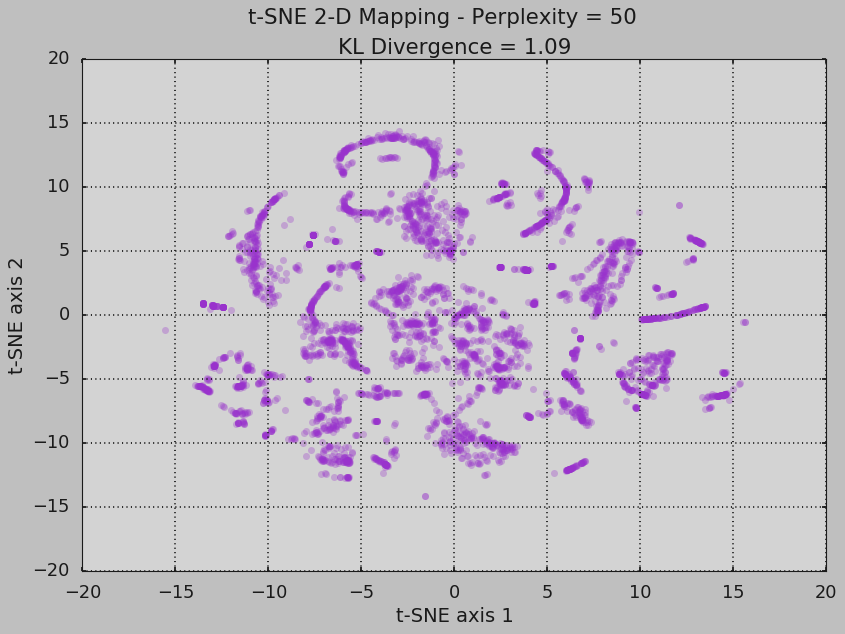

C:/Users/Preeti/Github/CapstoneProject/unsupervised/perplex/t_sne_mapping_perplex_log_50.csv


In [144]:
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... t-sne for loop - evaluate range of perplexity values
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

for perplex in [50] :

    i_index = i_index + 1
    tic = time.clock()

    tsne = TSNE(n_components = 2, verbose = 1, perplexity = perplex, n_iter = 300)

    tsne_results = tsne.fit_transform(X1)
    tsne_kl_diverge = tsne.kl_divergence_

    toc = time.clock()
    print (toc - tic)
    
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - save statistics for model comparison
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

    exe_time = '{0:.4f}'.format(toc-tic)
    
    raw_data = {
    'model_name' : 't-SNE - 2D',
    'perplexity' : perplex,
    'kl_divergence': tsne_kl_diverge,
    'process_time' : exe_time
    }

    df_tbl = pd.DataFrame(raw_data,
                            columns = ['model_name',
                                       'perplexity',
                                       'kl_divergence',
                                       'process_time'],
                            index = [i_index])
    
    tsne_tbl = tsne_tbl.append(df_tbl)

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - plot clusters
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

    _ = plt.figure(figsize = (12, 8))
    _ = plt.subplot(111, facecolor = 'lightgrey')
    
    _ = plt.scatter(tsne_results[:, 0], tsne_results[:, 1],
                 s = 40,
                 c = 'darkorchid', 
                 linewidths = 0,
                 alpha = 0.30)
    
    _ = plt.xlabel('t-SNE axis 1')
    _ = plt.ylabel('t-SNE axis 2')
        
    _ = plt.suptitle("t-SNE 2-D Mapping - Perplexity = %d" %perplex)
    _ = plt.title("KL Divergence = %.2f" %tsne_kl_diverge)
    _ = plt.grid(True)
    
    data_dir = 'C:/Users/Preeti/Github/CapstoneProject/unsupervised/perplex/'
    data_file_base = "t_sne_mapping_perplex_log_"
    data_file_num = str(perplex)
    data_file_ext = ".png"
    plt_file_2_save = data_dir + data_file_base + data_file_num +  data_file_ext
    
    plt.savefig(plt_file_2_save)

    plt.show();
    
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=
# ... store in ../data/ directory
# ... write as .csv file for future recall
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=

    df_out['x-tsne'] = tsne_results[:,0];
    df_out['y-tsne'] = tsne_results[:,1];

    data_dir = 'C:/Users/Preeti/Github/CapstoneProject/unsupervised/perplex/'
    data_file_base = "t_sne_mapping_perplex_log_"
    data_file_num =str(perplex)
    data_file_ext = ".csv"
    file_2_write = data_dir + data_file_base + data_file_num +  data_file_ext
    
    print(file_2_write)

    df_out.to_csv(file_2_write, index = True)
    
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=
# ... end of for loop on t-sne perplex
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=

In [145]:
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... read in t-SNE vectors
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
#for perplex in [20,50,100,200, 300,400] :
df_tsne = pd.read_csv('C:/Users/Preeti/Github/CapstoneProject/unsupervised/perplex/t_sne_mapping_perplex_log_50.csv')
df_tsne.head()

,sample_index,x-tsne,y-tsne
0,1,2.594388,-5.441451
1,2,-4.255144,1.367073
2,3,-4.305577,-11.240384
3,4,-8.112213,-9.972811
4,5,9.348014,3.819240


In [146]:
df_tsne.shape

(4196, 3)

In [147]:
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... join t-sne vectors with base data, since we sampled to create
# ...     the t-sne mapping
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

df_join = df_tsne.set_index('sample_index').join(df.set_index('slno'))
df_join.fillna('0',inplace=True)
df_join.head(20)

,x-tsne,y-tsne,cell_id,min_walk_score,max_walk_score,mean_walk_score,med_sale_pbo_n,log_sum_cost_pedestrian_events,log_num_near_misses,log_n_rqst,...,log_others,log_police.property,log_service.complaint,log_street_sidewalk,log_traffic_sig0l,log_trash,log_trees_plants,log_water.leak,log_zoning_parking,log_n_request
sample_index,,,,,,,,,,,,,,,,,,,,,
1,2.594388,-5.441451,20012,44,48,46.000000,0,-4.605170,-4.60517,-4.605170,...,4.330865,1.947338,0.009950,3.663818,0.00995,5.645482,1.611436,-4.605170,1.611436,6.059147
2,-4.255144,1.367073,20013,44,48,46.000000,0,-4.605170,-4.60517,-4.605170,...,-4.605170,-4.605170,0.009950,1.101940,-4.60517,3.178470,0.009950,-4.605170,-4.605170,3.367641
3,-4.305577,-11.240384,20015,44,48,46.000000,0,-1.158362,-4.60517,-4.605170,...,0.698135,-4.605170,-4.605170,-4.605170,0.00995,-4.605170,-4.605170,-4.605170,-4.605170,1.101940
4,-8.112213,-9.972811,20016,44,48,46.000000,0,-4.605170,-4.60517,-4.605170,...,-4.605170,-4.605170,-4.605170,0.009950,-4.60517,-4.605170,-4.605170,-4.605170,-4.605170,1.101940
5,9.348014,3.819240,20019,13,13,13.000000,0,-4.605170,-4.60517,-4.605170,...,-4.605170,-4.605170,1.388791,0.009950,-4.60517,3.713816,0.009950,-4.605170,-4.605170,3.850360
6,6.885890,-8.316484,20020,44,48,46.000000,0,-4.605170,-4.60517,0.009950,...,2.398804,-4.605170,-4.605170,1.611436,-4.60517,3.806885,-4.605170,-4.605170,0.009950,4.143293
7,-0.895608,-0.920208,20021,44,48,46.000000,0,-4.605170,-4.60517,-4.605170,...,2.708717,-4.605170,0.698135,0.698135,-4.60517,4.382152,-4.605170,-4.605170,0.009950,4.625071
8,7.153776,-8.236163,20022,44,48,46.000000,0,-4.605170,-4.60517,-4.605170,...,1.388791,0.698135,0.009950,1.101940,-4.60517,4.304200,1.611436,-4.605170,-4.605170,4.510969
9,5.894754,1.703255,30012,3,36,24.333333,0,-0.481267,-4.60517,0.009950,...,3.828859,1.388791,0.009950,2.773214,-4.60517,5.283254,0.698135,-4.605170,-4.605170,5.613165


In [148]:
col_names = df_join.columns.values.tolist()
col_names
df_join.describe().T


['x-tsne',
 'y-tsne',
 'cell_id',
 'min_walk_score',
 'max_walk_score',
 'mean_walk_score',
 'med_sale_pbo_n',
 'log_sum_cost_pedestrian_events',
 'log_num_near_misses',
 'log_n_rqst',
 'log_access',
 'log_dblprk',
 'log_dnotyld',
 'log_jywalk',
 'log_lvisib',
 'log_lwfws',
 'log_nobikef',
 'log_noswlk',
 'log_other',
 'log_prkint',
 'log_prkswlk',
 'log_speed',
 'log_vrrlss',
 'log_wlksig',
 'log_xwalk',
 'log_assist',
 'log_bikes',
 'log_drives',
 'log_other.1',
 'log_walks',
 'log_num_walk_scores',
 'log_sum_lane_cnt',
 'log_sum_width',
 'log_sum_area',
 'log_num_streets',
 'log_num_fire_incd',
 'log_med_sale_res_y',
 'log_med_sale_res_n',
 'log_med_sale_com_y',
 'log_med_sale_com_n',
 'log_med_sale_ind_y',
 'log_med_sale_ind_n',
 'log_med_sale_pbo_y',
 'log_sum_cost.y',
 'log_num_events.y',
 'log_dist',
 'log_n_object',
 'log_animals_insects',
 'log_building.related',
 'log_construction',
 'log_food',
 'log_others',
 'log_police.property',
 'log_service.complaint',
 'log_street_sid

,count,mean,std,min,25%,50%,75%,max
x-tsne,4196.0,-0.275841,7.094613,-15.535106,-5.864928,-0.928157,5.213278,1.559963e+01
y-tsne,4196.0,0.061582,6.777441,-14.116663,-5.407782,-0.229959,5.614368,1.437227e+01
cell_id,4196.0,614442.901096,314659.719648,20012.000000,320031.750000,640054.500000,850063.250000,1.520036e+06
min_walk_score,4196.0,43.963060,14.405893,0.000000,44.000000,44.000000,44.000000,9.900000e+01
max_walk_score,4196.0,48.044566,14.186857,0.000000,48.000000,48.000000,48.000000,9.900000e+01
mean_walk_score,4196.0,46.069656,13.934155,0.000000,46.000000,46.000000,46.000000,9.900000e+01
med_sale_pbo_n,4196.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00
log_sum_cost_pedestrian_events,4196.0,-3.551273,2.014489,-4.605170,-4.605170,-4.605170,-4.605170,3.347480e+00
log_num_near_misses,4196.0,-4.537753,0.567189,-4.605170,-4.605170,-4.605170,-4.605170,2.398804e+00
log_n_rqst,4196.0,-3.854621,1.957011,-4.605170,-4.605170,-4.605170,-4.605170,4.406841e+00


In [149]:
# set required variables for model comparison

kmeans_tbl = pd.DataFrame(columns = [
    'model_name',
    'n_clusters',
    'inertia',
    'silhouette',
    'process_time'])

i_index = []
i_index = 0

# preparation for cross validation and model comparison, each classifier is appended once model is fit

models = []

n_lda =  2


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=2, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  253283.61048715102
silhouette =  0.34777243867559143
0 -5.80266156269141 1.1330886571400058 0
1 5.981149420285675 -1.151486453155773 1


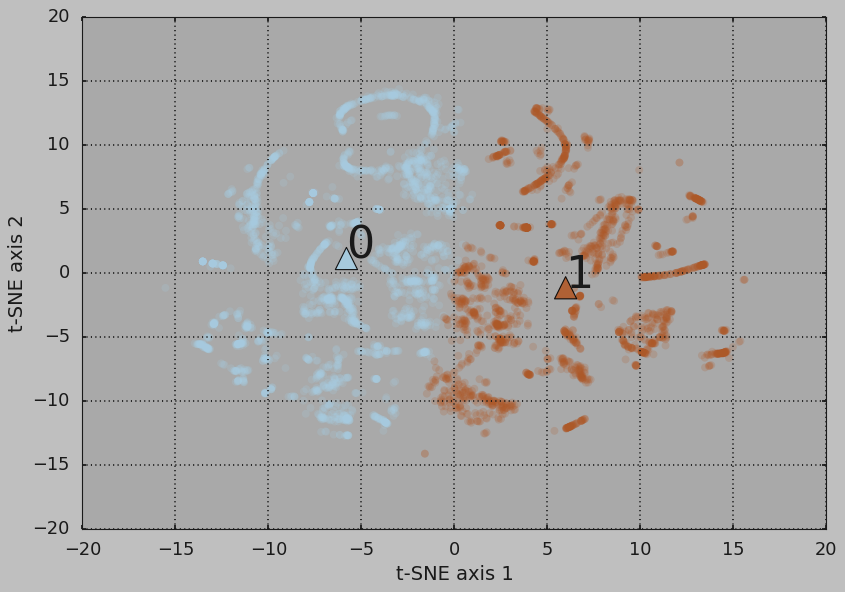

n_lda =  3


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=3, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  152987.6987336686
silhouette =  0.3878970874077703
0 -6.2436480854750975 -4.8265303848714805 0
1 -2.2665059970346335 7.7657420068764615 1
2 6.887031833433525 -2.3565195314939986 2


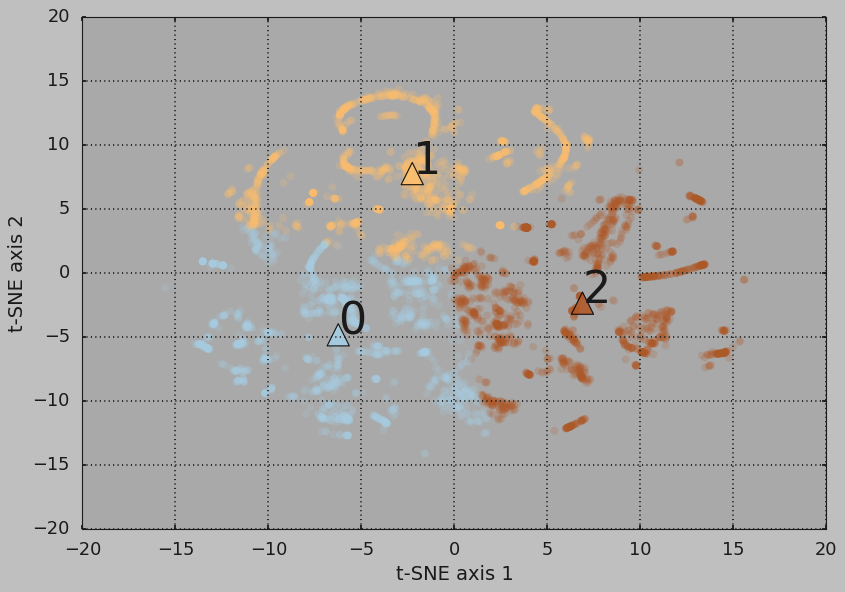

n_lda =  4


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=4, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  116474.25221982281
silhouette =  0.3787965819173318
0 -4.472148369213005 7.157849621523677 0
1 7.320464713257006 4.881157964998838 1
2 4.956781756232467 -5.683895351968769 2
3 -7.089682716479531 -4.629023524639689 3


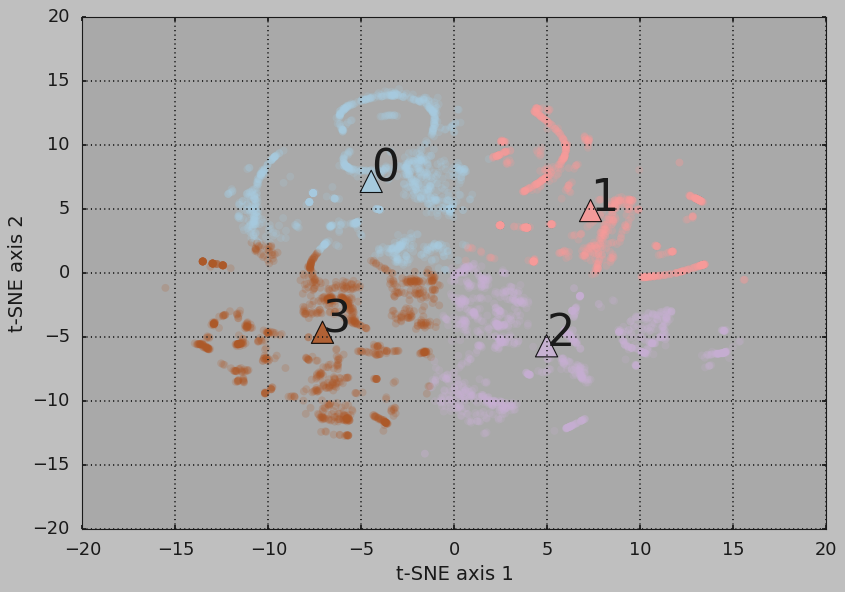

n_lda =  5


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=5, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  93625.35079253287
silhouette =  0.36991114990524115
0 10.058240617869368 -0.3878241275132312 0
1 -7.8151539917364135 -6.6209869615695105 1
2 -7.528285592718544 3.305926419801988 2
3 1.7752636345973183 -5.345318079212145 3
4 0.3129109425658827 8.926834670945102 4


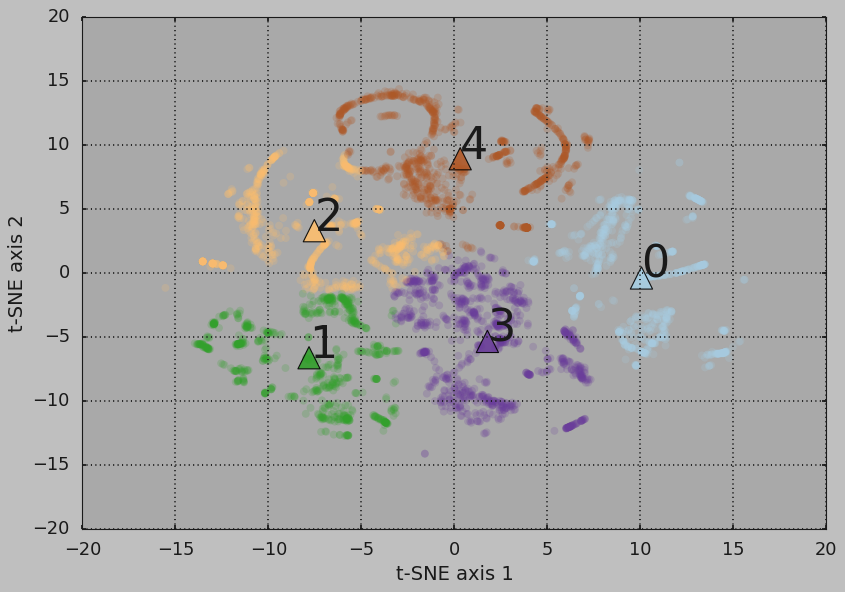

n_lda =  6


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=6, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  78313.27359145445
silhouette =  0.4001543978523326
0 -8.991472591358779 4.205365424356758 0
1 10.221544019757994 -0.4247933549651627 1
2 -0.013776722171472244 -0.3308395534494366 2
3 0.041973985559665694 9.498556918420372 3
4 2.9245863261311635 -8.014143607144891 4
5 -7.7685576987178155 -6.354356752988476 5


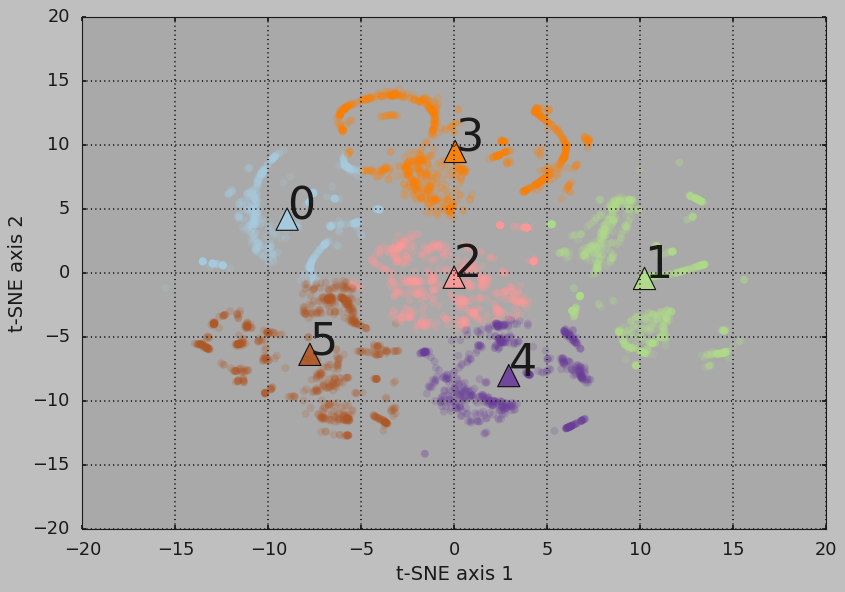

n_lda =  7


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=7, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  66715.57434806121
silhouette =  0.4152717090769628
0 -1.4455243749382027 9.76814159750318 0
1 -0.5988955916455571 -0.8718746895332397 1
2 11.01574167520564 -3.099202180660955 2
3 6.950170721253539 5.148493075263132 3
4 2.9245863261311635 -8.014143607144891 4
5 -7.7685576987178155 -6.354356752988476 5
6 -9.032303814907209 4.158114259223437 6


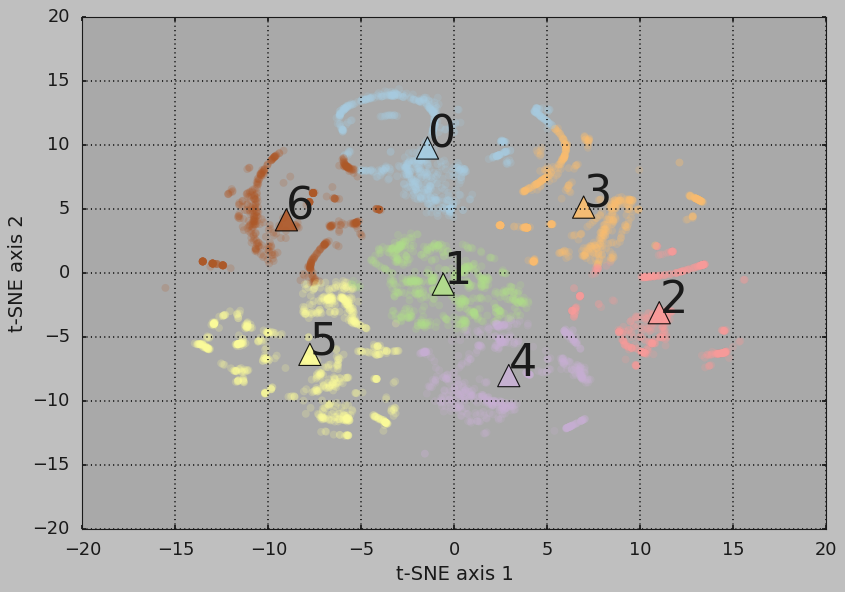

n_lda =  8


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=8, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  57984.56064972069
silhouette =  0.46324615460785296
0 9.511620797185937 2.5777988651538997 0
1 4.440860580267636 8.101071279108835 1
2 -0.5988955916455571 -0.8718746895332397 2
3 -7.7685576987178155 -6.354356752988476 3
4 10.868047759622602 -4.781339672205273 4
5 -9.032303814907209 4.158114259223437 5
6 2.9245863261311635 -8.014143607144891 6
7 -2.3538322487989873 9.590103376678083 7


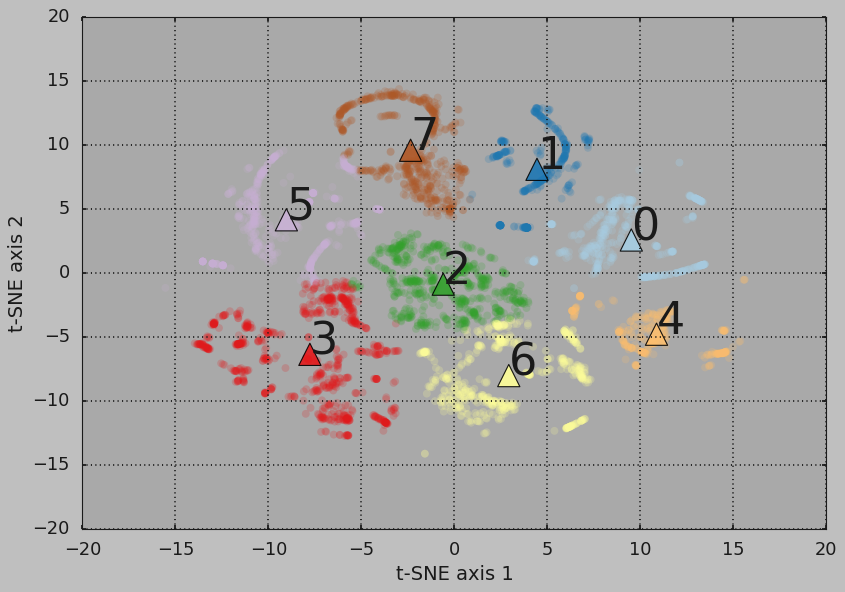

n_lda =  9


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=9, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  50466.99006661677
silhouette =  0.49458267065461564
0 4.440860580267636 8.101071279108835 0
1 -5.83358707147749 -9.548720380341994 1
2 -9.032303814907209 4.158114259223437 2
3 -0.5988955916455571 -0.8718746895332397 3
4 10.868047759622602 -4.781339672205273 4
5 -2.3538322487989873 9.590103376678083 5
6 -9.126943553179283 -4.1010167340848875 6
7 9.511620797185937 2.5777988651538997 7
8 2.940555876242997 -7.99254444006288 8


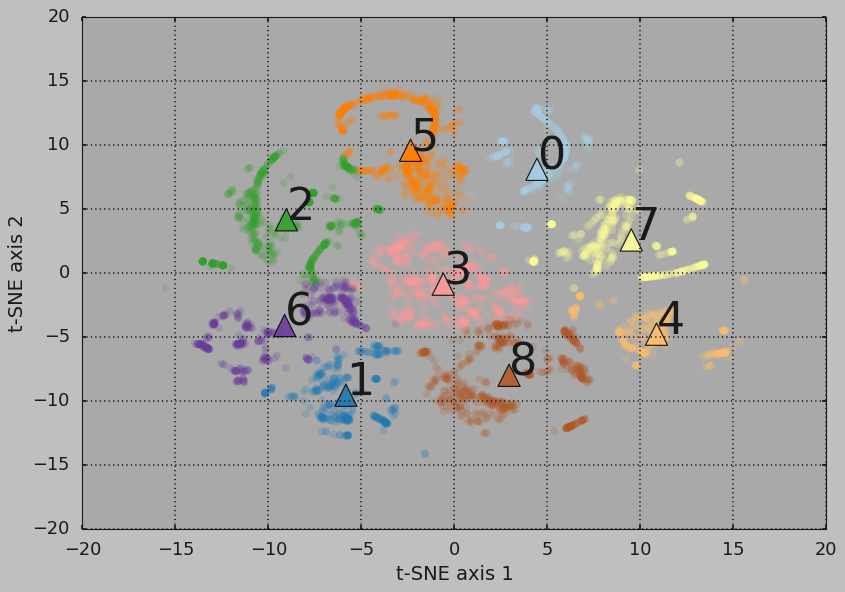

n_lda =  10


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=10, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  46272.15944397889
silhouette =  0.5578719972223593
0 4.440860580267636 8.101071279108835 0
1 -6.352166334922161 -2.462682485774452 1
2 10.868047759622602 -4.781339672205273 2
3 -9.032303814907209 4.158114259223437 3
4 9.511620797185937 2.5777988651538997 4
5 -2.3538322487989873 9.590103376678083 5
6 2.940555876242997 -7.99254444006288 6
7 -5.83358707147749 -9.548720380341994 7
8 -0.5988955916455571 -0.8718746895332397 8
9 -11.61025257624132 -5.567257048749263 9


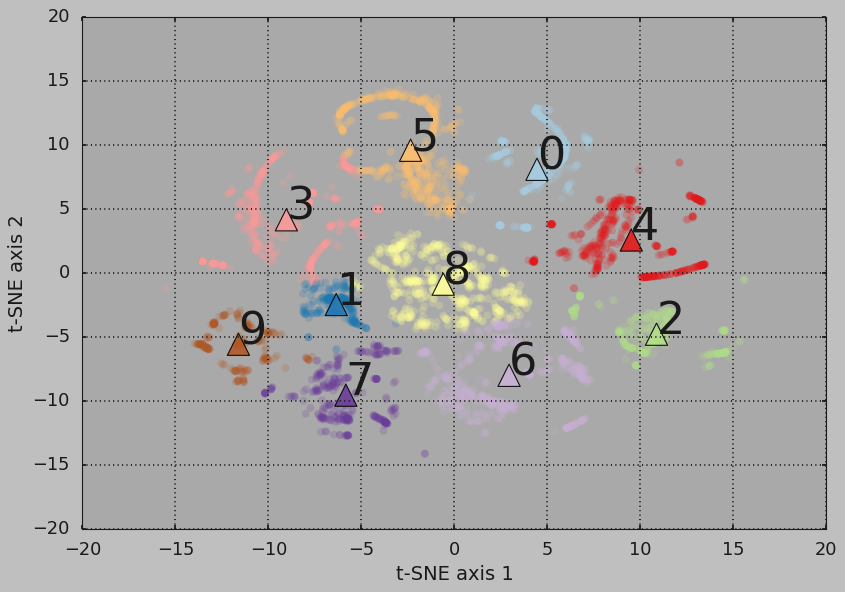

n_lda =  11


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=11, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  41818.665930255775
silhouette =  0.5892153480840336
0 -3.280009625695941 12.664396739276096 0
1 -0.5988955916455571 -0.8718746895332397 1
2 9.511620797185937 2.5777988651538997 2
3 2.940555876242997 -7.99254444006288 3
4 -9.032303814907209 4.158114259223437 4
5 4.440860580267636 8.101071279108835 5
6 -6.352166334922161 -2.462682485774452 6
7 -11.61025257624132 -5.567257048749263 7
8 -5.83358707147749 -9.548720380341994 8
9 -1.6469367430676674 7.243680093698296 9
10 10.868047759622602 -4.781339672205273 10


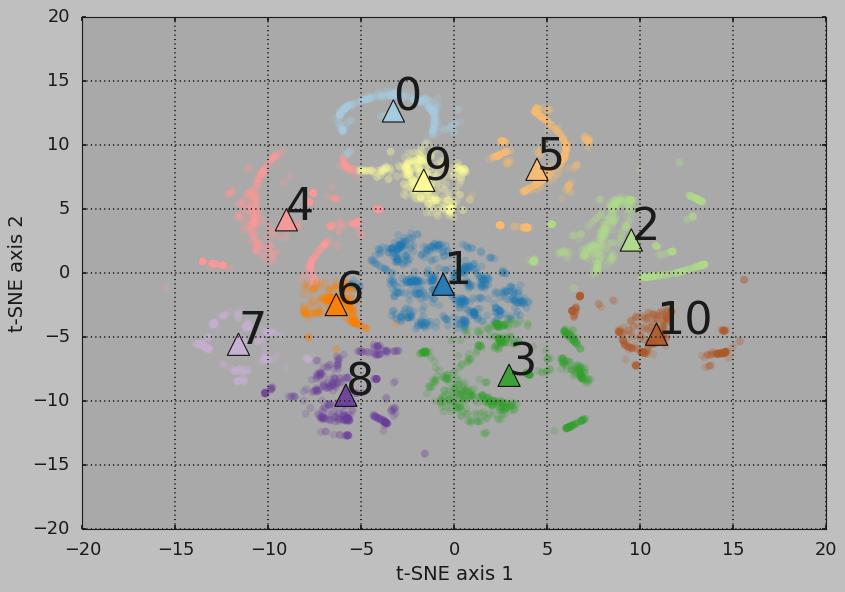

In [150]:
# ... k-means on the t-sne vectors

X_tsne = pd.DataFrame(columns=['t1', 't2'])
X_tsne['t1'] = df_join['x-tsne']
X_tsne['t2'] = df_join['y-tsne']

for n_lda in range(2,12):  
#n_lda = 3
    tic = time.clock()

    print ("n_lda = ", n_lda)

    cls_lda = KMeans(n_clusters = n_lda,
                     init = 'k-means++',
                     random_state = 1);

    cls_lda.fit(X_tsne)

    kmeans_labels = cls_lda.labels_ # the labels from kmeans clustering
    kmeans_centers = cls_lda.cluster_centers_

    kmeans_inertia = cls_lda.inertia_
    print ("inertia = ", kmeans_inertia)

    kmeans_silhouette = 0
    kmeans_silhouette = metrics.silhouette_score(X_tsne,
                                                 kmeans_labels,
                                                 metric = 'euclidean')
    print ("silhouette = ", kmeans_silhouette)
    column_name = "kmeans_" + str(n_lda)
    df_join[column_name] = kmeans_labels

    toc =  time.clock()
    # ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
    # ... - save statistics for model comparison
    # ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

    exe_time = '{0:.4f}'.format(toc-tic)

    raw_data = {
    'model_name' : 'KMeans - LDA features',
    'n_clusters' : n_lda,
    'inertia': kmeans_inertia,
    'silhouette': kmeans_silhouette, 
    'process_time' : exe_time
    }

    df_tbl = pd.DataFrame(raw_data,
    columns = ['model_name', 'n_clusters', 'inertia', 'silhouette', 'process_time'],
    index = [i_index + 1])

    kmeans_tbl = kmeans_tbl.append(df_tbl, ignore_index=True)
    column_name = "kmeans_" + str(n_lda)
    X_tsne[column_name] = kmeans_labels
    # ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
    # ... - make some plots of clusters
    # ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

    _ = plt.figure(figsize=(12, 8));
    _ = plt.subplot(111, facecolor = 'darkgrey');

    X_tsne_values = X_tsne.values;
    _ = plt.scatter(X_tsne_values[:, 0], X_tsne_values[:, 1],
                c = kmeans_labels,
                cmap = plt.cm.Paired,
                s = 50,
                linewidths = 0,
                alpha = 0.20);
    _ = plt.scatter(kmeans_centers[:, 0], kmeans_centers[:, 1],
                c = range(n_lda),
                cmap = plt.cm.Paired,
                s = 400,
                linewidths = 1.0,
                marker = '^',
                edgecolors = 'black',
                alpha = 0.90);

    for ii in range(n_lda) :                                       
        _ = plt.text(kmeans_centers[ii, 0], kmeans_centers[ii, 1], ii, fontsize = 40)
        print(ii, kmeans_centers[ii, 0], kmeans_centers[ii, 1], ii)

    _ = plt.xlabel('t-SNE axis 1')
    _ = plt.ylabel('t-SNE axis 2');
    _ = plt.grid(True);

    plt.show();

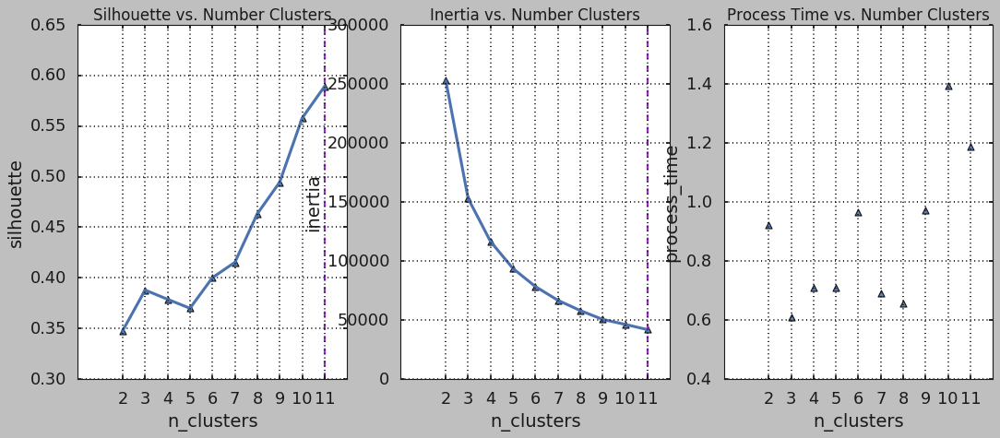

In [151]:

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ...  use max silhouette score to mark optimal c=number of clusters
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

n_optimal_clusters = kmeans_tbl['silhouette'].argmax() + kmeans_tbl['n_clusters'].min()

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - plot metrics across models for comparison
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

plt.figure(figsize=(16, 6));

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... silhouette values
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

plt.subplot(131);
plt.scatter(kmeans_tbl['n_clusters'],
            kmeans_tbl['silhouette'],
            s = 40,
            linewidths = 1.0,
            marker = '^',
            edgecolors = 'black',
            alpha = 0.90);

plt.plot(kmeans_tbl['n_clusters'],
         kmeans_tbl['silhouette'])

plt.xlabel('n_clusters'), plt.ylabel('silhouette');
plt.title('Silhouette vs. Number Clusters', fontsize = 15)
plt.grid();

# ... vertical line for at max silhouette value

plt.axvline(x = n_optimal_clusters, linewidth = 2, linestyle = 'dashed', color = 'darkorchid')

xint = range(min(kmeans_tbl['n_clusters']), math.ceil(max(kmeans_tbl['n_clusters']))+1)
plt.xticks(xint)

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... inertia values
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

plt.subplot(132);
plt.scatter(kmeans_tbl['n_clusters'],
            kmeans_tbl['inertia'],
            s = 40,
            linewidths = 1.0,
            marker = '^',
            edgecolors = 'black',
            alpha = 0.90);

plt.plot(kmeans_tbl['n_clusters'],
         kmeans_tbl['inertia'])

plt.xlabel('n_clusters'), plt.ylabel('inertia');
plt.title('Inertia vs. Number Clusters', fontsize = 15)
plt.grid();

# ... vertical line for at max silhouette value

plt.axvline(x = n_optimal_clusters, linewidth = 2, linestyle = 'dashed', color = 'darkorchid')

xint = range(min(kmeans_tbl['n_clusters']), math.ceil(max(kmeans_tbl['n_clusters']))+1)
plt.xticks(xint)

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... process time
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

plt.subplot(133);
plt.scatter(kmeans_tbl['n_clusters'],
            kmeans_tbl['process_time'],
            s = 40,
            linewidths = 1.0,
            marker = '^',
            edgecolors = 'black',
            alpha = 0.90);
plt.xlabel('n_clusters'), plt.ylabel('process_time');
plt.title('Process Time vs. Number Clusters', fontsize = 15)
plt.grid();
xint = range(min(kmeans_tbl['n_clusters']), math.ceil(max(kmeans_tbl['n_clusters']))+1)
plt.xticks(xint)

plt.savefig("cluster_kmeans_number_of_clusters_eval.png")
    
plt.show();

In [152]:
## optimal clusters = 3
n_lda = 3

In [153]:
df_join.head()

,x-tsne,y-tsne,cell_id,min_walk_score,max_walk_score,mean_walk_score,med_sale_pbo_n,log_sum_cost_pedestrian_events,log_num_near_misses,log_n_rqst,...,kmeans_2,kmeans_3,kmeans_4,kmeans_5,kmeans_6,kmeans_7,kmeans_8,kmeans_9,kmeans_10,kmeans_11
sample_index,,,,,,,,,,,,,,,,,,,,,
1,2.594388,-5.441451,20012,44,48,46.0,0,-4.605170,-4.60517,-4.60517,...,1,2,2,3,4,4,6,8,6,3
2,-4.255144,1.367073,20013,44,48,46.0,0,-4.605170,-4.60517,-4.60517,...,0,0,0,2,2,1,2,3,8,1
3,-4.305577,-11.240384,20015,44,48,46.0,0,-1.158362,-4.60517,-4.60517,...,0,0,3,1,5,5,3,1,7,8
4,-8.112213,-9.972811,20016,44,48,46.0,0,-4.605170,-4.60517,-4.60517,...,0,0,3,1,5,5,3,1,7,8
5,9.348014,3.819240,20019,13,13,13.0,0,-4.605170,-4.60517,-4.60517,...,1,2,1,0,1,3,0,7,4,2


In [154]:
X_all_together = copy.deepcopy(df_join)
len(X_all_together)
X_all_together['kmeans_labels'] = df_join['kmeans_3']

4196

In [155]:
X_all_together.fillna('0',inplace=True)
X_all_together.isnull().sum()

x-tsne                            0
y-tsne                            0
cell_id                           0
min_walk_score                    0
max_walk_score                    0
mean_walk_score                   0
med_sale_pbo_n                    0
log_sum_cost_pedestrian_events    0
log_num_near_misses               0
log_n_rqst                        0
log_access                        0
log_dblprk                        0
log_dnotyld                       0
log_jywalk                        0
log_lvisib                        0
log_lwfws                         0
log_nobikef                       0
log_noswlk                        0
log_other                         0
log_prkint                        0
log_prkswlk                       0
log_speed                         0
log_vrrlss                        0
log_wlksig                        0
log_xwalk                         0
log_assist                        0
log_bikes                         0
log_drives                  

In [156]:
col_names = X_all_together.columns.values.tolist()

In [157]:
col_names

['x-tsne',
 'y-tsne',
 'cell_id',
 'min_walk_score',
 'max_walk_score',
 'mean_walk_score',
 'med_sale_pbo_n',
 'log_sum_cost_pedestrian_events',
 'log_num_near_misses',
 'log_n_rqst',
 'log_access',
 'log_dblprk',
 'log_dnotyld',
 'log_jywalk',
 'log_lvisib',
 'log_lwfws',
 'log_nobikef',
 'log_noswlk',
 'log_other',
 'log_prkint',
 'log_prkswlk',
 'log_speed',
 'log_vrrlss',
 'log_wlksig',
 'log_xwalk',
 'log_assist',
 'log_bikes',
 'log_drives',
 'log_other.1',
 'log_walks',
 'log_num_walk_scores',
 'log_sum_lane_cnt',
 'log_sum_width',
 'log_sum_area',
 'log_num_streets',
 'log_num_fire_incd',
 'log_med_sale_res_y',
 'log_med_sale_res_n',
 'log_med_sale_com_y',
 'log_med_sale_com_n',
 'log_med_sale_ind_y',
 'log_med_sale_ind_n',
 'log_med_sale_pbo_y',
 'log_sum_cost.y',
 'log_num_events.y',
 'log_dist',
 'log_n_object',
 'log_animals_insects',
 'log_building.related',
 'log_construction',
 'log_food',
 'log_others',
 'log_police.property',
 'log_service.complaint',
 'log_street_sid

## Remove columns for which plot is not needed

In [160]:
col_to_remove = ['x-tsne',
 'y-tsne',
 'cell_id','kmeans_labels']
                             
for col in col_to_remove:
    col_names.remove(col)

In [161]:
col_names

['min_walk_score',
 'max_walk_score',
 'mean_walk_score',
 'med_sale_pbo_n',
 'log_sum_cost_pedestrian_events',
 'log_num_near_misses',
 'log_n_rqst',
 'log_access',
 'log_dblprk',
 'log_dnotyld',
 'log_jywalk',
 'log_lvisib',
 'log_lwfws',
 'log_nobikef',
 'log_noswlk',
 'log_other',
 'log_prkint',
 'log_prkswlk',
 'log_speed',
 'log_vrrlss',
 'log_wlksig',
 'log_xwalk',
 'log_assist',
 'log_bikes',
 'log_drives',
 'log_other.1',
 'log_walks',
 'log_num_walk_scores',
 'log_sum_lane_cnt',
 'log_sum_width',
 'log_sum_area',
 'log_num_streets',
 'log_num_fire_incd',
 'log_med_sale_res_y',
 'log_med_sale_res_n',
 'log_med_sale_com_y',
 'log_med_sale_com_n',
 'log_med_sale_ind_y',
 'log_med_sale_ind_n',
 'log_med_sale_pbo_y',
 'log_sum_cost.y',
 'log_num_events.y',
 'log_dist',
 'log_n_object',
 'log_animals_insects',
 'log_building.related',
 'log_construction',
 'log_food',
 'log_others',
 'log_police.property',
 'log_service.complaint',
 'log_street_sidewalk',
 'log_traffic_sig0l',
 'lo

In [45]:
for col in col_names:
    X_all_together[col] = X_all_together[col].astype(float).fillna(0.0)

In [162]:
kmeans_weight_tbl = pd.DataFrame(columns = [
    'Column Name',
    'cluster 0',
    'cluster 1',
    'cluster 2'])

i_index = []
i_index = 0

In [163]:
n_lda=3

In [164]:

# ... k-means on the t-sne vectors

X_tsne = pd.DataFrame(columns=['t1', 't2'])
X_tsne['t1'] = df_join['x-tsne']
X_tsne['t2'] = df_join['y-tsne']

print ("n_lda = ", n_lda)

cls_lda = KMeans(n_clusters = n_lda,
                 init = 'k-means++',
                 random_state = 1);

cls_lda.fit(X_tsne)

kmeans_labels = cls_lda.labels_ # the labels from kmeans clustering
kmeans_centers = cls_lda.cluster_centers_

kmeans_inertia = cls_lda.inertia_
print ("inertia = ", kmeans_inertia)

kmeans_silhouette = metrics.silhouette_score(X_tsne,
                                             kmeans_labels,
                                             metric = 'euclidean')
print ("silhouette = ", kmeans_silhouette)
#column_name = "kmeans_" + str(n_lda)
#df_join[column_name] = kmeans_labels


n_lda =  3


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=3, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  152579.12198113598
silhouette =  0.3874733598853567


************************** min_walk_score
****************************************


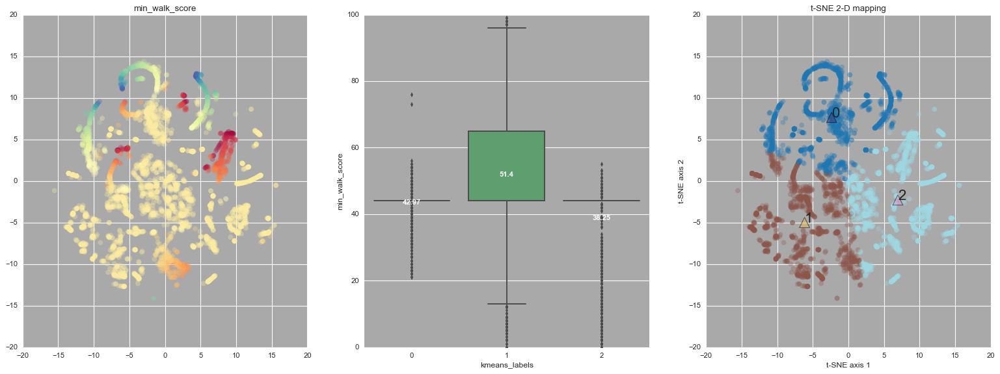

************************** max_walk_score
****************************************


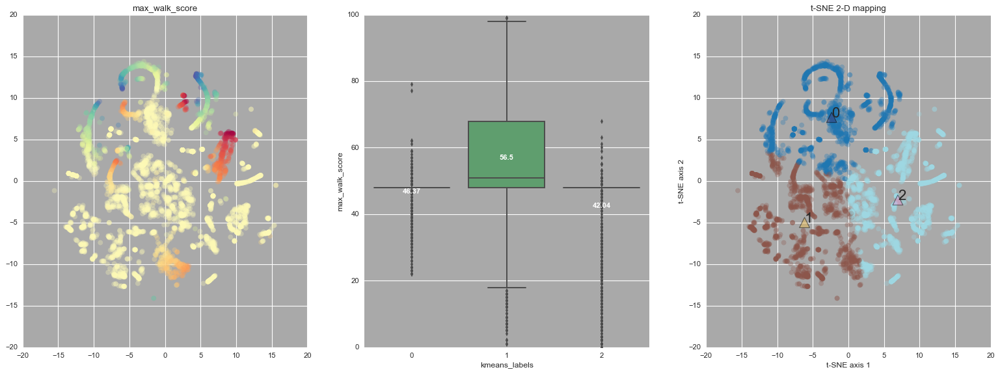

************************** mean_walk_score
****************************************


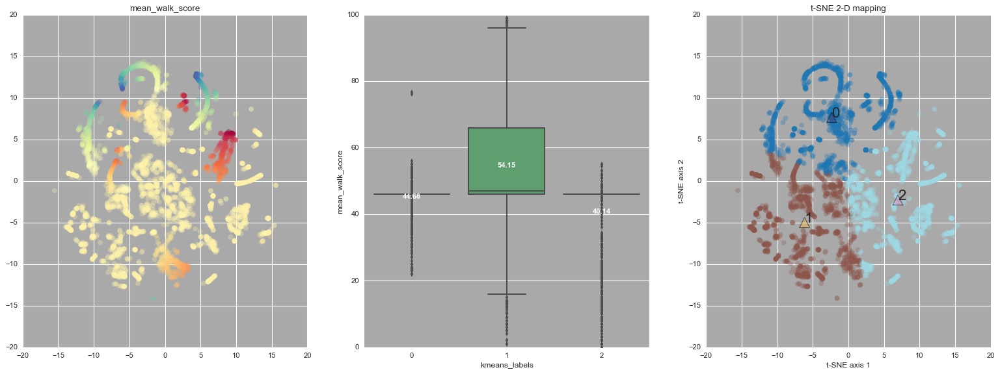

************************** med_sale_pbo_n
****************************************


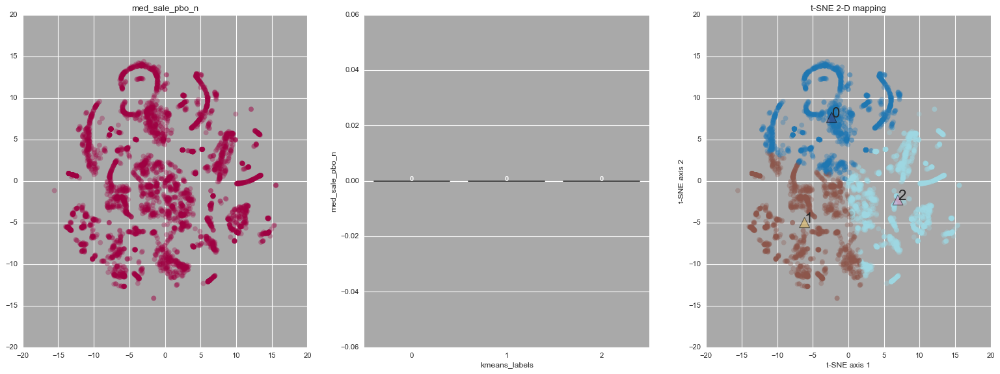

************************** log_sum_cost_pedestrian_events
****************************************


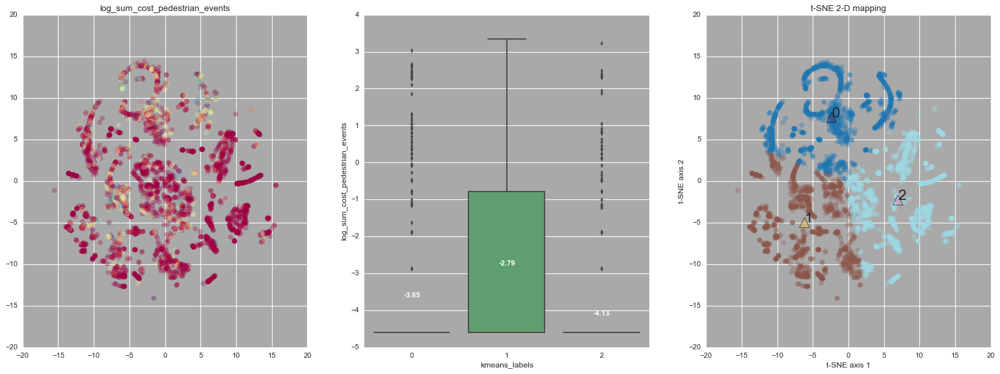

************************** log_num_near_misses
****************************************


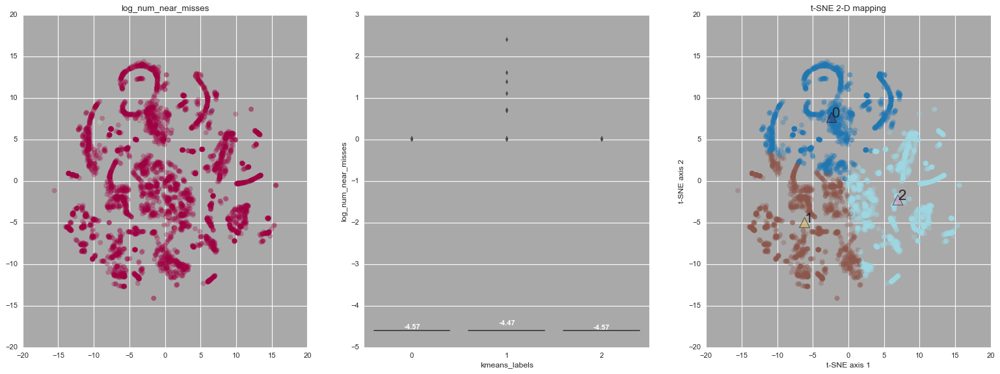

************************** log_n_rqst
****************************************


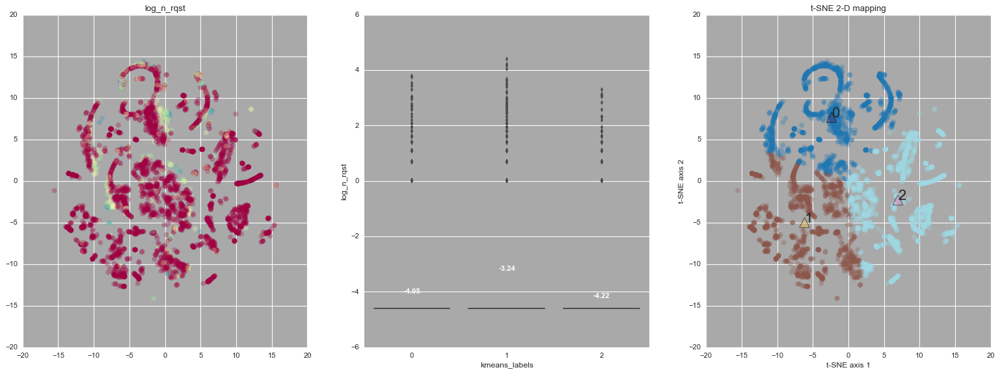

************************** log_access
****************************************


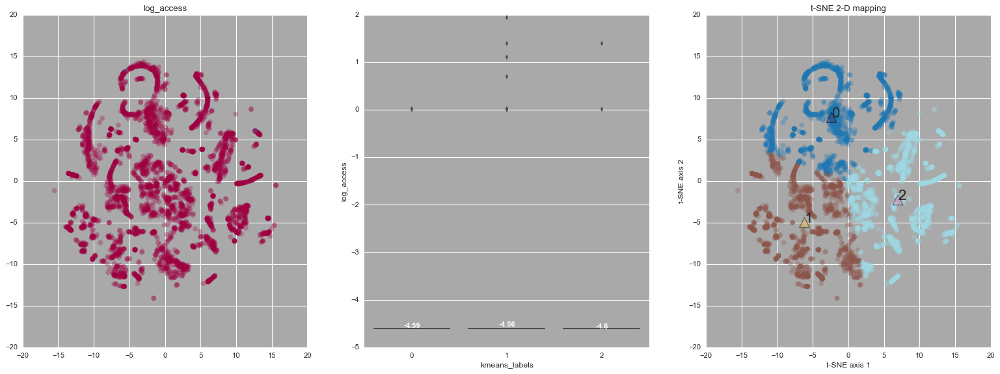

************************** log_dblprk
****************************************


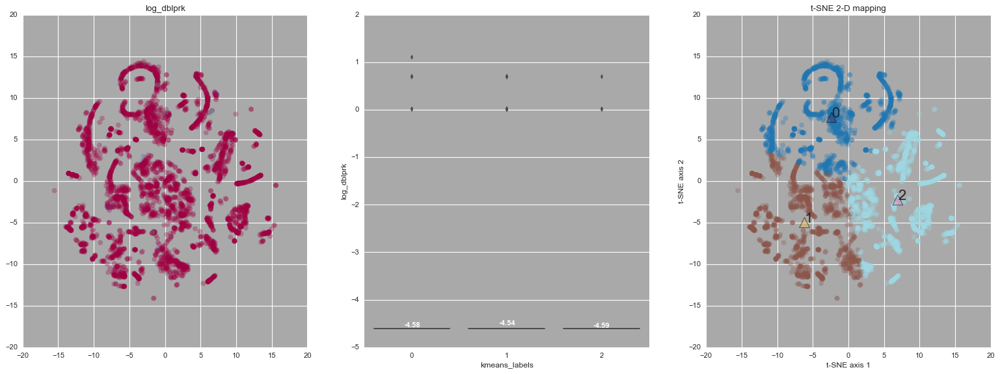

************************** log_dnotyld
****************************************


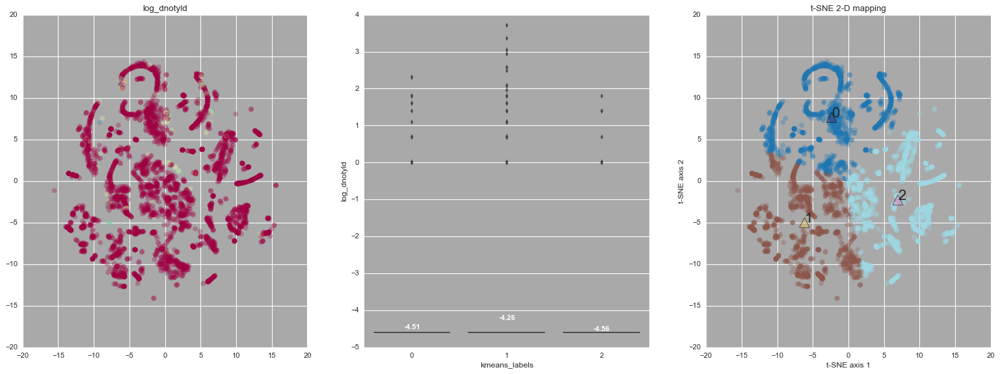

************************** log_jywalk
****************************************


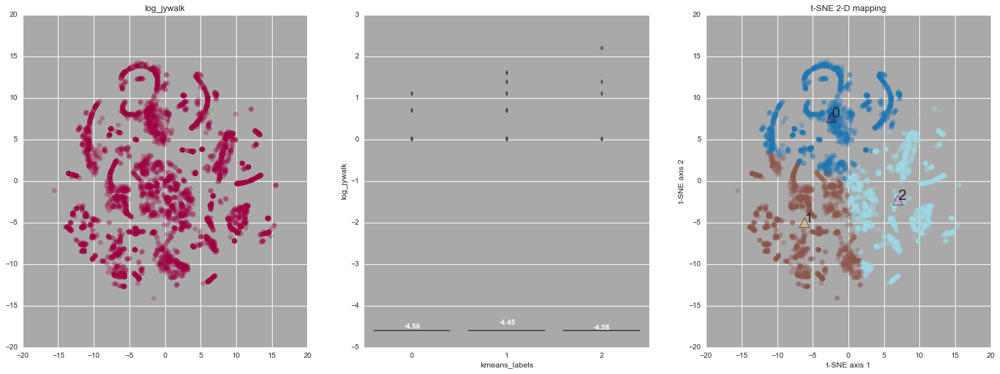

************************** log_lvisib
****************************************


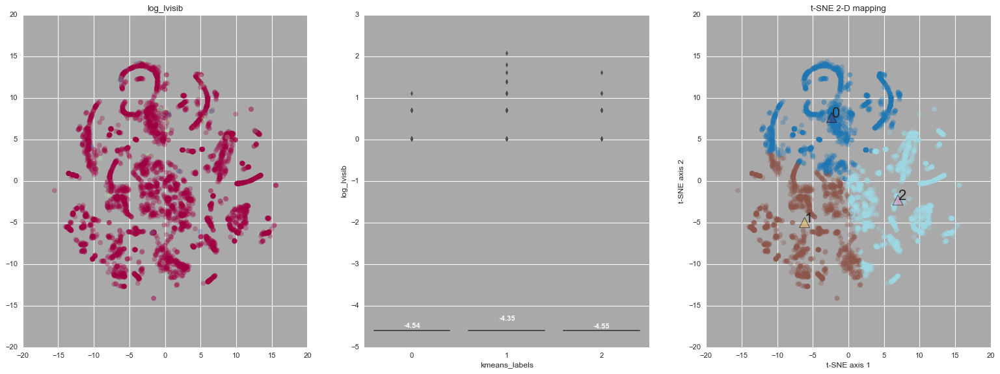

************************** log_lwfws
****************************************


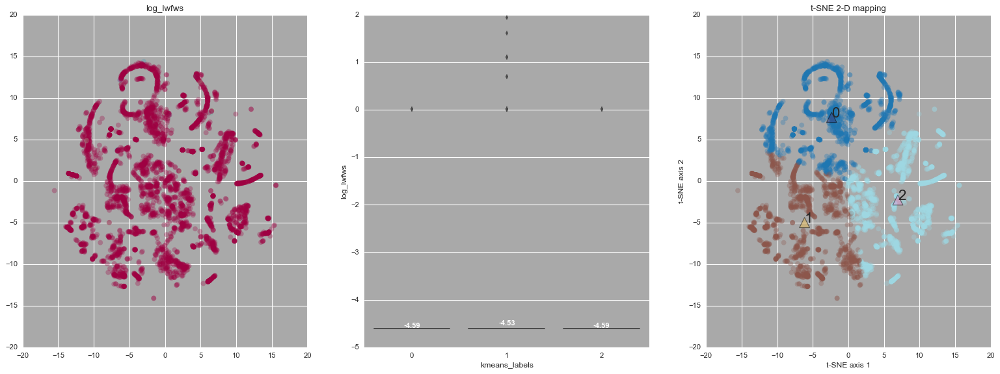

************************** log_nobikef
****************************************


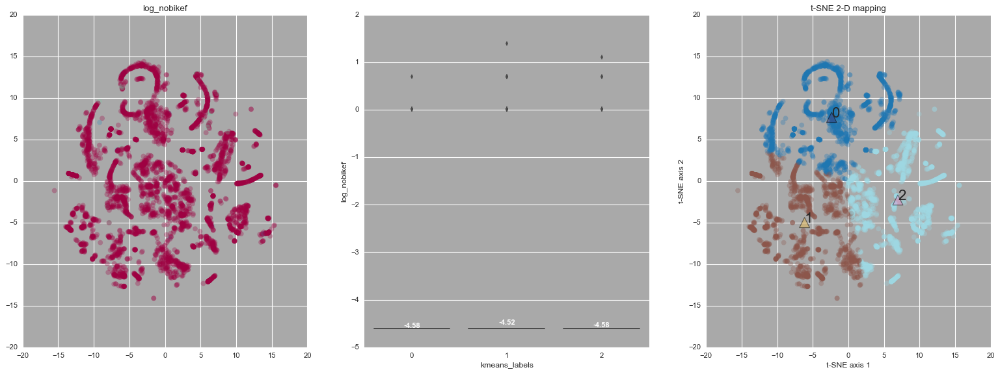

************************** log_noswlk
****************************************


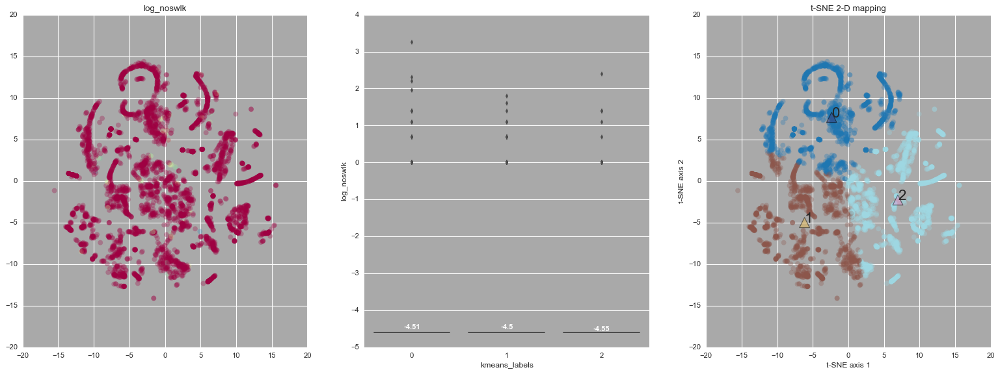

************************** log_other
****************************************


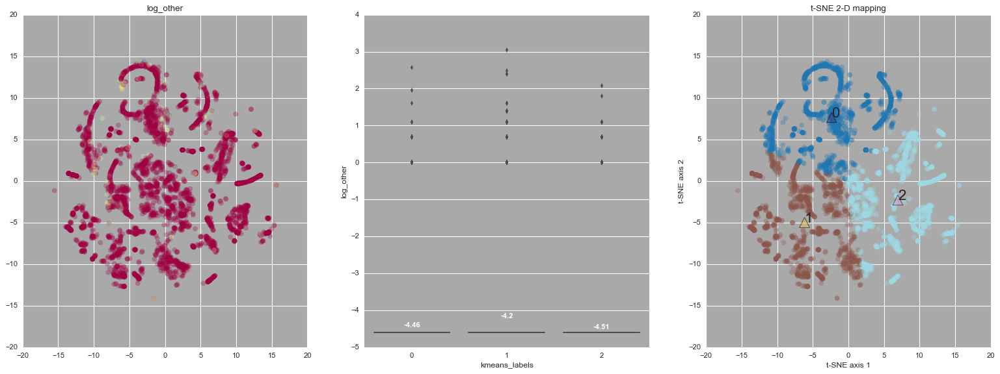

************************** log_prkint
****************************************


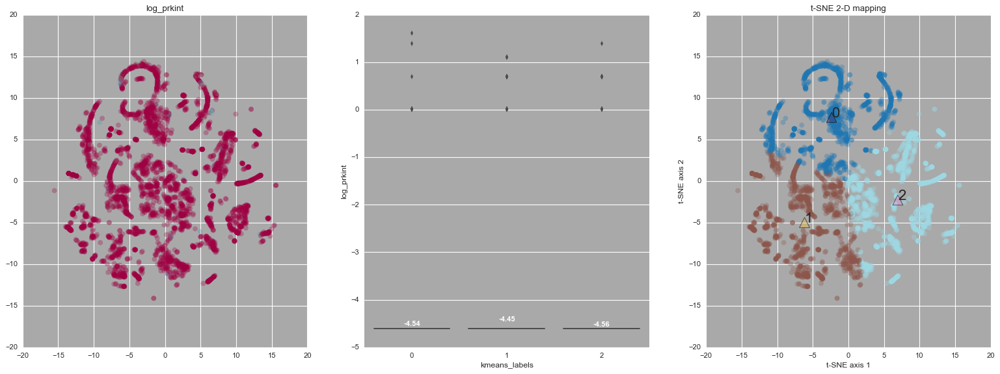

************************** log_prkswlk
****************************************


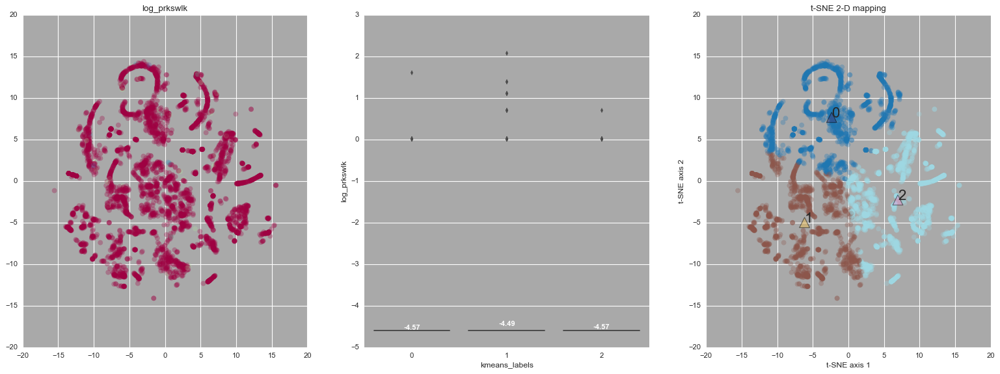

************************** log_speed
****************************************


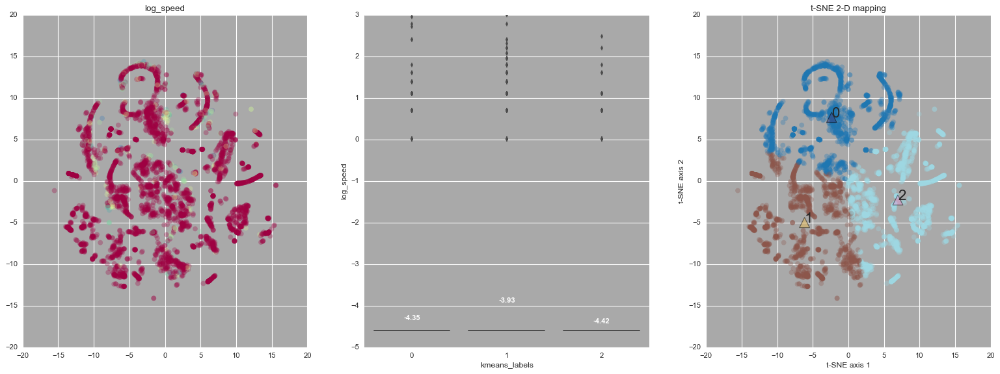

************************** log_vrrlss
****************************************


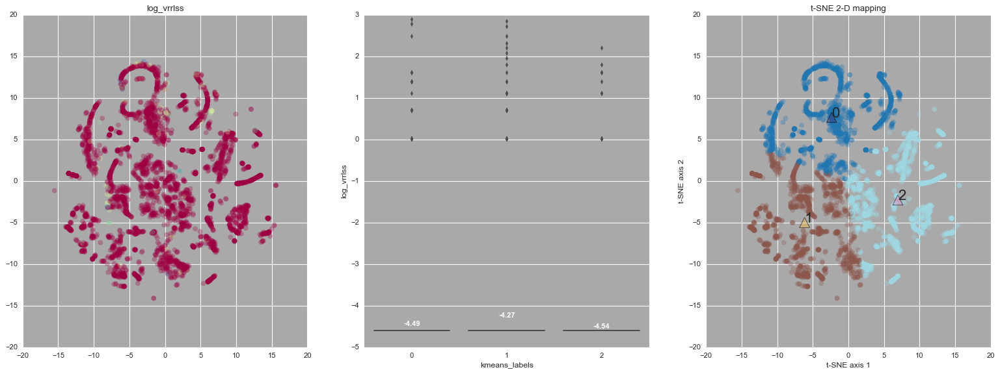

************************** log_wlksig
****************************************


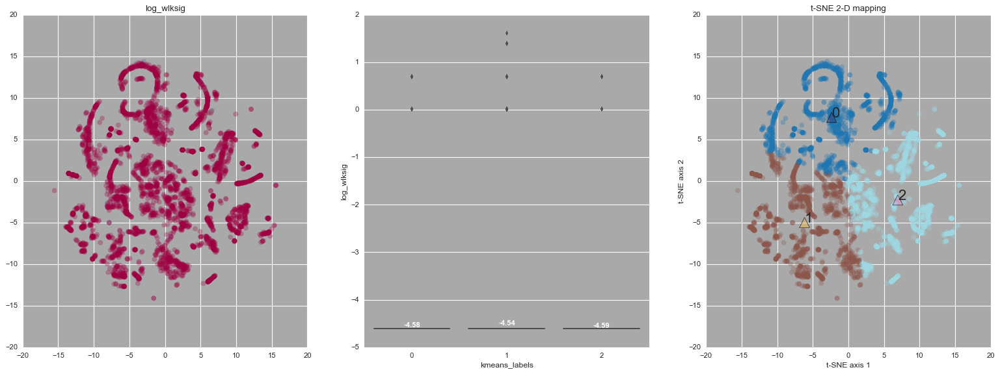

************************** log_xwalk
****************************************


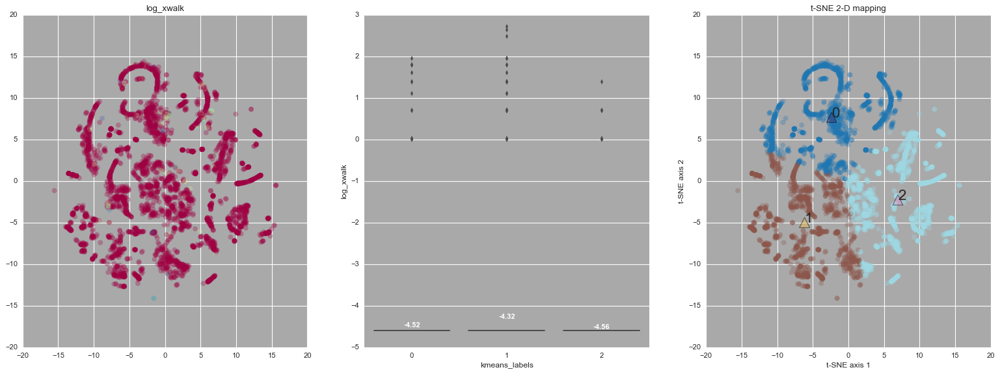

************************** log_assist
****************************************


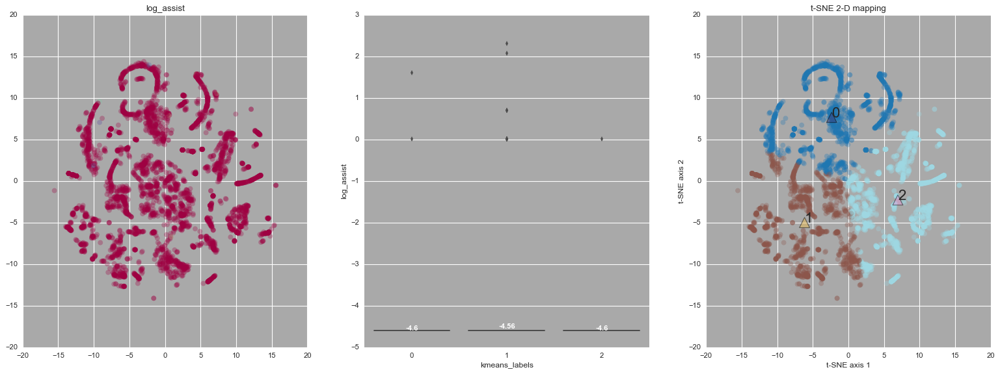

************************** log_bikes
****************************************


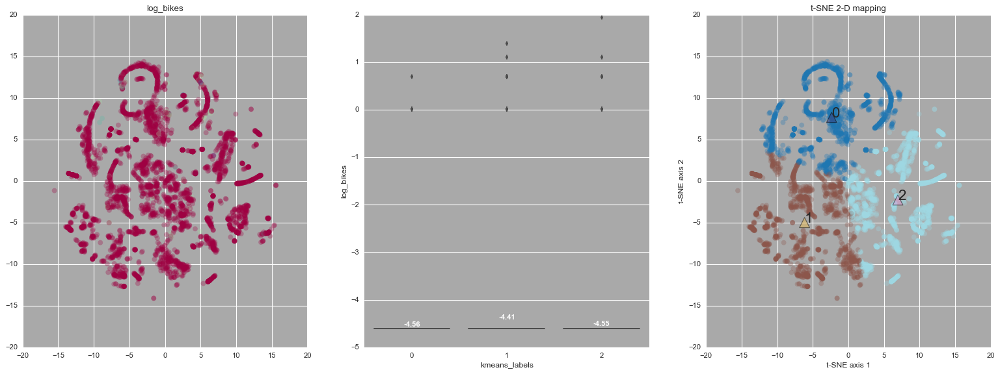

************************** log_drives
****************************************


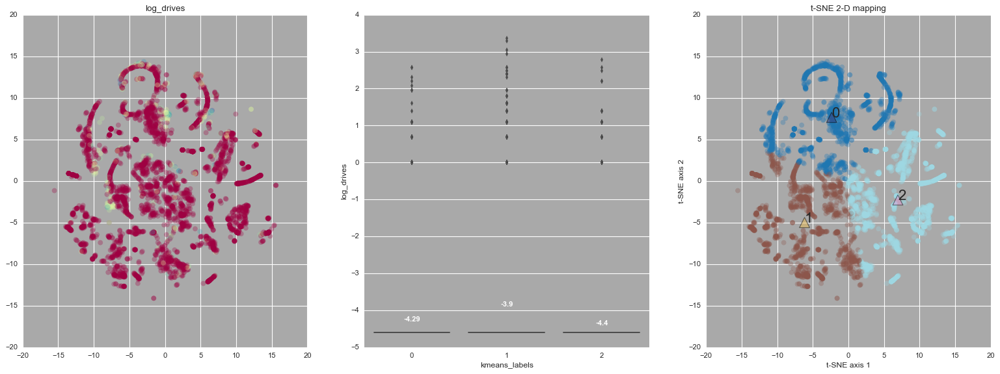

************************** log_other.1
****************************************


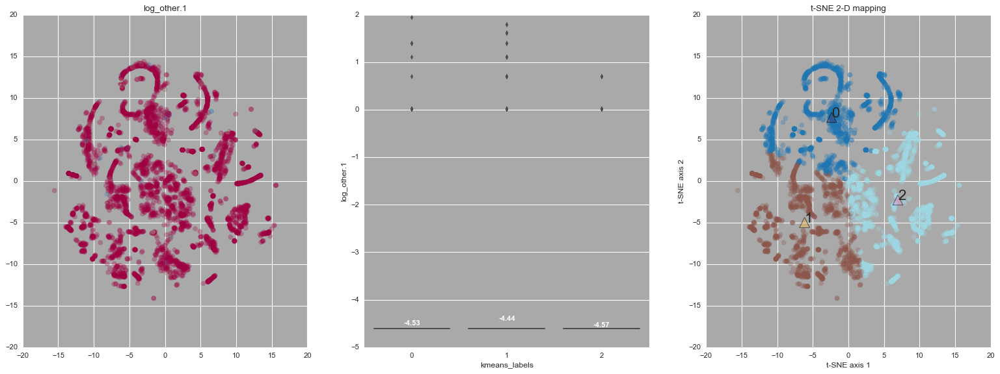

************************** log_walks
****************************************


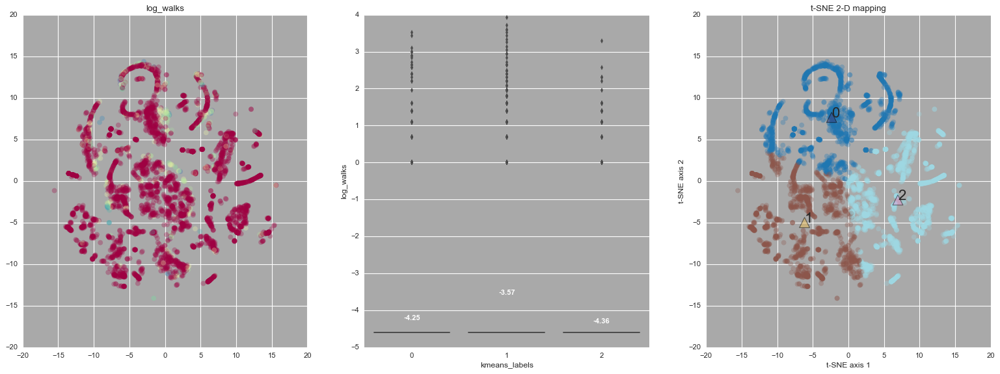

************************** log_num_walk_scores
****************************************


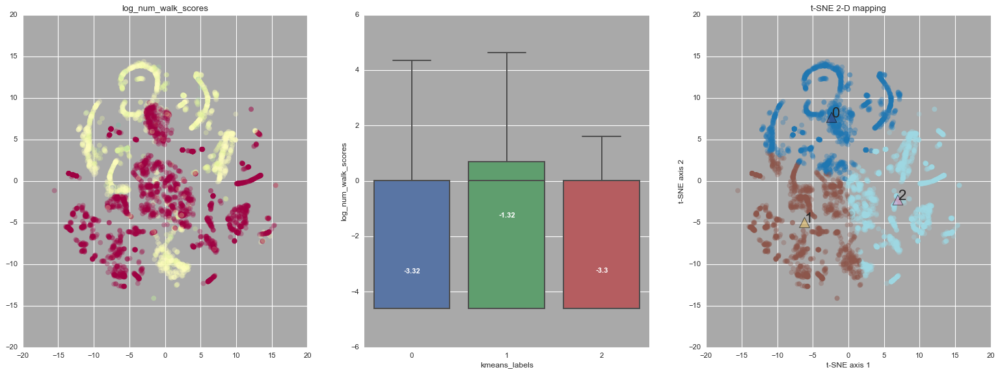

************************** log_sum_lane_cnt
****************************************


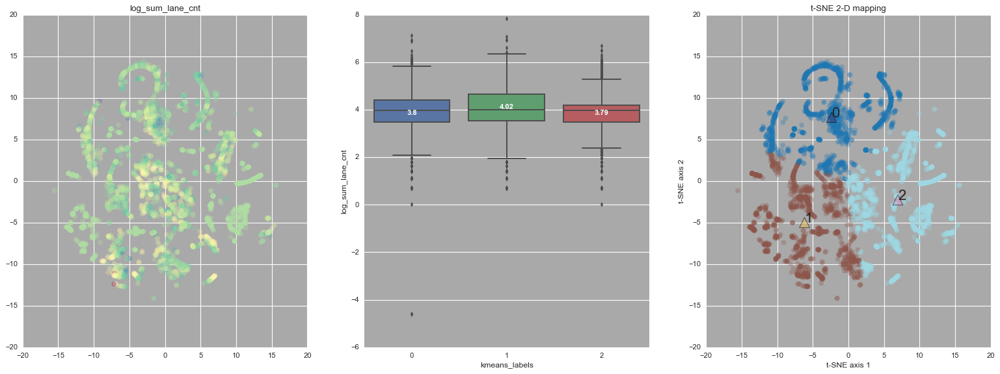

************************** log_sum_width
****************************************


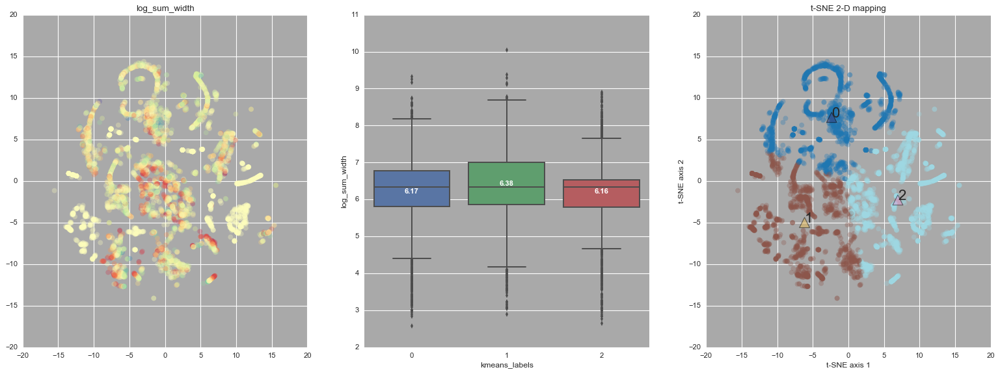

************************** log_sum_area
****************************************


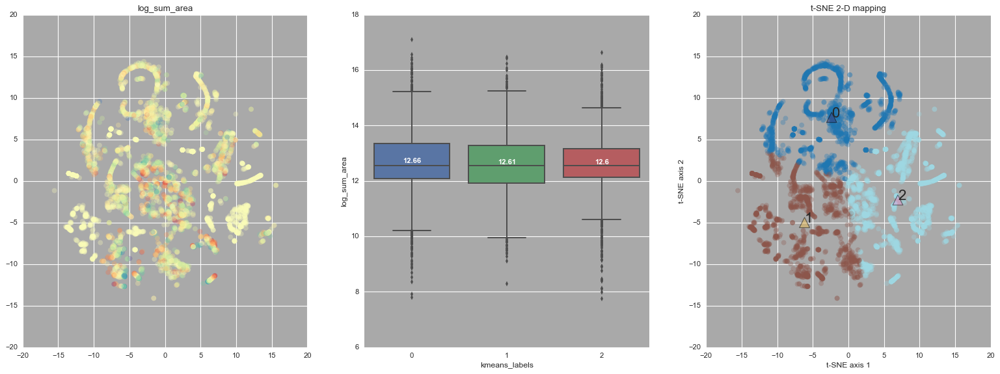

************************** log_num_streets
****************************************


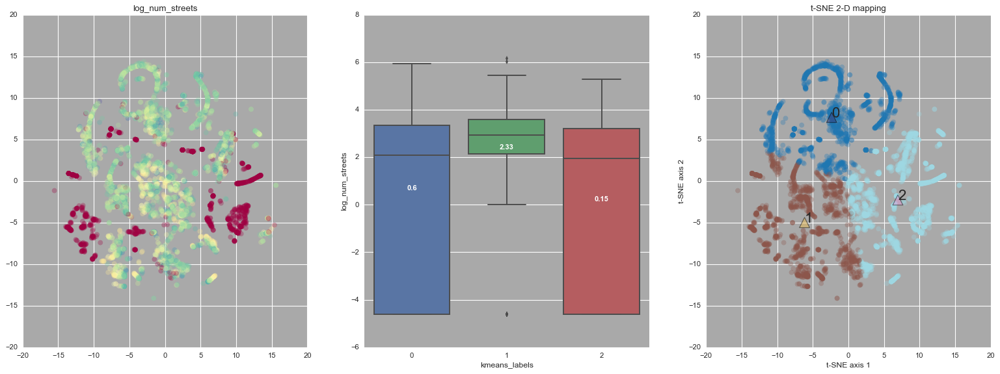

************************** log_num_fire_incd
****************************************


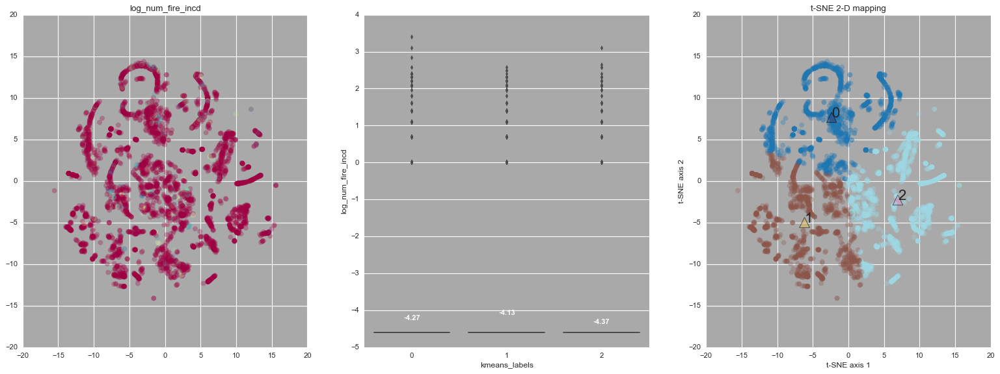

************************** log_med_sale_res_y
****************************************


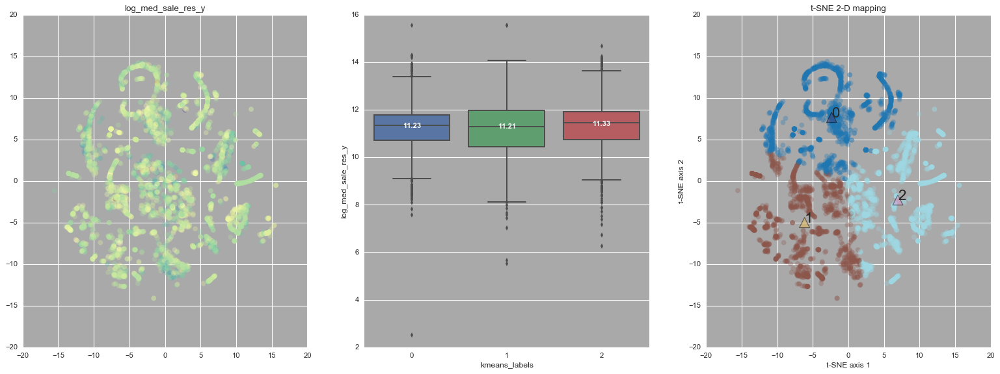

************************** log_med_sale_res_n
****************************************


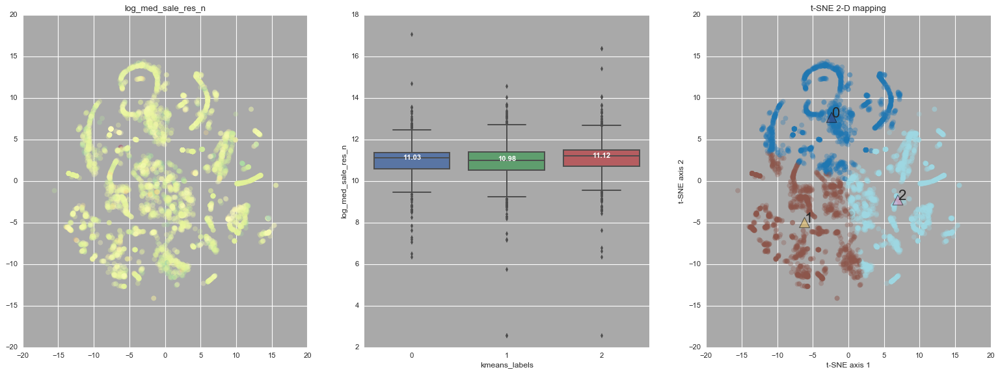

************************** log_med_sale_com_y
****************************************


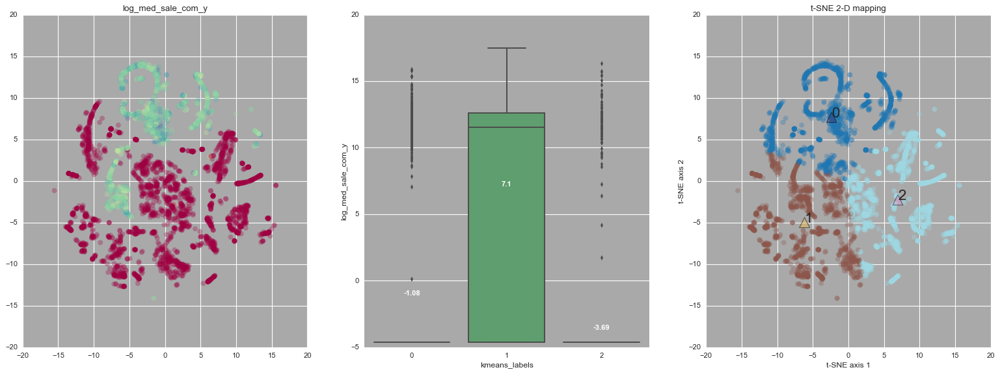

************************** log_med_sale_com_n
****************************************


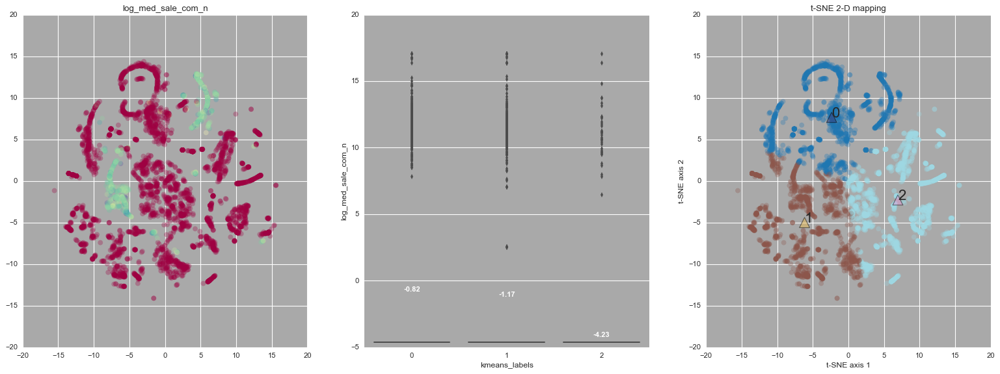

************************** log_med_sale_ind_y
****************************************


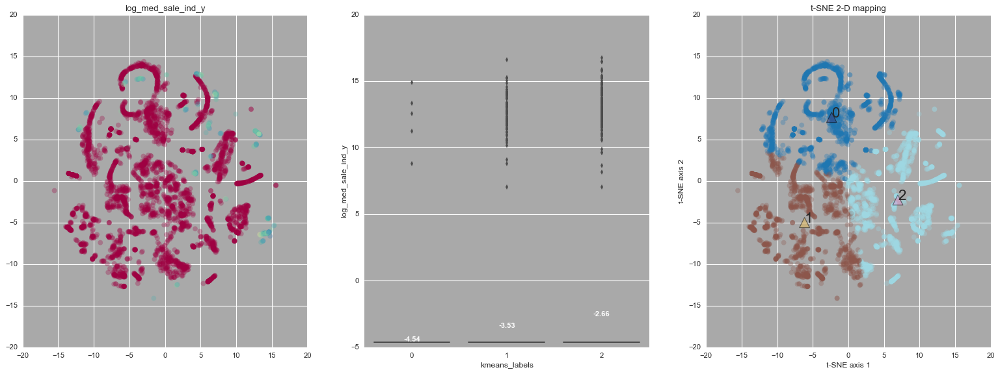

************************** log_med_sale_ind_n
****************************************


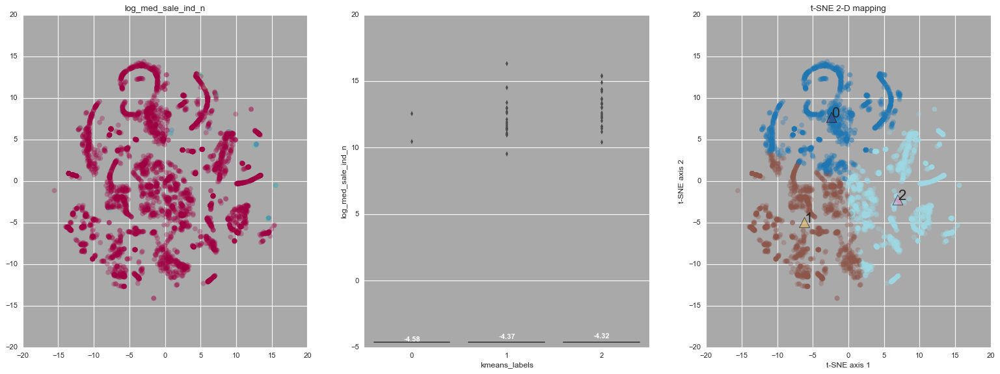

************************** log_med_sale_pbo_y
****************************************


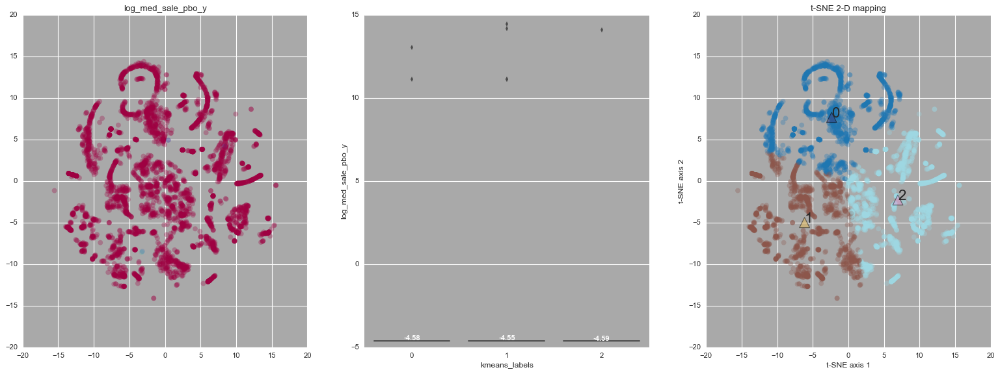

************************** log_sum_cost.y
****************************************


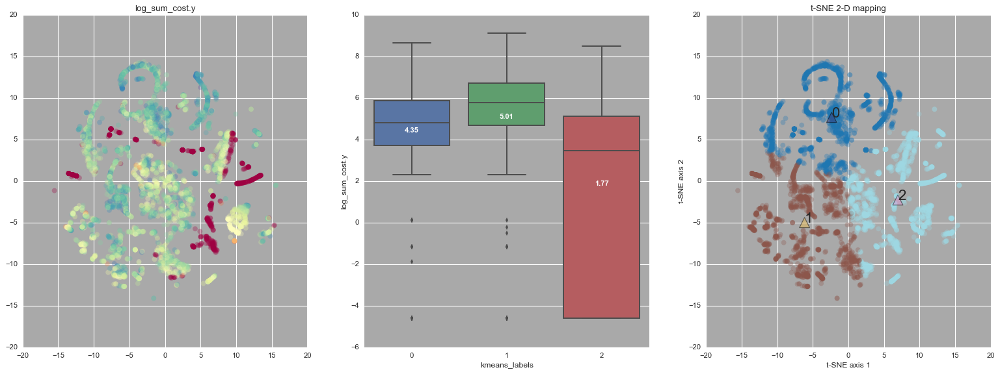

************************** log_num_events.y
****************************************


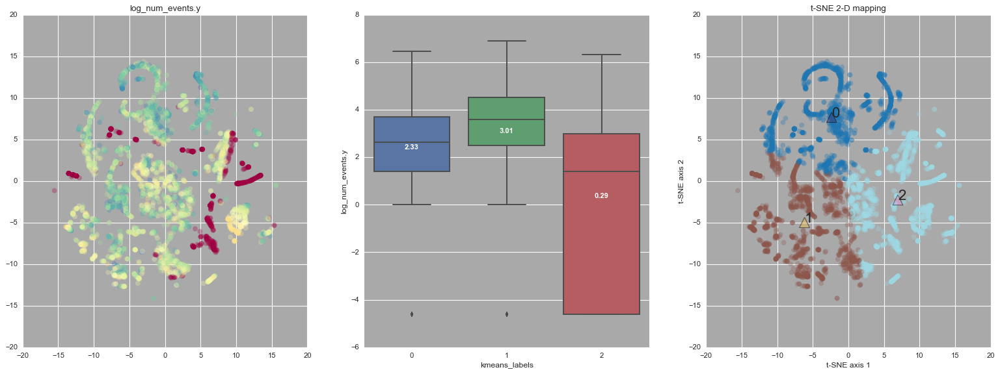

************************** log_dist
****************************************


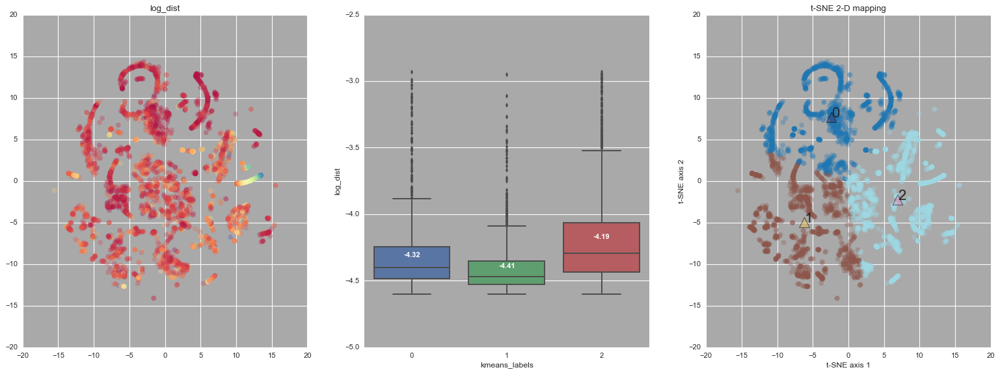

************************** log_n_object
****************************************


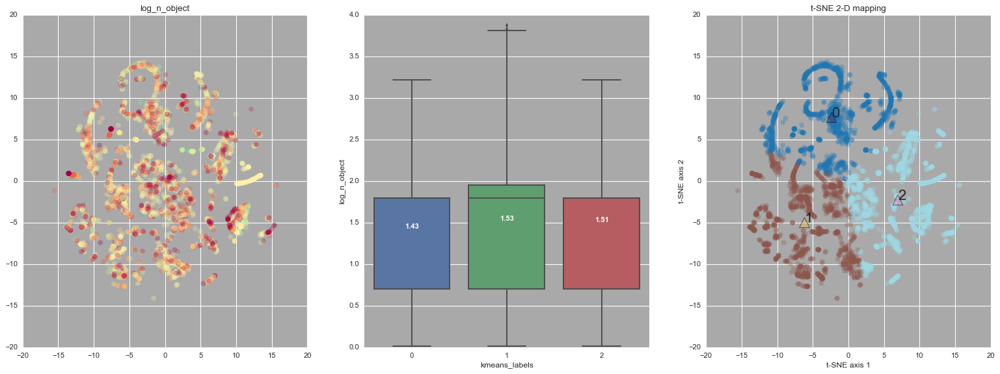

************************** log_animals_insects
****************************************


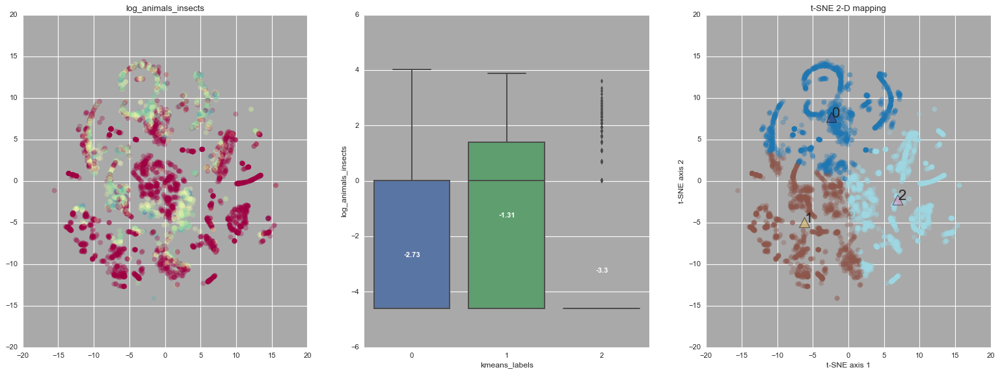

************************** log_building.related
****************************************


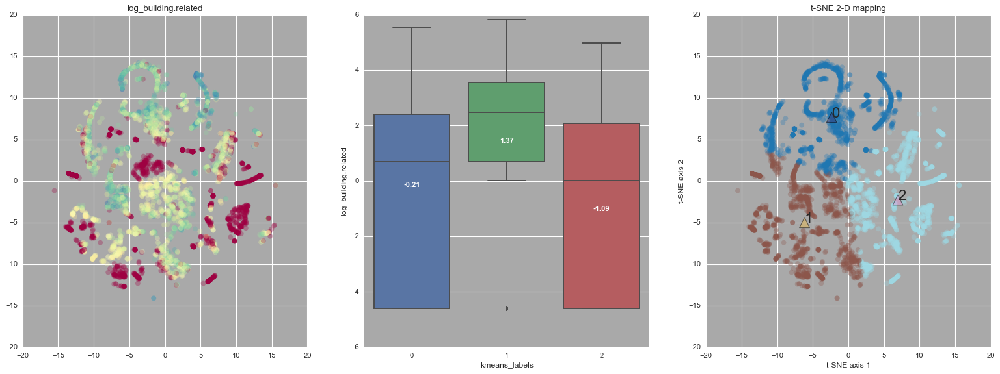

************************** log_construction
****************************************


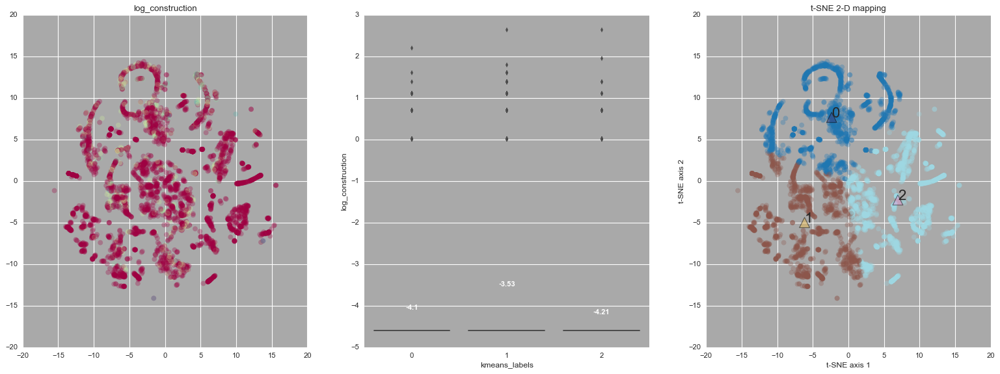

************************** log_food
****************************************


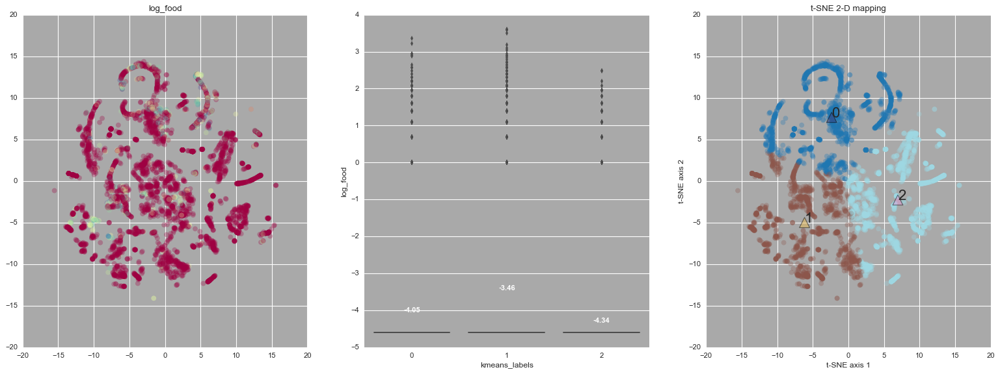

************************** log_others
****************************************


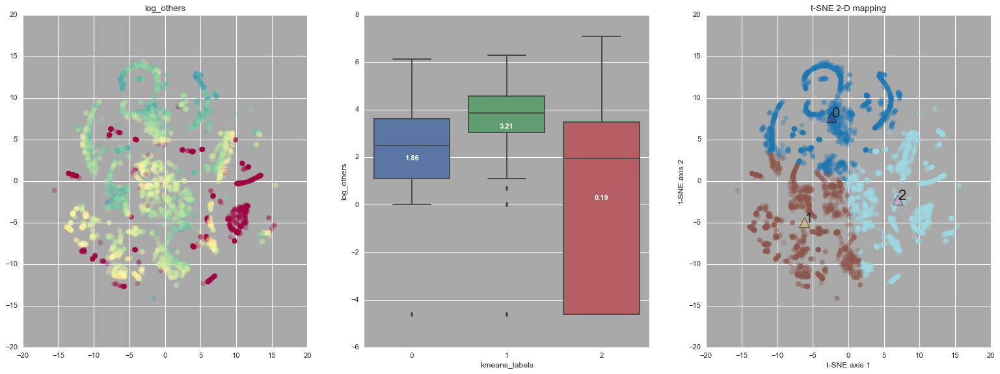

************************** log_police.property
****************************************


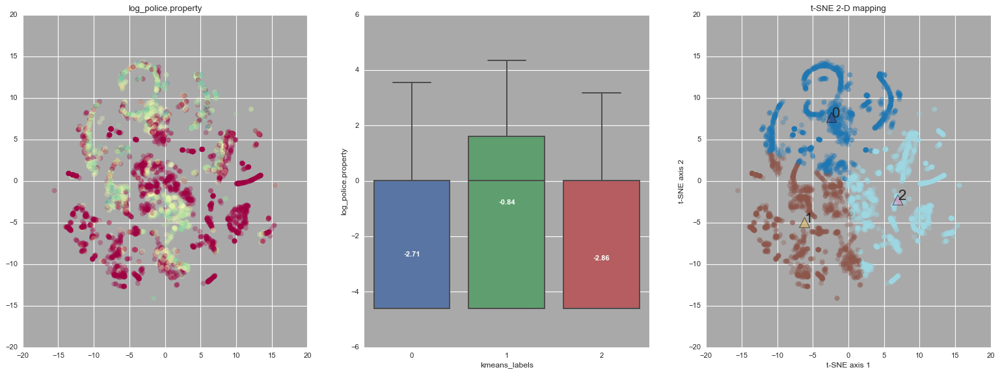

************************** log_service.complaint
****************************************


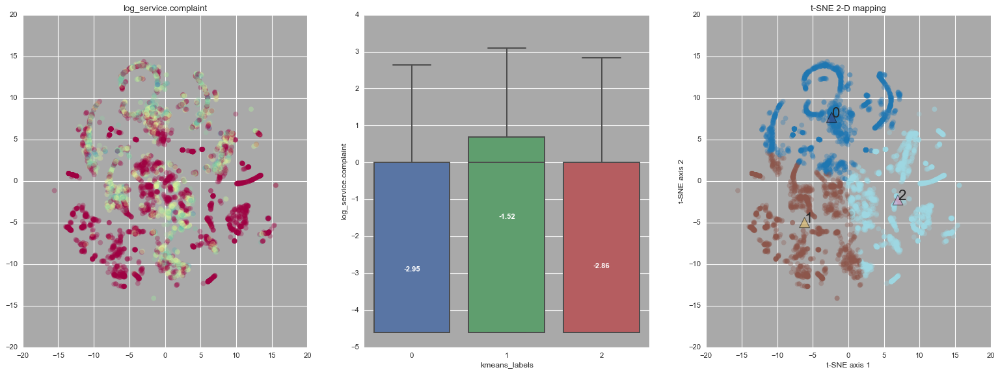

************************** log_street_sidewalk
****************************************


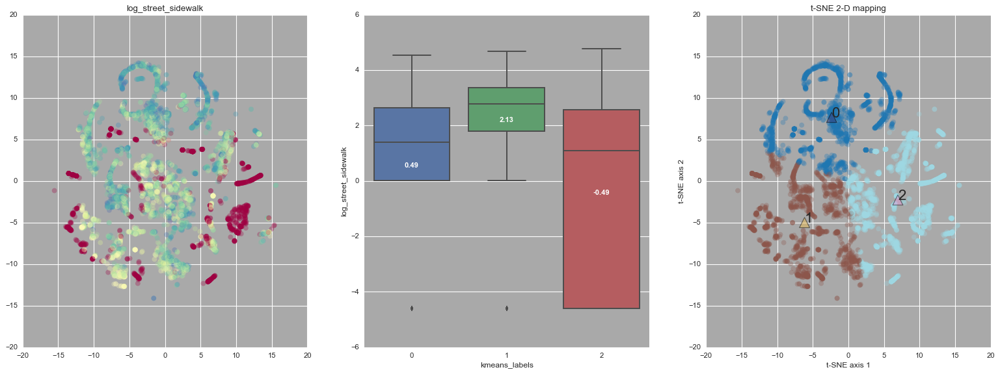

************************** log_traffic_sig0l
****************************************


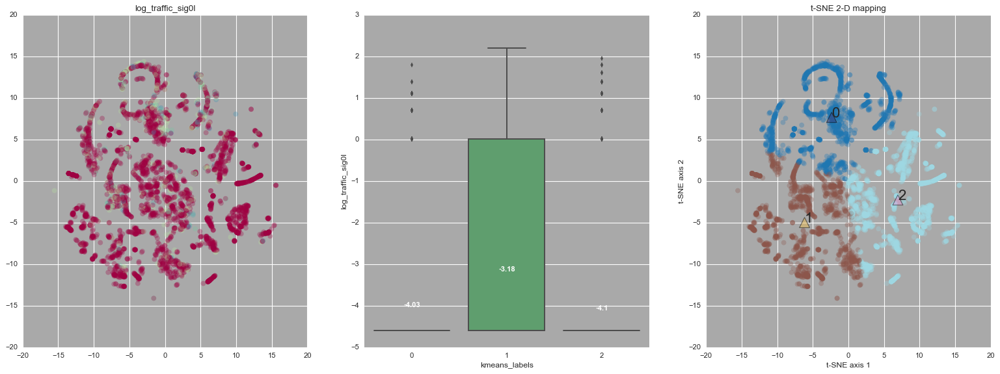

************************** log_trash
****************************************


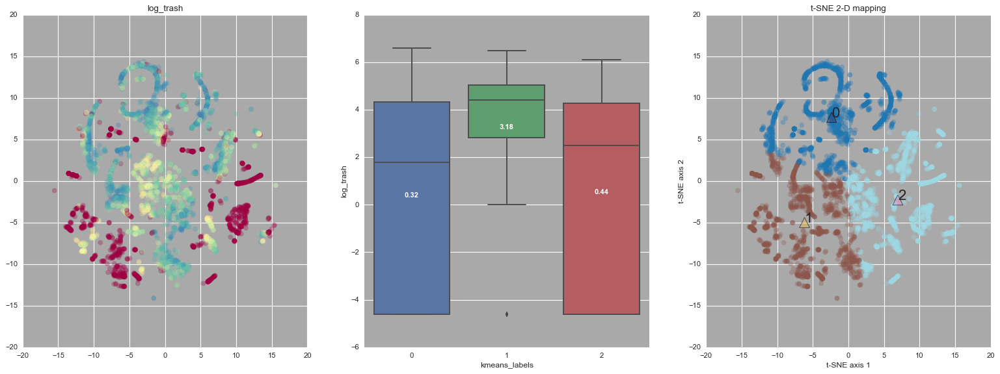

************************** log_trees_plants
****************************************


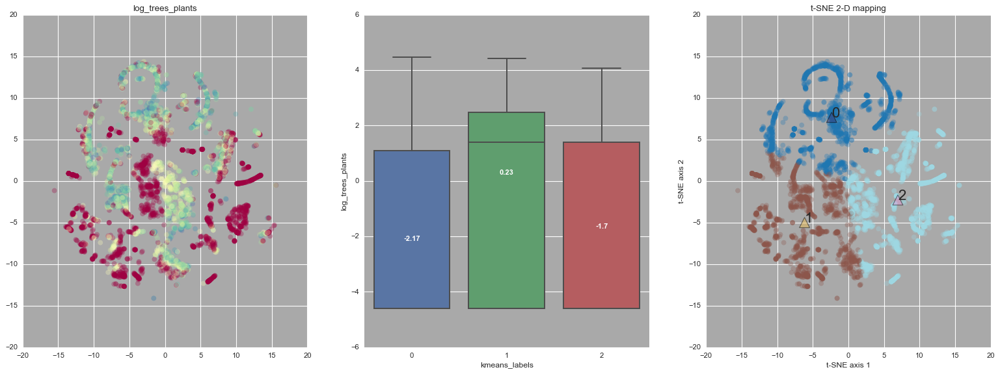

************************** log_water.leak
****************************************


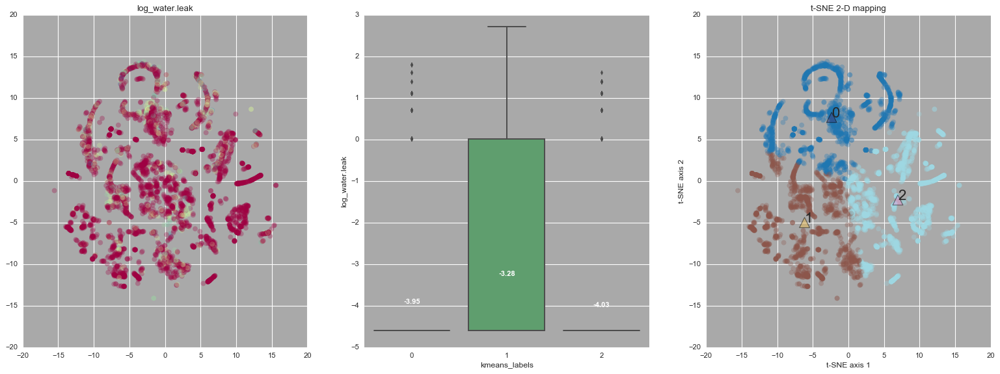

************************** log_zoning_parking
****************************************


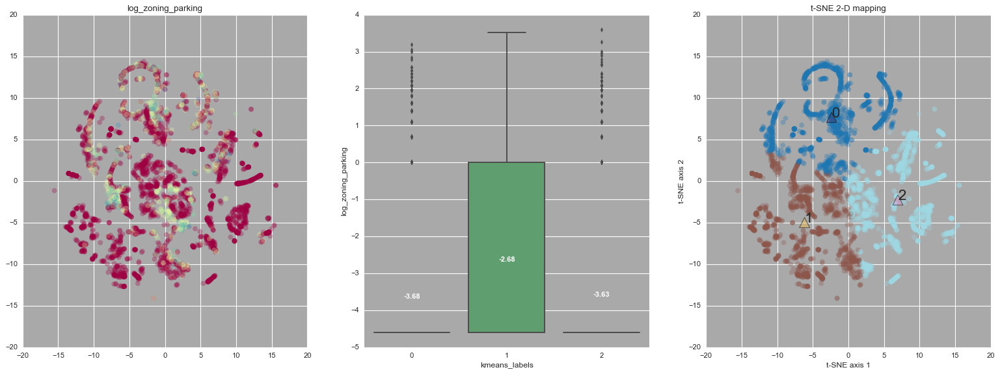

************************** log_n_request
****************************************


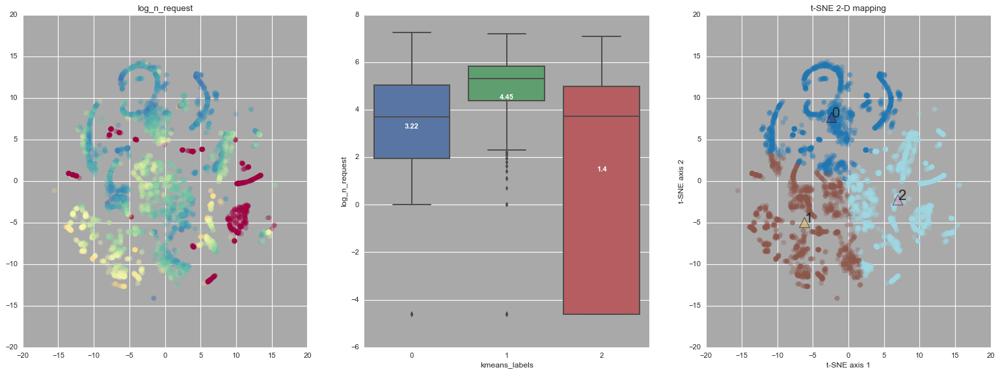

In [213]:

for col in col_names :
    
    _ = plt.figure(figsize=(24, 8));
    print('**************************',col)
# ... feature distribution color map 

    _ = plt.subplot(131, facecolor = 'darkgrey');
    
    _ = plt.scatter(X_all_together['x-tsne'], X_all_together['y-tsne'],
                 c = X_all_together[col],
                 cmap = plt.cm.Spectral,
                 s = 50,
                 linewidths = 0,
                 alpha = 0.30)
    _ = plt.title(col)
    
# ... feature boxplots

    _ = plt.subplot(132, facecolor = 'darkgrey');
    ax = sns.boxplot(x = "kmeans_labels", y = col, data = X_all_together)
    
    
    average_values = X_all_together.groupby(['kmeans_labels'])[col].mean().values
    average_labels = [str(np.round(s, 2)) for s in average_values]

    pos = range(len(average_values))
    for tick, label in zip(pos, ax.get_xticklabels()):
        _ = ax.text(pos[tick], average_values[tick], average_labels[tick], 
                horizontalalignment = 'center', size = 'small', color = 'w', weight = 'semibold')

# ... cluster color map
    
    _ = plt.subplot(133, facecolor = 'darkgrey');
    
    _ = plt.scatter(X_all_together['x-tsne'], X_all_together['y-tsne'],
                 c = kmeans_labels,
                 cmap = plt.cm.tab20,
                 s = 50,
                 linewidths = 0,
                 alpha = 0.30)
    _ = plt.scatter(kmeans_centers[:, 0], kmeans_centers[:, 1],
                c = range(n_lda),
                cmap = plt.cm.tab20b,
                s = 200,
                linewidths = 1.0,
                marker = '^',
                edgecolors = 'black',
                alpha = 0.50);    
    for ii in range(n_lda) :                                       
        _ = plt.text(kmeans_centers[ii, 0], kmeans_centers[ii, 1], ii, fontsize = 20)
        
    _ = plt.xlabel('t-SNE axis 1')
    _ = plt.ylabel('t-SNE axis 2')
    _ = plt.title('t-SNE 2-D mapping')
    
    data_dir = 'C:/Users/Preeti/Github/CapstoneProject/unsupervised/plots/kmeans/'
    data_file_base = "Kmeans_comparison_by_"
    data_file_num = str(col)
    data_file_ext = ".png"
    plt_file_2_save = data_dir + data_file_base + data_file_num +  data_file_ext
    
    plt.savefig(plt_file_2_save)
    
     #   print("****************************************")
#    print(col)
  #  print(average_values)
  #  print(average_labels)
    raw_data = {
    'Column Name':col,
    'cluster 0':average_values[0],
    'cluster 1':average_values[1],
    'cluster 2':average_values[2]
    }

    df_tbl = pd.DataFrame(raw_data,
    columns = ['Column Name','cluster 0','cluster 1','cluster 2'],#,'cluster 3','cluster 4'],
    index = [i_index + 1])
    kmeans_weight_tbl = kmeans_weight_tbl.append(df_tbl)    
    print("****************************************")

    _ = plt.show();

In [166]:
kmeans_weight_tbl.reset_index(inplace=True)
kmeans_weight_tbl

,index,Column Name,cluster 0,cluster 1,cluster 2
0,1,min_walk_score,42.970567,51.398502,38.252330
1,1,max_walk_score,46.374540,56.504120,42.036618
2,1,mean_walk_score,44.677999,54.152780,40.144419
3,1,med_sale_pbo_n,0.000000,0.000000,0.000000
4,1,log_sum_cost_pedestrian_events,-3.651643,-2.794748,-4.132869
5,1,log_num_near_misses,-4.567815,-4.469328,-4.571371
6,1,log_n_rqst,-4.049793,-3.243168,-4.221500
7,1,log_access,-4.594982,-4.556411,-4.598107
8,1,log_dblprk,-4.579076,-4.540366,-4.592421
9,1,log_dnotyld,-4.513550,-4.261329,-4.555599


In [167]:
X_cluster_analysis = copy.deepcopy(X_all_together)
#del X_cluster_analysis['x-tsne']
#del X_cluster_analysis['y-tsne']
#del X_cluster_analysis['sample_index']

grouped = X_cluster_analysis.groupby(['kmeans_labels'])

cluster_analysis_tbl = (grouped.mean() - X_cluster_analysis.mean()) / X_cluster_analysis.std()

cluster_analysis_tbl

#HC_Complete_analysis_tbl

,cell_id,kmeans_10,kmeans_11,kmeans_2,kmeans_3,kmeans_4,kmeans_5,kmeans_6,kmeans_7,kmeans_8,...,log_water.leak,log_wlksig,log_xwalk,log_zoning_parking,max_walk_score,mean_walk_score,med_sale_pbo_n,min_walk_score,x-tsne,y-tsne
kmeans_labels,,,,,,,,,,,,,,,,,,,,,
0,0.068123,0.444324,0.226950,-0.701346,-1.253232,1.045983,-0.288080,0.656073,0.671030,-0.050913,...,-0.099481,-0.025367,-0.061016,-0.144559,-0.117716,-0.099874,NaN,-0.068895,-0.839849,-0.722863
1,-0.002374,-0.418727,-0.021867,-0.473435,-0.041303,-1.153880,0.837742,-0.278950,-0.461861,0.455161,...,0.260978,0.078787,0.180751,0.285685,0.596295,0.580094,NaN,0.516139,-0.281514,1.136279
2,-0.059528,-0.029851,-0.185907,1.055369,1.170627,0.079187,-0.483945,-0.345676,-0.196635,-0.358489,...,-0.141951,-0.047075,-0.105447,-0.123125,-0.423487,-0.425231,NaN,-0.396416,1.010104,-0.355900


In [170]:
cluster_analysis_tbl.columns

Index(['cell_id', 'kmeans_10', 'kmeans_11', 'kmeans_2', 'kmeans_3', 'kmeans_4',
       'kmeans_5', 'kmeans_6', 'kmeans_7', 'kmeans_8', 'kmeans_9',
       'kmeans_labels', 'log_access', 'log_animals_insects', 'log_assist',
       'log_bikes', 'log_building.related', 'log_construction', 'log_dblprk',
       'log_dist', 'log_dnotyld', 'log_drives', 'log_food', 'log_jywalk',
       'log_lvisib', 'log_lwfws', 'log_med_sale_com_n', 'log_med_sale_com_y',
       'log_med_sale_ind_n', 'log_med_sale_ind_y', 'log_med_sale_pbo_y',
       'log_med_sale_res_n', 'log_med_sale_res_y', 'log_n_object',
       'log_n_request', 'log_n_rqst', 'log_nobikef', 'log_noswlk',
       'log_num_events.y', 'log_num_fire_incd', 'log_num_near_misses',
       'log_num_streets', 'log_num_walk_scores', 'log_other', 'log_other.1',
       'log_others', 'log_police.property', 'log_prkint', 'log_prkswlk',
       'log_service.complaint', 'log_speed', 'log_street_sidewalk',
       'log_sum_area', 'log_sum_cost.y', 'log_sum_co

In [226]:
cluster_analysis_tbl.drop(['log_sum_cost_pedestrian_events'], axis=1, inplace=True)
cluster_analysis_tbl

,log_access,log_animals_insects,log_assist,log_bikes,log_building.related,log_construction,log_dblprk,log_dist,log_dnotyld,log_drives,...,log_vrrlss,log_walks,log_water.leak,log_wlksig,log_xwalk,log_zoning_parking,max_walk_score,mean_walk_score,med_sale_pbo_n,min_walk_score
kmeans_labels,,,,,,,,,,,,,,,,,,,,,
0,-0.034036,-0.089321,-0.036182,-0.071223,-0.056189,-0.085231,-0.018647,-0.073566,-0.071214,-0.063363,...,-0.050535,-0.108873,-0.099481,-0.025367,-0.061016,-0.144559,-0.117716,-0.099874,NaN,-0.068895
1,0.083669,0.415724,0.094816,0.138275,0.409966,0.257157,0.077102,-0.360108,0.204295,0.218507,...,0.178964,0.301739,0.260978,0.078787,0.180751,0.285685,0.596295,0.580094,NaN,0.516139
2,-0.043571,-0.288685,-0.051536,-0.058458,-0.313545,-0.151448,-0.051658,0.386631,-0.117146,-0.136882,...,-0.113342,-0.169683,-0.141951,-0.047075,-0.105447,-0.123125,-0.423487,-0.425231,NaN,-0.396416


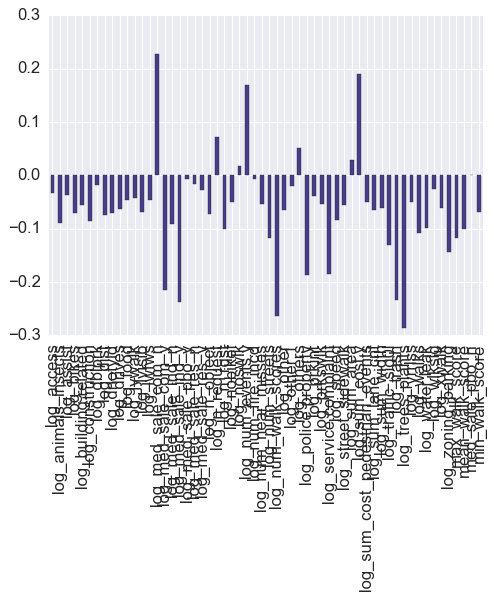

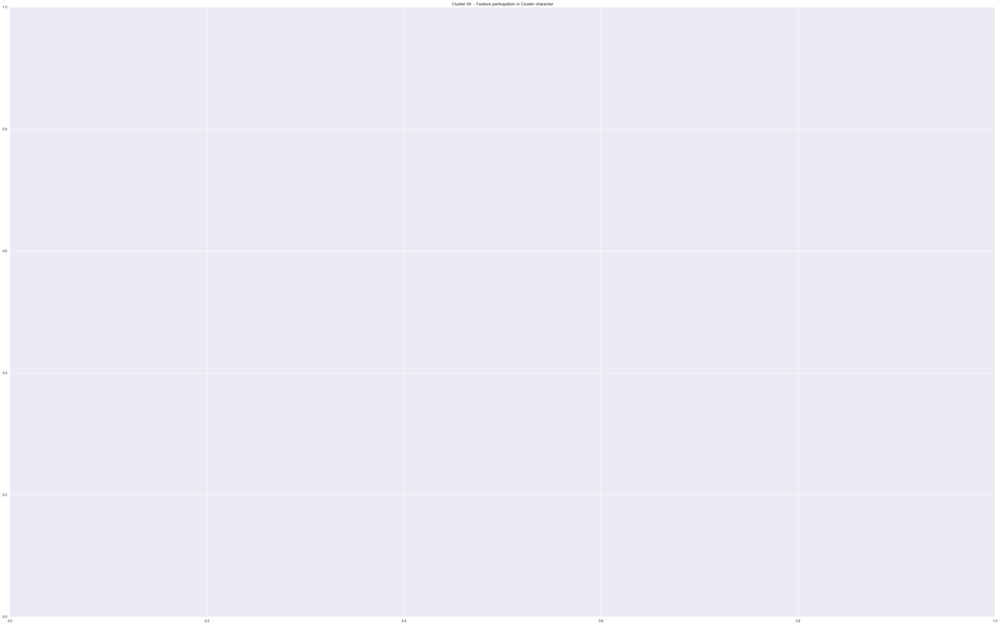

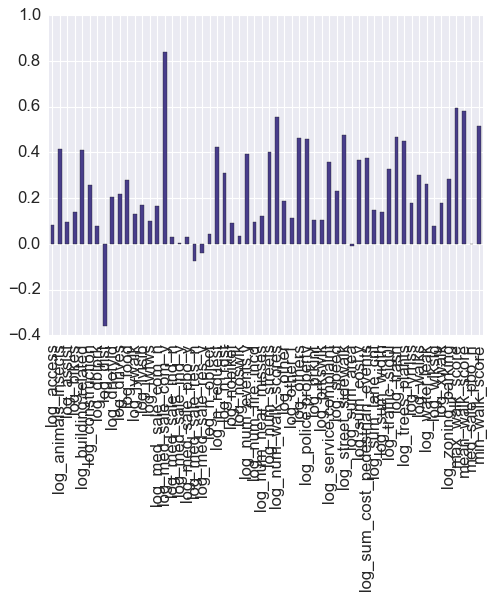

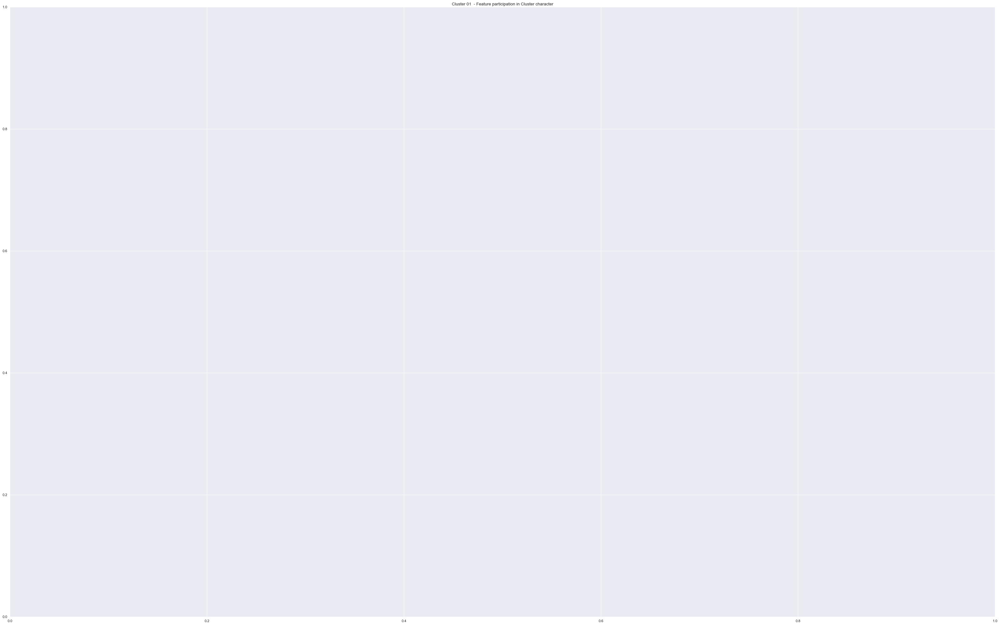

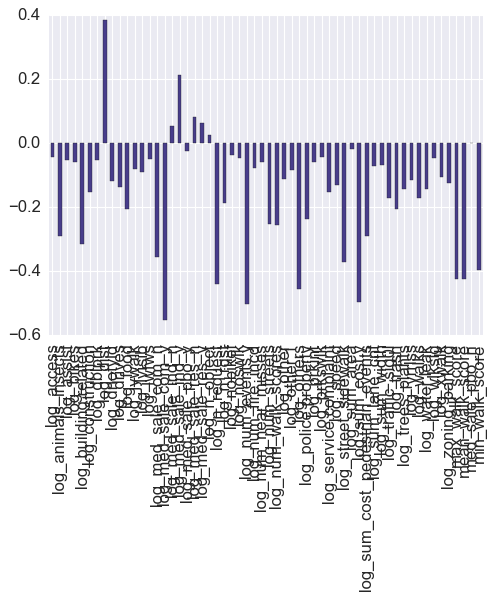

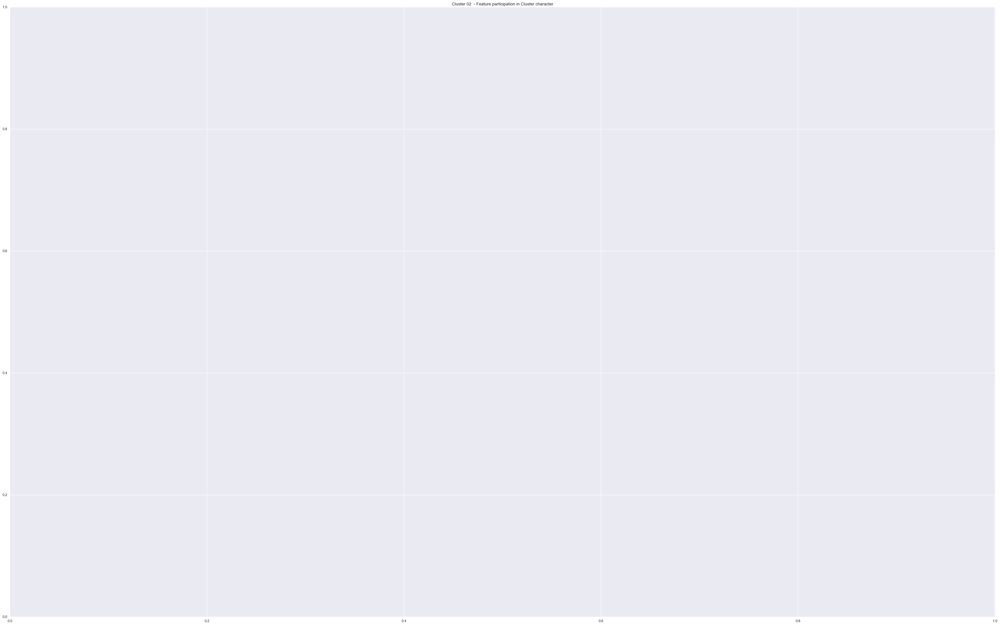

In [223]:
n_optimal_clusters= 3

    
# .sort_values(ascending = False)

#plot_rows = int((n_optimal_clusters + 1)/2)

for ii in range(n_optimal_clusters) :
    
    #ax = plt.subplot(plot_rows, 2, ii+1, facecolor = 'darkgrey');
    
   # if ii < n_optimal_clusters-1 :
    #    wgt = pd.Series(cluster_analysis_tbl.ix[ii],index = cluster_analysis_tbl.columns)
  #  else :
    wgt = pd.Series(cluster_analysis_tbl.ix[ii],
                    index = cluster_analysis_tbl.columns)
        
    _ = wgt.plot(kind = 'bar', fontsize = 15, color = 'darkslateblue')
    
    _ = plt.figure(figsize=(50, 30));

    _ = plt.grid(True) 
    
    #if ii < n_optimal_clusters-2:
    #_ = ax.xaxis.set_ticklabels([])
    
    _ = plt.title("Cluster %02d  - Feature participation in Cluster character" %ii)
    
    #name = "cluster_kmeans_cluster_barplots.png"
    plt.savefig("../plots/clustering/Cluster %02d  - Feature participation in Cluster character" %ii)
    
    plt.show()

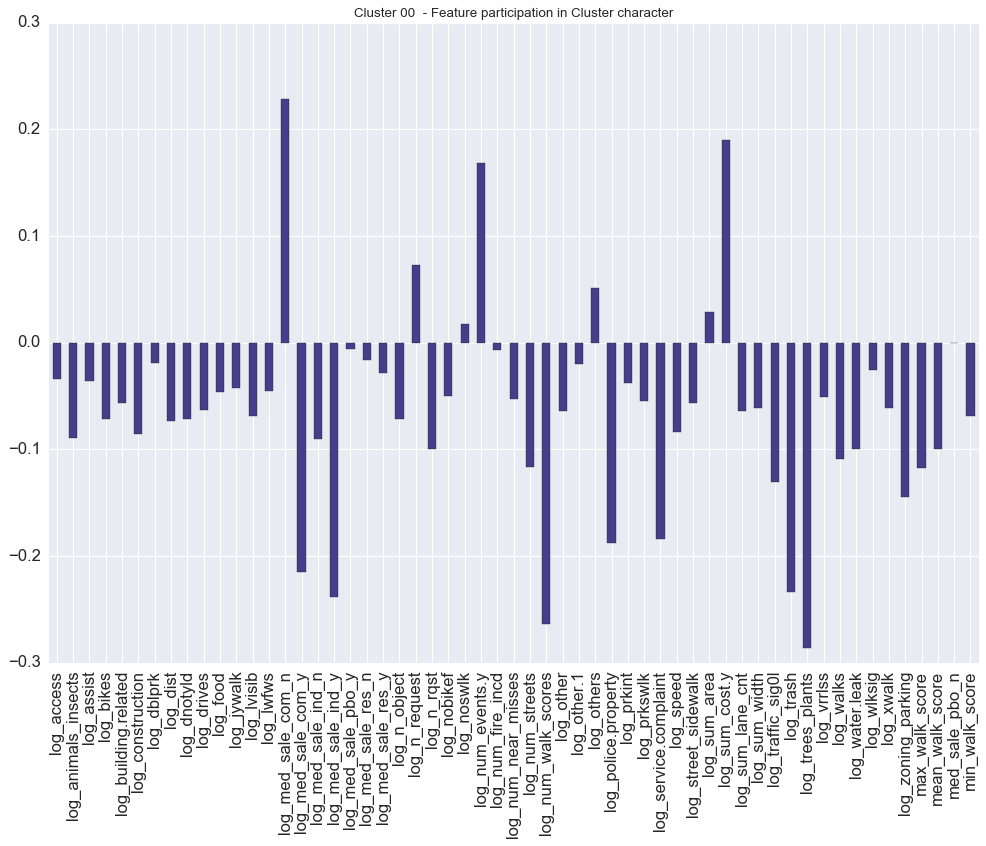

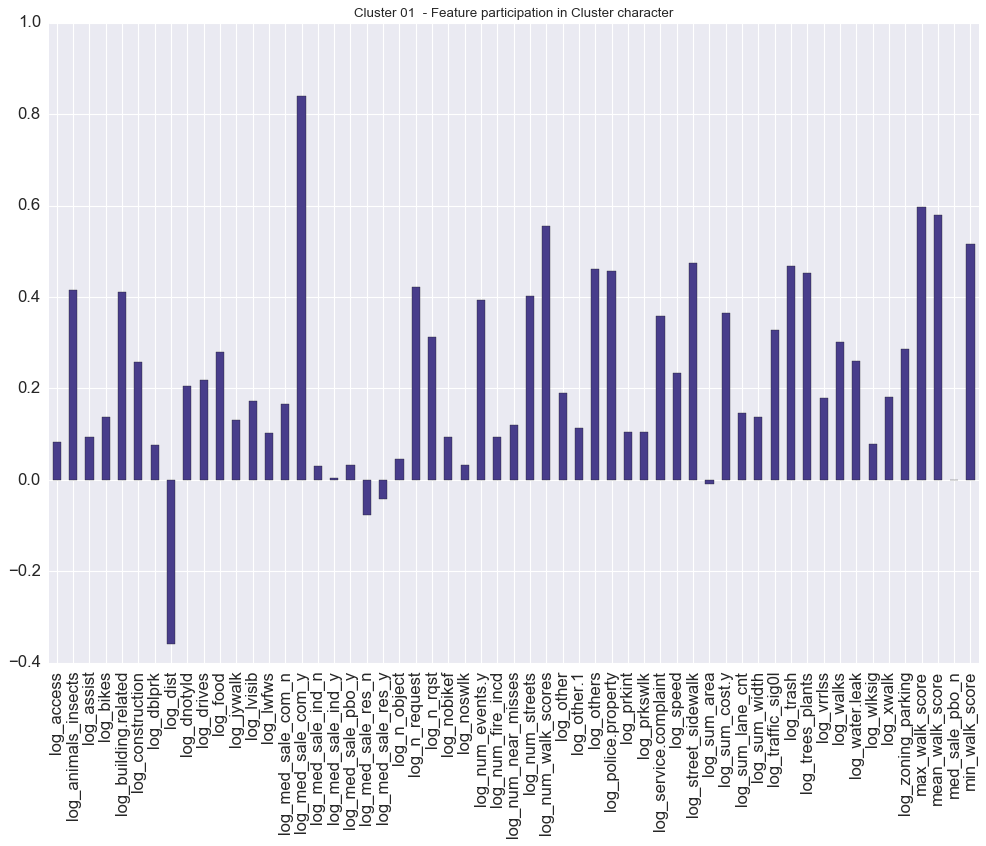

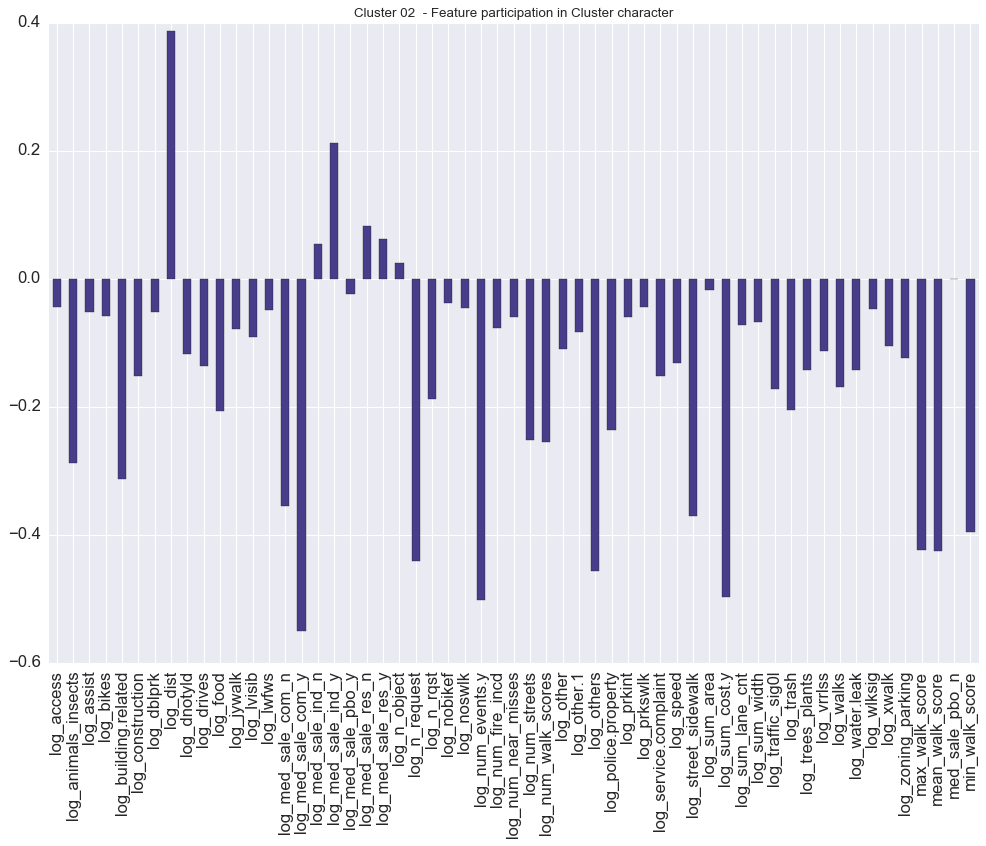

In [227]:
n_optimal_clusters= 3


for ii in range(n_optimal_clusters) :
    
    wgt = pd.Series(cluster_analysis_tbl.ix[ii],index = cluster_analysis_tbl.columns)
        
    _ = wgt.plot(kind = 'bar', fontsize = 15, color = 'darkslateblue',figsize=(15, 10))
    
    _ = plt.grid(True) 
    
    _ = plt.title("Cluster %02d  - Feature participation in Cluster character" %ii)
    
    plt.savefig("../plots/clustering/Cluster %02d  - Feature participation in Cluster character" %ii)
    plt.show()

In [176]:
#for row in kmeans_weight_tbl.iterrows():
sum = kmeans_weight_tbl['cluster 0'] + kmeans_weight_tbl['cluster 1']+ kmeans_weight_tbl['cluster 2'] #+ kmeans_weight_tbl['cluster 3'] + kmeans_weight_tbl['cluster 4']
kmeans_weight_tbl['Cluster #0'] = (kmeans_weight_tbl['cluster 0']/sum )  * 100
kmeans_weight_tbl['Cluster #1'] = (kmeans_weight_tbl['cluster 1']/sum )  * 100
kmeans_weight_tbl['Cluster #2'] =  (kmeans_weight_tbl['cluster 2']/sum )  * 100
print(sum)

0     132.621399
1     144.915278
2     138.975197
3       0.000000
4     -10.579260
5     -13.608513
6     -11.514461
7     -13.749501
8     -13.711863
9     -13.330478
10    -13.580182
11    -13.444941
12    -13.717817
13    -13.682341
14    -13.571275
15    -13.166953
16    -13.556623
17    -13.628197
18    -12.694956
19    -13.302866
20    -13.716828
21    -13.397150
22    -13.754711
23    -13.518121
24    -12.587100
25    -13.548207
26    -12.182291
27     -7.940804
28     11.615959
29     18.700634
30     37.864256
31      3.087647
32    -12.763642
33     33.764546
34     33.123177
35      2.328047
36     -6.216326
37    -10.729366
38    -13.271093
39    -13.726591
40     11.139161
41      5.626091
42    -12.914506
43      4.464468
44     -7.335313
45      0.070168
46    -11.835023
47    -11.854257
48      5.262792
49     -6.412991
50     -7.326177
51      2.138952
52    -11.309513
53      3.935581
54     -3.647128
55    -11.265913
56     -9.986305
57      9.075191
dtype: float64

In [177]:
kmeans_weight_tbl.set_index('Column Name')
#kmeans_weight_tbl_plot = kmeans_weight_tbl[['Column Name','0_per','1_per','2_per','3_per','4_per']].T

,index,cluster 0,cluster 1,cluster 2,Cluster #0,Cluster #1,Cluster #2
Column Name,,,,,,,
min_walk_score,1,42.970567,51.398502,38.252330,32.400930,38.755813,28.843257
max_walk_score,1,46.374540,56.504120,42.036618,32.001139,38.991141,29.007720
mean_walk_score,1,44.677999,54.152780,40.144419,32.148182,38.965787,28.886031
med_sale_pbo_n,1,0.000000,0.000000,0.000000,NaN,NaN,NaN
log_sum_cost_pedestrian_events,1,-3.651643,-2.794748,-4.132869,34.516998,26.417233,39.065769
log_num_near_misses,1,-4.567815,-4.469328,-4.571371,33.565860,32.842145,33.591995
log_n_rqst,1,-4.049793,-3.243168,-4.221500,35.171367,28.166040,36.662593
log_access,1,-4.594982,-4.556411,-4.598107,33.419267,33.138741,33.441992
log_dblprk,1,-4.579076,-4.540366,-4.592421,33.394992,33.112687,33.492322


In [178]:
kmeans_weight_tbl

,index,Column Name,cluster 0,cluster 1,cluster 2,Cluster #0,Cluster #1,Cluster #2
0,1,min_walk_score,42.970567,51.398502,38.252330,32.400930,38.755813,28.843257
1,1,max_walk_score,46.374540,56.504120,42.036618,32.001139,38.991141,29.007720
2,1,mean_walk_score,44.677999,54.152780,40.144419,32.148182,38.965787,28.886031
3,1,med_sale_pbo_n,0.000000,0.000000,0.000000,NaN,NaN,NaN
4,1,log_sum_cost_pedestrian_events,-3.651643,-2.794748,-4.132869,34.516998,26.417233,39.065769
5,1,log_num_near_misses,-4.567815,-4.469328,-4.571371,33.565860,32.842145,33.591995
6,1,log_n_rqst,-4.049793,-3.243168,-4.221500,35.171367,28.166040,36.662593
7,1,log_access,-4.594982,-4.556411,-4.598107,33.419267,33.138741,33.441992
8,1,log_dblprk,-4.579076,-4.540366,-4.592421,33.394992,33.112687,33.492322
9,1,log_dnotyld,-4.513550,-4.261329,-4.555599,33.858875,31.966816,34.174310


In [179]:
kmeans_cols = ['Cluster #0', 'Cluster #1', 'Cluster #2'] #, 'Cluster #3', 'Cluster #4']
kmeans_cols

['Cluster #0', 'Cluster #1', 'Cluster #2']

In [180]:
kmeans_weight_tbl

,index,Column Name,cluster 0,cluster 1,cluster 2,Cluster #0,Cluster #1,Cluster #2
0,1,min_walk_score,42.970567,51.398502,38.252330,32.400930,38.755813,28.843257
1,1,max_walk_score,46.374540,56.504120,42.036618,32.001139,38.991141,29.007720
2,1,mean_walk_score,44.677999,54.152780,40.144419,32.148182,38.965787,28.886031
3,1,med_sale_pbo_n,0.000000,0.000000,0.000000,NaN,NaN,NaN
4,1,log_sum_cost_pedestrian_events,-3.651643,-2.794748,-4.132869,34.516998,26.417233,39.065769
5,1,log_num_near_misses,-4.567815,-4.469328,-4.571371,33.565860,32.842145,33.591995
6,1,log_n_rqst,-4.049793,-3.243168,-4.221500,35.171367,28.166040,36.662593
7,1,log_access,-4.594982,-4.556411,-4.598107,33.419267,33.138741,33.441992
8,1,log_dblprk,-4.579076,-4.540366,-4.592421,33.394992,33.112687,33.492322
9,1,log_dnotyld,-4.513550,-4.261329,-4.555599,33.858875,31.966816,34.174310


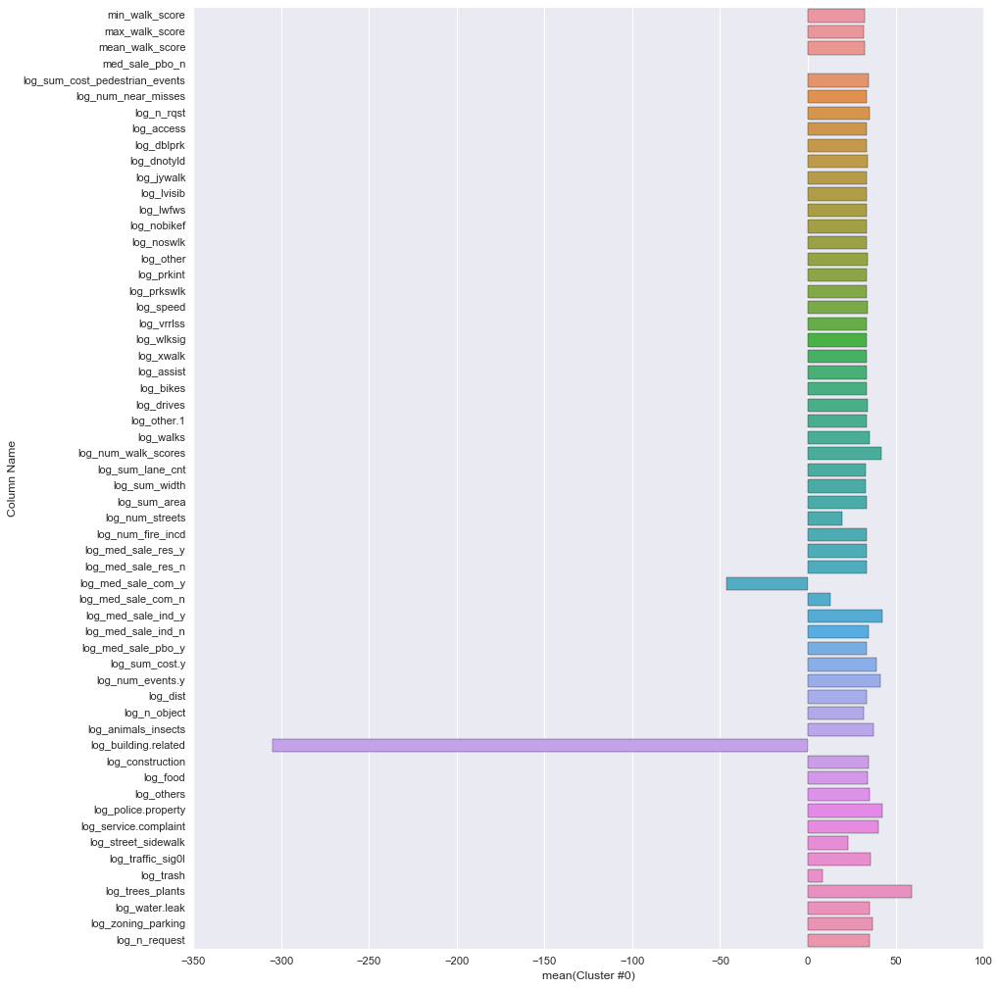

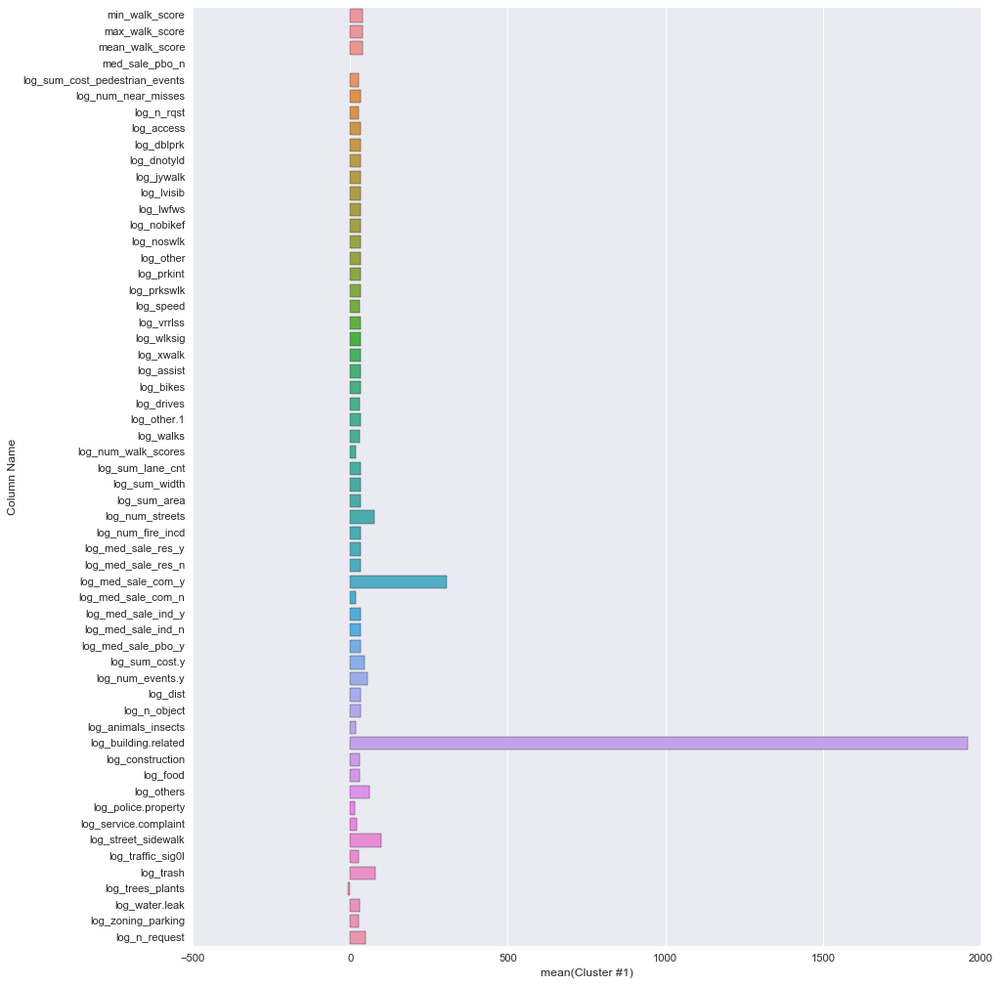

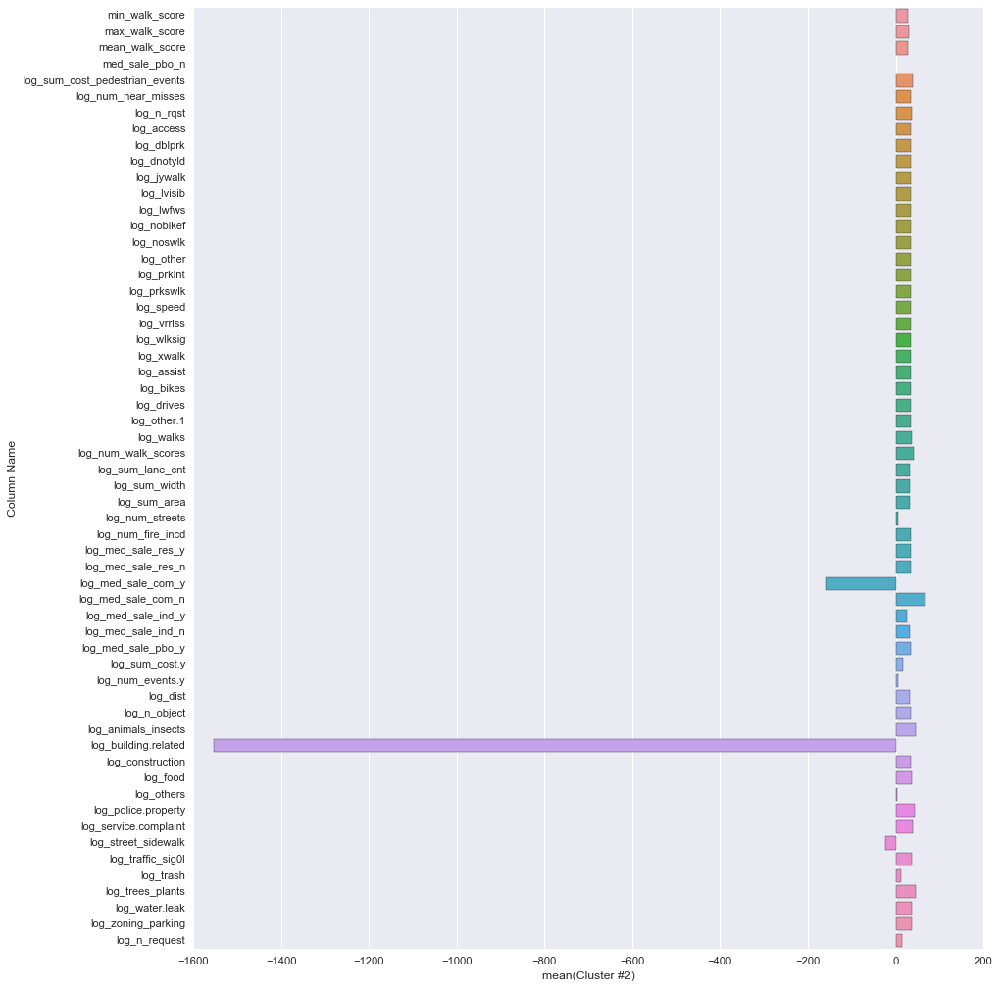

In [181]:
sns.set_style('whitegrid')
sns.set(rc={'figure.figsize':(13,15)})
for col in kmeans_cols:
    #sns.boxplot(y=col, x="index", data=kmeans_weight_tbl_plot,palette='rainbow')
    sns.barplot(y="Column Name", x=col, data=kmeans_weight_tbl)
    #sns.barplot(x='sex',y='total_bill',data=tips)
    data_dir = 'C:/Users/Preeti/Github/CapstoneProject/unsupervised/plots/kmeans/'
    data_file_base = "Kmeans_by_cluster_"
    data_file_num = str(col)
    data_file_ext = ".png"
    plt_file_2_save = data_dir + data_file_base + data_file_num + data_file_ext
    plt.savefig(plt_file_2_save)
    plt.show()

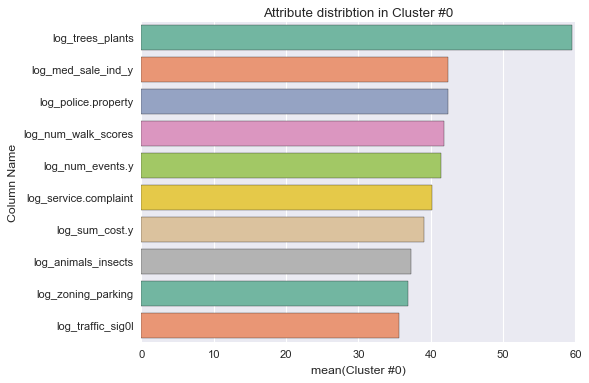

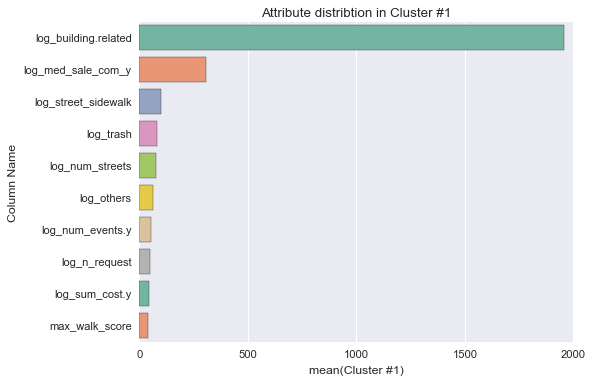

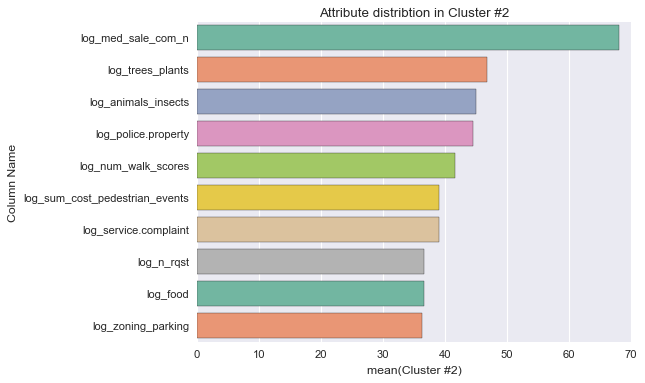

In [182]:
sns.set_style('whitegrid')
sns.set(rc={'figure.figsize':(7,5)})
for col in kmeans_cols:
    kmeans_weight_tbl.sort_values(by=[col],inplace=True, ascending=False)
    #sns.boxplot(y=col, x="index", data=kmeans_weight_tbl_plot,palette='rainbow')
    sns.barplot(y="Column Name", x=col, data=kmeans_weight_tbl.head(10),palette='Set2')
    #sns.barplot(x='sex',y='total_bill',data=tips)
    data_dir = 'C:/Users/Preeti/Github/CapstoneProject/unsupervised/plots/kmeans/'
    data_file_base = "Kmeans_by_cluster_top_5_in_"
    data_file_num = str(col)
    data_file_ext = ".png"
    plt_file_2_save = data_dir + data_file_base + data_file_num + data_file_ext
    plt.savefig(plt_file_2_save)
    plt.title("Attribute distribtion in "+col)
    plt.show()

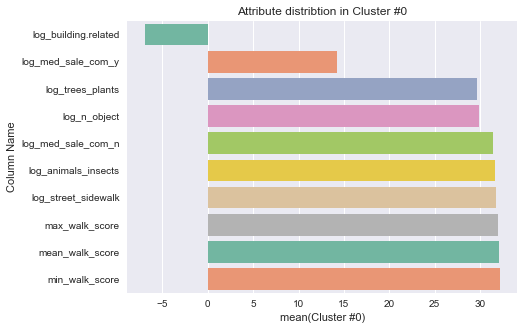

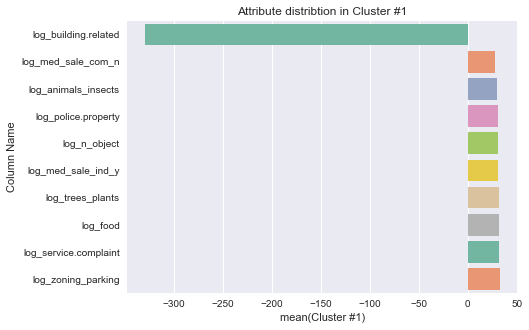

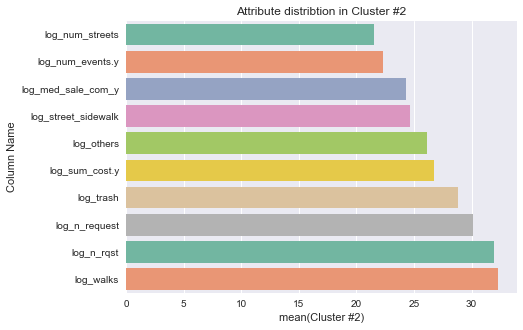

In [72]:
sns.set_style('whitegrid')
sns.set(rc={'figure.figsize':(7,5)})
for col in kmeans_cols:
    kmeans_weight_tbl.sort_values(by=[col],inplace=True)
    #sns.boxplot(y=col, x="index", data=kmeans_weight_tbl_plot,palette='rainbow')
    sns.barplot(y="Column Name", x=col, data=kmeans_weight_tbl.head(10),palette='Set2')
    #sns.barplot(x='sex',y='total_bill',data=tips)
    data_dir = 'C:/Users/Preeti/Github/CapstoneProject/unsupervised/plots/kmeans/'
    data_file_base = "Kmeans_by_cluster_bottom_10_in_"
    data_file_num = str(col)
    data_file_ext = ".png"
    plt_file_2_save = data_dir + data_file_base + data_file_num + data_file_ext
    plt.savefig(plt_file_2_save)
    plt.title("Attribute distribtion in "+col)
    plt.show()

In [ ]:
kmeans_weight_tbl.sort_values(by=['Cluster #0'],inplace=True, na_position='first')
kmeans_weight_tbl['Cluster #0'].head(5)

### Hierachical Clustering

In [183]:
# set required variables for model comparison

comparison_tbl = pd.DataFrame(columns = [
    'model_name',
    'n_clusters',
    'inertia',
    'silhouette',
    'process_time'])

i_index = []
i_index = 0

# preparation for cross validation and model comparison, each classifier is appended once model is fit

models = []

In [184]:
X_tsne = pd.DataFrame(columns=['t1', 't2'])
X_tsne['t1'] = df_join['x-tsne']
X_tsne['t2'] = df_join['y-tsne']

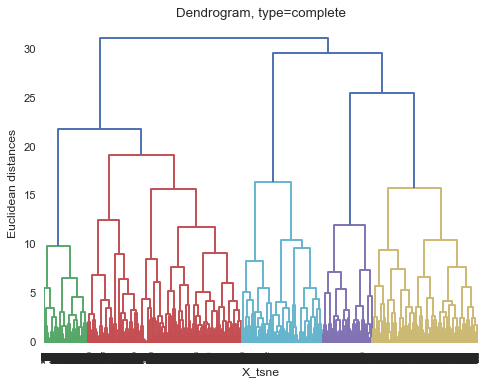

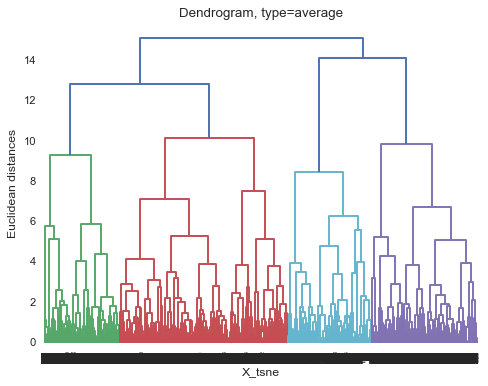

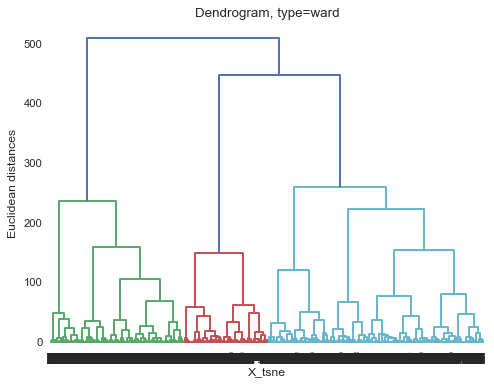

In [185]:
from scipy.cluster.hierarchy import dendrogram, linkage
import scipy.cluster.hierarchy as sch
from sklearn.cluster import AgglomerativeClustering

# Using the dendrogram to find the optimal number of clusters
dendrogram = sch.dendrogram(sch.linkage(X_tsne, method = 'complete'))
_ = plt.title('Dendrogram, type=complete')
_ = plt.xlabel('X_tsne')
_ = plt.ylabel('Euclidean distances')
plt.savefig("C:/Users/Preeti/Github/CapstoneProject/unsupervised/plots/hierarchical/dendrogram_complete.png")
_ = plt.show()


# Using the dendrogram to find the optimal number of clusters
dendrogram = sch.dendrogram(sch.linkage(X_tsne, method = 'average'))
_ = plt.title('Dendrogram, type=average')
_ = plt.xlabel('X_tsne')
_ = plt.ylabel('Euclidean distances')
plt.savefig("C:/Users/Preeti/Github/CapstoneProject/unsupervised/plots/hierarchical/dendrogram_average.png")
_ = plt.show()


# Using the dendrogram to find the optimal number of clusters
dendrogram = sch.dendrogram(sch.linkage(X_tsne, method = 'ward'))
_ = plt.title('Dendrogram, type=ward')
_ = plt.xlabel('X_tsne')
_ = plt.ylabel('Euclidean distances')
plt.savefig("C:/Users/Preeti/Github/CapstoneProject/unsupervised/plots/hierarchical/dendrogram_ward.png")
_ = plt.show()

In [186]:
n_optimal_cluster_ward = 3
n_optimal_cluster_average = 4
n_optimal_cluster_complete = 5

In [187]:
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... optimal models for linkage = ward
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

tic = time.clock()
hc_ward = AgglomerativeClustering(n_clusters = n_optimal_cluster_ward, affinity = 'euclidean', linkage = 'ward')
hc_ward.fit(X_tsne)

hc_labels_ward = hc_ward.labels_ # the labels from hierarchical clustering
#hc_centers = hc_lda.cluster_centers_

# hc_inertia = hc_lda.inertia_
#print ("inertia = ", hc_inertia)

hc_silhouette = metrics.silhouette_score(X_tsne,
                                             hc_labels_ward,
                                             metric = 'euclidean',
                                             sample_size = 10000)
print ("silhouette = ", hc_silhouette)

toc =  time.clock()

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - save statistics for model comparison
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

exe_time = '{0:.4f}'.format(toc-tic)

raw_data = {
'model_name' : 'hierarchical - ward',
'n_clusters' : n_optimal_cluster_ward,
'inertia': 'NA',
'silhouette': hc_silhouette, 
'process_time' : exe_time
}

df_tbl = pd.DataFrame(raw_data,
columns = ['model_name', 'n_clusters', 'inertia', 'silhouette', 'process_time'],
index = [i_index + 1])

comparison_tbl = comparison_tbl.append(df_tbl)

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='ward',
            memory=Memory(cachedir=None), n_clusters=3,
            pooling_func=<function mean at 0x000002051FDD2400>)

silhouette =  0.35602804709464314


In [98]:
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... optimal models for linkage = complete, #of clusters = 3
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

tic = time.clock()
hc_complete = AgglomerativeClustering(n_clusters = n_optimal_cluster_complete, affinity = 'euclidean', linkage = 'complete')
hc_complete.fit(X_tsne)

hc_labels_complete = hc_complete.labels_ # the labels from hierarchical clustering
#hc_centers = hc_lda.cluster_centers_

# hc_inertia = hc_lda.inertia_
#print ("inertia = ", hc_inertia)

hc_silhouette = metrics.silhouette_score(X_tsne,
                                             hc_labels_complete,
                                             metric = 'euclidean',
                                             sample_size = 10000)
print ("silhouette = ", hc_silhouette)

toc =  time.clock()

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - save statistics for model comparison
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

exe_time = '{0:.4f}'.format(toc-tic)

raw_data = {
'model_name' : 'hierarchical - complete',
'n_clusters' : n_optimal_cluster_complete,
'inertia': 'NA',
'silhouette': hc_silhouette, 
'process_time' : exe_time
}

df_tbl = pd.DataFrame(raw_data,
columns = ['model_name', 'n_clusters', 'inertia', 'silhouette', 'process_time'],
index = [i_index + 1])

comparison_tbl = comparison_tbl.append(df_tbl)

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='complete',
            memory=Memory(cachedir=None), n_clusters=4,
            pooling_func=<function mean at 0x000002051FDD2400>)

silhouette =  0.32745132847812025


In [99]:
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... optimal models for linkage = average #of clusters = 4
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

tic = time.clock()
hc_average = AgglomerativeClustering(n_clusters = n_optimal_cluster_average, affinity = 'euclidean', linkage = 'average')
hc_average.fit(X_tsne)

hc_labels_average = hc_average.labels_ # the labels from hierarchical clustering
#hc_centers = hc_lda.cluster_centers_

# hc_inertia = hc_lda.inertia_
#print ("inertia = ", hc_inertia)

hc_silhouette = metrics.silhouette_score(X_tsne,
                                             hc_labels_average,
                                             metric = 'euclidean',
                                             sample_size = 10000)
print ("silhouette = ", hc_silhouette)

toc =  time.clock()

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - save statistics for model comparison
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

exe_time = '{0:.4f}'.format(toc-tic)

raw_data = {
'model_name' : 'hierarchical - average',
'n_clusters' : n_optimal_cluster_average,
'inertia': 'NA',
'silhouette': hc_silhouette, 
'process_time' : exe_time
}

df_tbl = pd.DataFrame(raw_data,
columns = ['model_name', 'n_clusters', 'inertia', 'silhouette', 'process_time'],
index = [i_index + 1])

comparison_tbl = comparison_tbl.append(df_tbl)

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='average',
            memory=Memory(cachedir=None), n_clusters=4,
            pooling_func=<function mean at 0x000002051FDD2400>)

silhouette =  0.31637989538044176


In [188]:
comparison_tbl = comparison_tbl.reset_index(drop=True)
comparison_tbl['process_time'] = pd.to_numeric(comparison_tbl['process_time'])
comparison_tbl

,model_name,n_clusters,inertia,silhouette,process_time
0,hierarchical - ward,3,NA,0.356028,1.7107


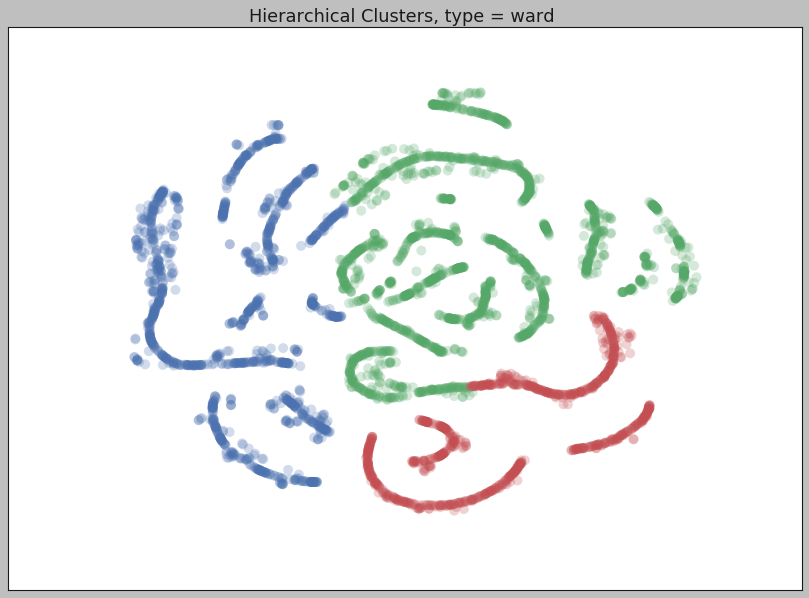

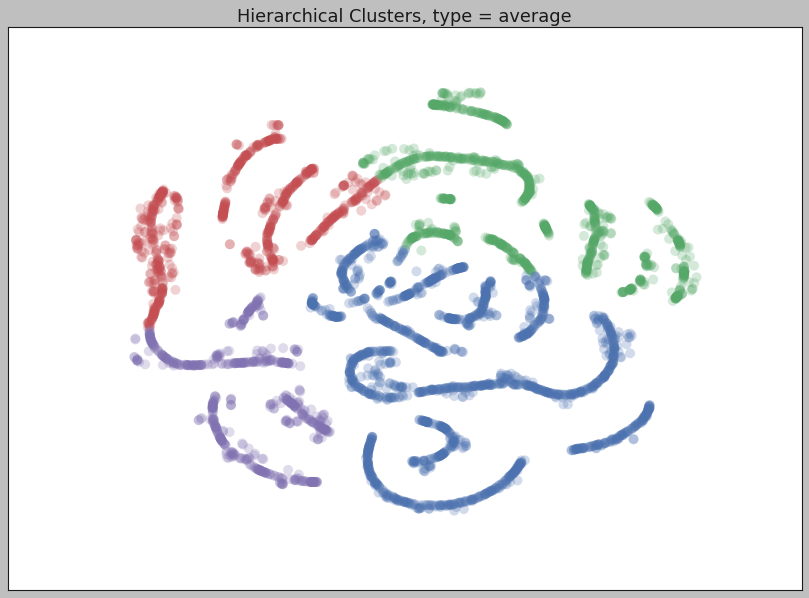

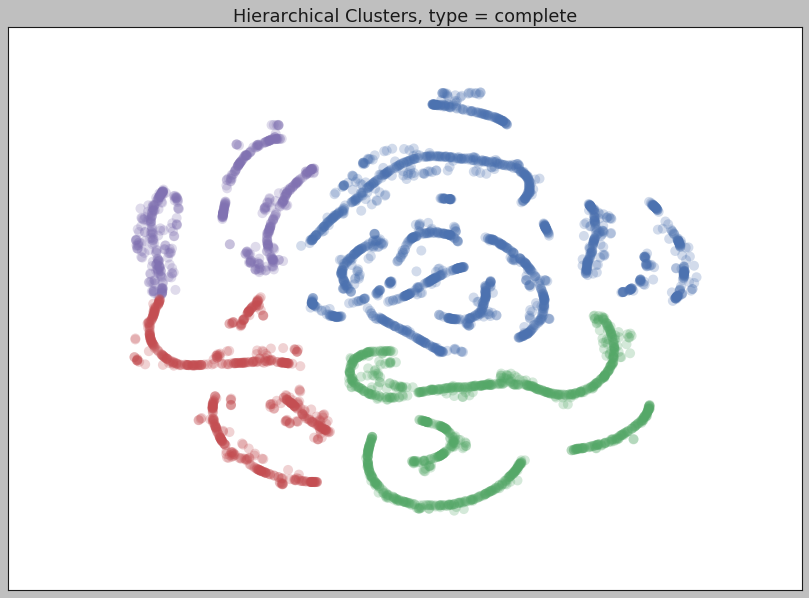

In [101]:
sns.set_context('poster')
sns.set_color_codes()
plot_kwds = {'alpha' : 0.25, 's' : 80, 'linewidths':0}


palette = sns.color_palette('deep', np.unique(hc_labels_ward).max() + 1)
colors = [palette[x] if x >= 0 else (0.0, 0.0, 0.0) for x in hc_labels_ward]
X_tsne_values = X_tsne.values;
_= plt.scatter(X_tsne_values[:, 0], X_tsne_values[:, 1], c=colors, **plot_kwds)
frame = plt.gca()
frame.axes.get_xaxis().set_visible(False)
frame.axes.get_yaxis().set_visible(False)
_= plt.title('Hierarchical Clusters, type = ward ' , fontsize=16)
_ = plt.xlabel("X_tsne");
_ = plt.ylabel("y_tsne");
plt.savefig("C:/Users/Preeti/Github/CapstoneProject/unsupervised/plots/hierarchical/hc_ward_eval.png")
_=plt.show()

palette = sns.color_palette('deep', np.unique(hc_labels_average).max() + 1)
colors = [palette[x] if x >= 0 else (0.0, 0.0, 0.0) for x in hc_labels_average]
X_tsne_values = X_tsne.values;
_= plt.scatter(X_tsne_values[:, 0], X_tsne_values[:, 1], c=colors, **plot_kwds)
frame = plt.gca()
frame.axes.get_xaxis().set_visible(False)
frame.axes.get_yaxis().set_visible(False)
_= plt.title('Hierarchical Clusters, type = average' , fontsize=16)
plt.savefig("C:/Users/Preeti/Github/CapstoneProject/unsupervised/plots/hierarchical/hc_average_eval.png")
_=plt.show()

palette = sns.color_palette('deep', np.unique(hc_labels_complete).max() + 1)
colors = [palette[x] if x >= 0 else (0.0, 0.0, 0.0) for x in hc_labels_complete]
X_tsne_values = X_tsne.values;
_= plt.scatter(X_tsne_values[:, 0], X_tsne_values[:, 1], c=colors, **plot_kwds)
frame = plt.gca()
frame.axes.get_xaxis().set_visible(False)
frame.axes.get_yaxis().set_visible(False)
_= plt.title('Hierarchical Clusters, type = complete' , fontsize=16)
plt.savefig("C:/Users/Preeti/Github/CapstoneProject/unsupervised/plots/hierarchical/hc_complete_eval.png")
_=plt.show()


In [189]:
X_all_together['hierarchical'] = hc_labels_ward

In [191]:
X_all_together.drop(['kmeans_2', 'kmeans_3',
       'kmeans_4', 'kmeans_5', 'kmeans_6', 'kmeans_7', 'kmeans_8', 'kmeans_9',
       'kmeans_10', 'kmeans_11'],axis=1,inplace=True)
X_all_together.columns

Index(['x-tsne', 'y-tsne', 'cell_id', 'min_walk_score', 'max_walk_score',
       'mean_walk_score', 'med_sale_pbo_n', 'log_sum_cost_pedestrian_events',
       'log_num_near_misses', 'log_n_rqst', 'log_access', 'log_dblprk',
       'log_dnotyld', 'log_jywalk', 'log_lvisib', 'log_lwfws', 'log_nobikef',
       'log_noswlk', 'log_other', 'log_prkint', 'log_prkswlk', 'log_speed',
       'log_vrrlss', 'log_wlksig', 'log_xwalk', 'log_assist', 'log_bikes',
       'log_drives', 'log_other.1', 'log_walks', 'log_num_walk_scores',
       'log_sum_lane_cnt', 'log_sum_width', 'log_sum_area', 'log_num_streets',
       'log_num_fire_incd', 'log_med_sale_res_y', 'log_med_sale_res_n',
       'log_med_sale_com_y', 'log_med_sale_com_n', 'log_med_sale_ind_y',
       'log_med_sale_ind_n', 'log_med_sale_pbo_y', 'log_sum_cost.y',
       'log_num_events.y', 'log_dist', 'log_n_object', 'log_animals_insects',
       'log_building.related', 'log_construction', 'log_food', 'log_others',
       'log_police.property

In [192]:
X_all_together.head()

,x-tsne,y-tsne,cell_id,min_walk_score,max_walk_score,mean_walk_score,med_sale_pbo_n,log_sum_cost_pedestrian_events,log_num_near_misses,log_n_rqst,...,log_service.complaint,log_street_sidewalk,log_traffic_sig0l,log_trash,log_trees_plants,log_water.leak,log_zoning_parking,log_n_request,kmeans_labels,hierarchical
sample_index,,,,,,,,,,,,,,,,,,,,,
1,2.594388,-5.441451,20012,44,48,46.0,0,-4.605170,-4.60517,-4.60517,...,0.009950,3.663818,0.00995,5.645482,1.611436,-4.60517,1.611436,6.059147,2,0
2,-4.255144,1.367073,20013,44,48,46.0,0,-4.605170,-4.60517,-4.60517,...,0.009950,1.101940,-4.60517,3.178470,0.009950,-4.60517,-4.605170,3.367641,0,0
3,-4.305577,-11.240384,20015,44,48,46.0,0,-1.158362,-4.60517,-4.60517,...,-4.605170,-4.605170,0.00995,-4.605170,-4.605170,-4.60517,-4.605170,1.101940,0,0
4,-8.112213,-9.972811,20016,44,48,46.0,0,-4.605170,-4.60517,-4.60517,...,-4.605170,0.009950,-4.60517,-4.605170,-4.605170,-4.60517,-4.605170,1.101940,0,0
5,9.348014,3.819240,20019,13,13,13.0,0,-4.605170,-4.60517,-4.60517,...,1.388791,0.009950,-4.60517,3.713816,0.009950,-4.60517,-4.605170,3.850360,2,2


In [193]:
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... optimal models for linkage = ward
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

tic = time.clock()
hc_ward = AgglomerativeClustering(n_clusters = n_optimal_cluster_ward, affinity = 'euclidean', linkage = 'ward')
hc_ward.fit(X_tsne)

hc_labels_ward = hc_ward.labels_ # the labels from hierarchical clustering
#hc_centers = hc_lda.cluster_centers_

# hc_inertia = hc_lda.inertia_
#print ("inertia = ", hc_inertia)

hc_silhouette = metrics.silhouette_score(X_tsne,
                                             hc_labels_ward,
                                             metric = 'euclidean',
                                             sample_size = 10000)
print ("silhouette = ", hc_silhouette)

toc =  time.clock()

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - save statistics for model comparison
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

exe_time = '{0:.4f}'.format(toc-tic)

raw_data = {
'model_name' : 'hierarchical - ward',
'n_clusters' : n_optimal_cluster_ward,
'inertia': 'NA',
'silhouette': hc_silhouette, 
'process_time' : exe_time
}

df_tbl = pd.DataFrame(raw_data,
columns = ['model_name', 'n_clusters', 'inertia', 'silhouette', 'process_time'],
index = [i_index + 1])

comparison_tbl = comparison_tbl.append(df_tbl)

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='ward',
            memory=Memory(cachedir=None), n_clusters=3,
            pooling_func=<function mean at 0x000002051FDD2400>)

silhouette =  0.35602804709464314


In [194]:
#hc_labels = ['hc_labels_ward','hc_labels_average','hc_labels_complete']
#for labels in hc_labels:
X_all_together['hierarchical'] = hc_labels_ward
hc_labels_centers_x = X_all_together.groupby(['hierarchical'])['x-tsne'].mean()
hc_labels_centers_y= X_all_together.groupby(['hierarchical'])['y-tsne'].mean()
print("hc_labels_centers_x\n",hc_labels_centers_x)
print("hc_labels_centers_y\n",hc_labels_centers_y)
n_lda = np.unique(hc_labels_ward).max() +1
n_lda

#### feature importance for complete method

X_label_analysis = copy.deepcopy(X_all_together)
del X_label_analysis['x-tsne']
del X_label_analysis['y-tsne']
#del X_HC_average_analysis['sample_index']

grouped = X_label_analysis.groupby(['hierarchical'])
#print(grouped)

X_label_analysis = (grouped.mean() - X_label_analysis.mean()) / X_label_analysis.std()

hc_labels_centers_x
 hierarchical
0    -2.482160
1    -3.229619
2    10.084686
Name: x-tsne, dtype: float64
hc_labels_centers_y
 hierarchical
0   -4.472626
1    7.841539
2   -0.766090
Name: y-tsne, dtype: float64


3

*************************  min_walk_score


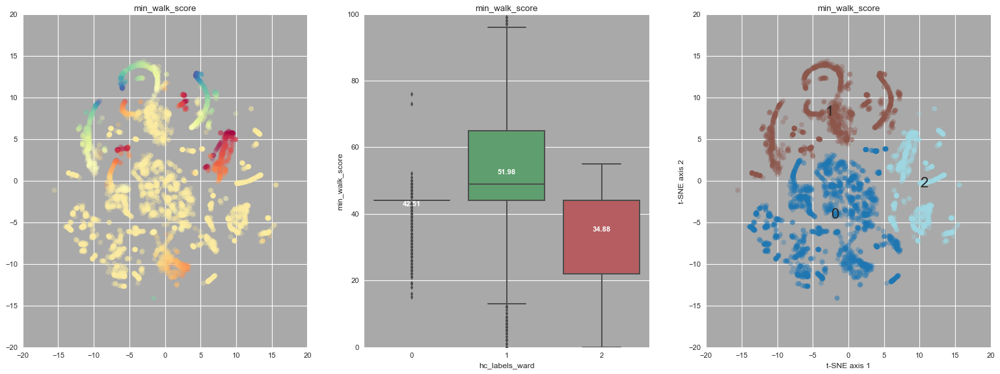

*************************  max_walk_score


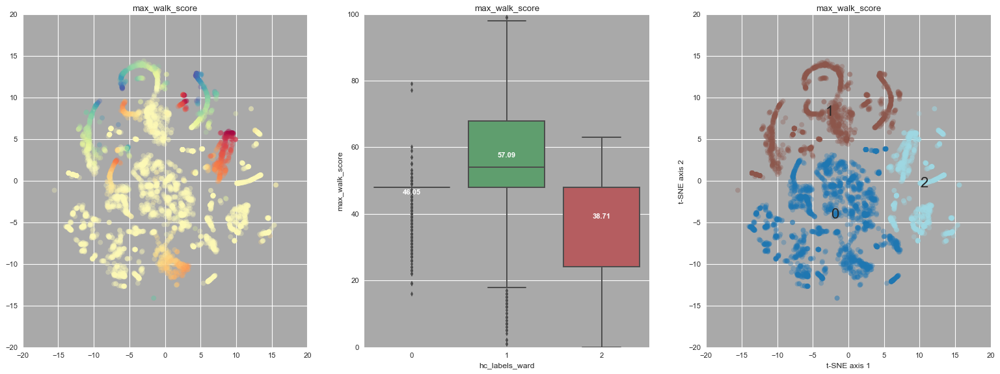

*************************  mean_walk_score


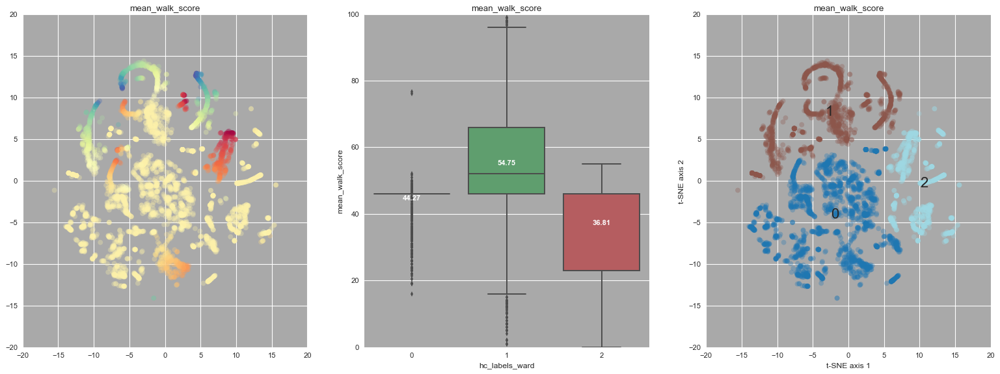

*************************  med_sale_pbo_n


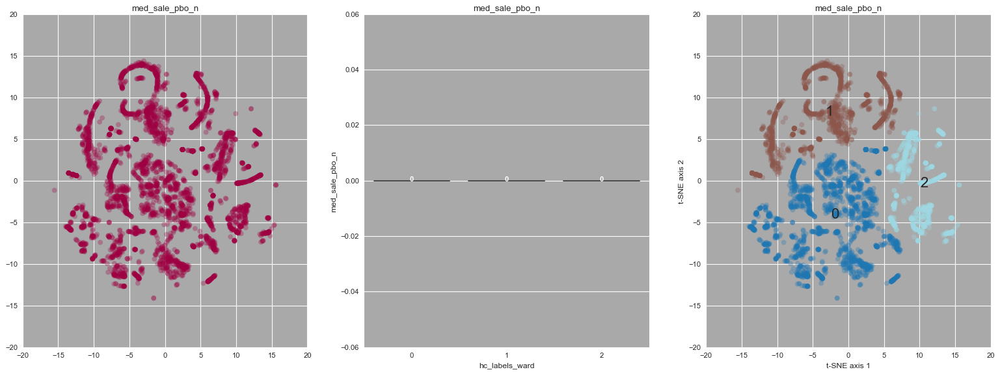

*************************  log_sum_cost_pedestrian_events


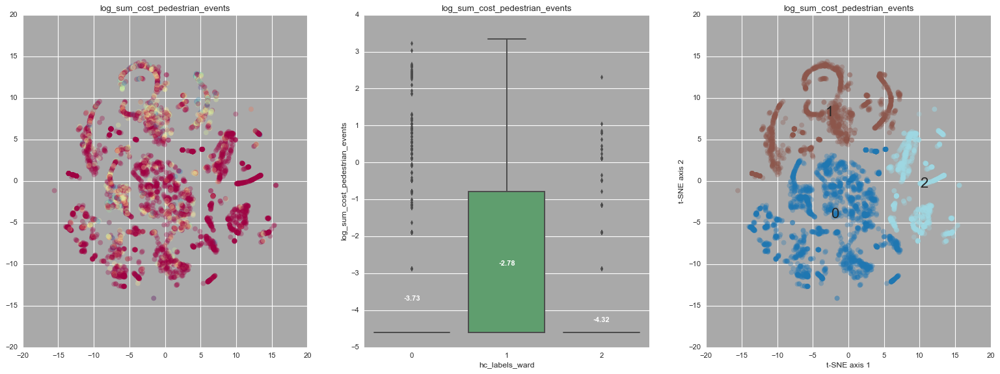

*************************  log_num_near_misses


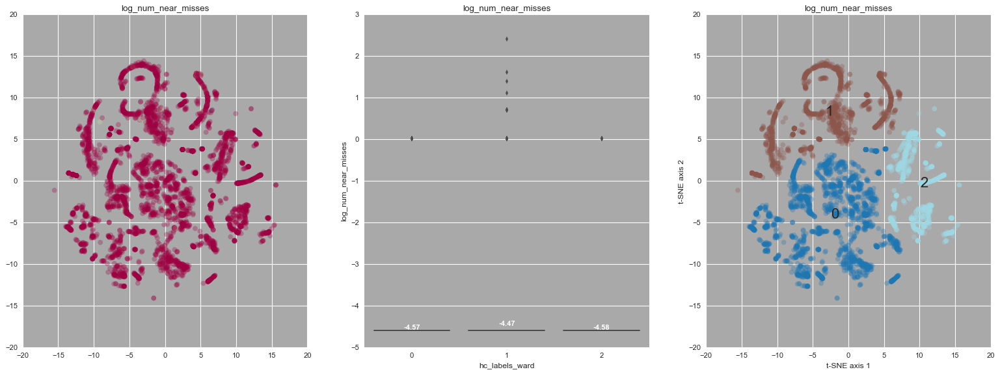

*************************  log_n_rqst


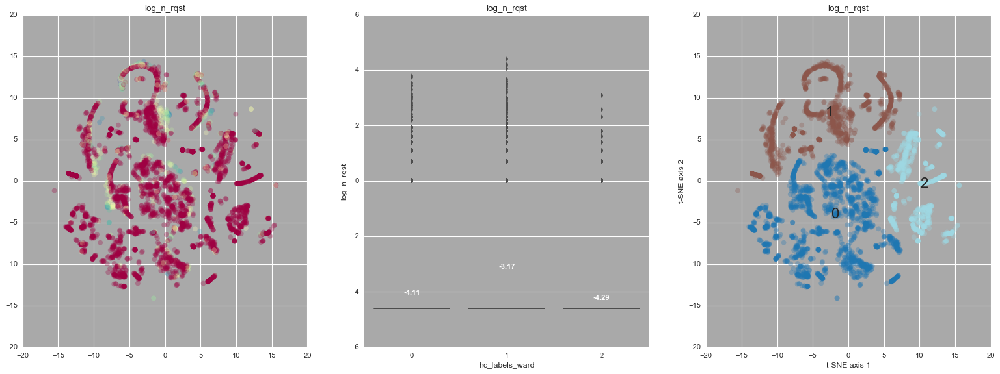

*************************  log_access


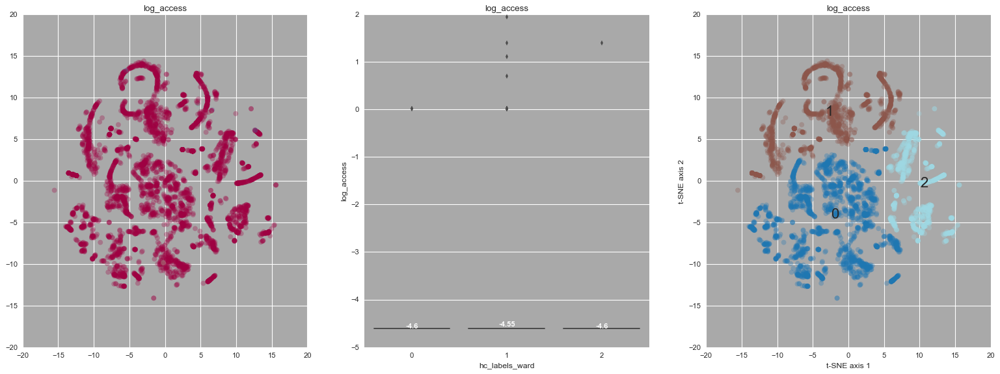

*************************  log_dblprk


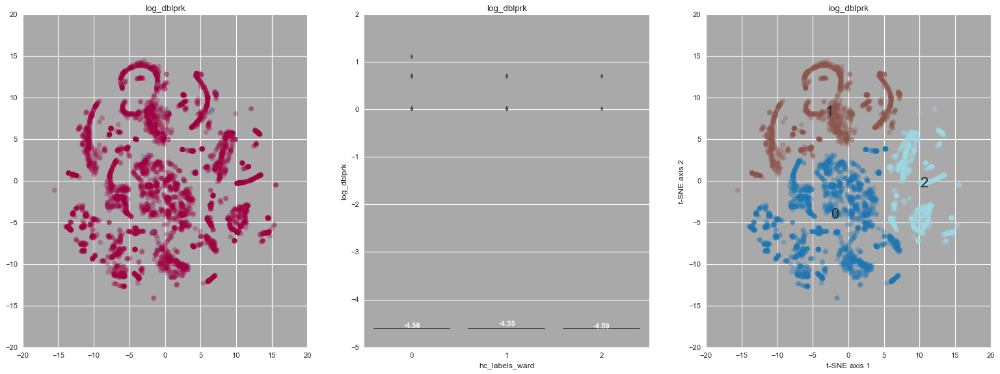

*************************  log_dnotyld


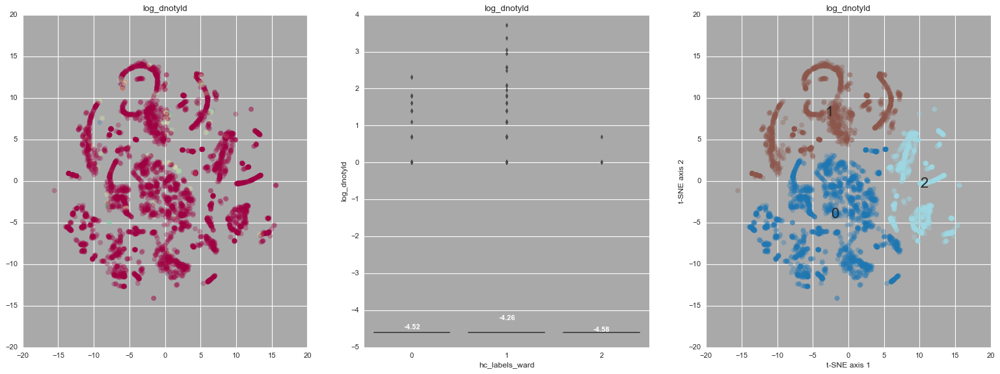

*************************  log_jywalk


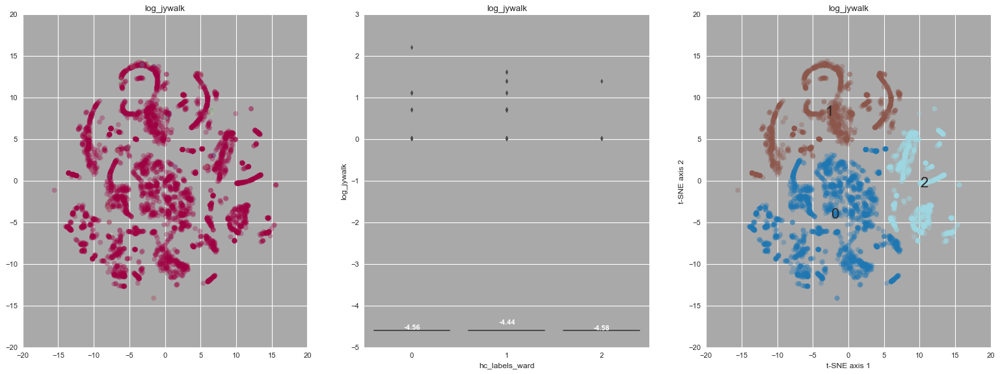

*************************  log_lvisib


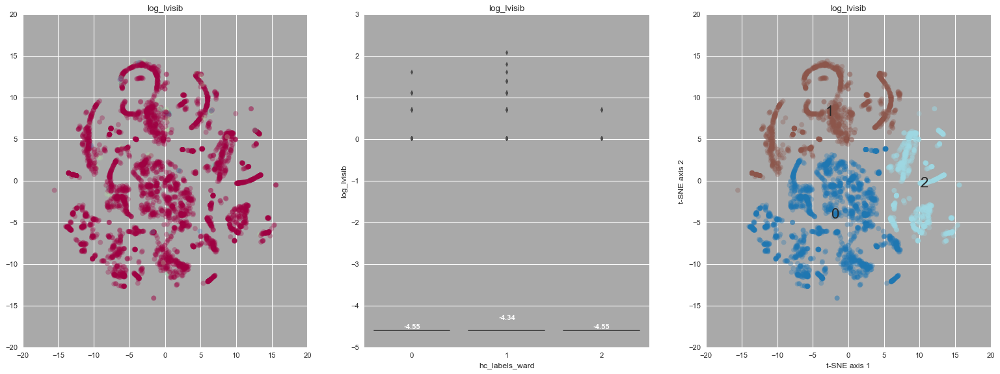

*************************  log_lwfws


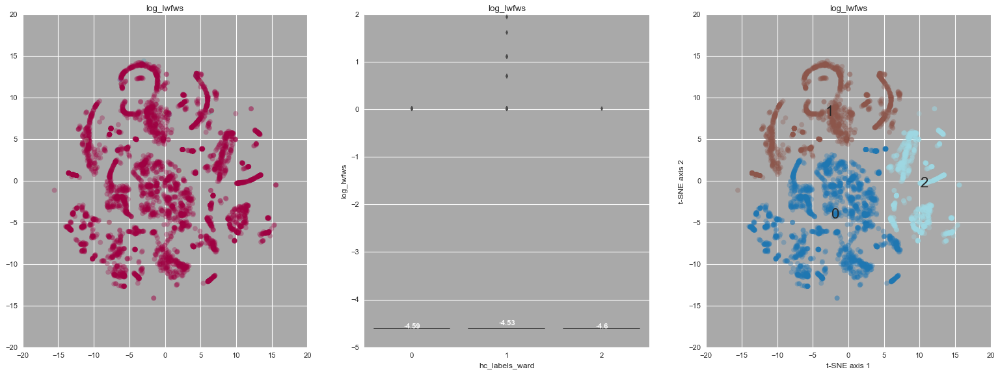

*************************  log_nobikef


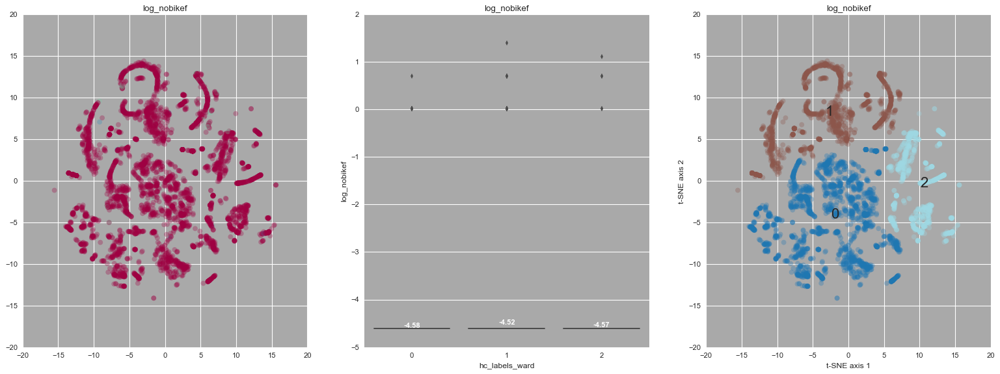

*************************  log_noswlk


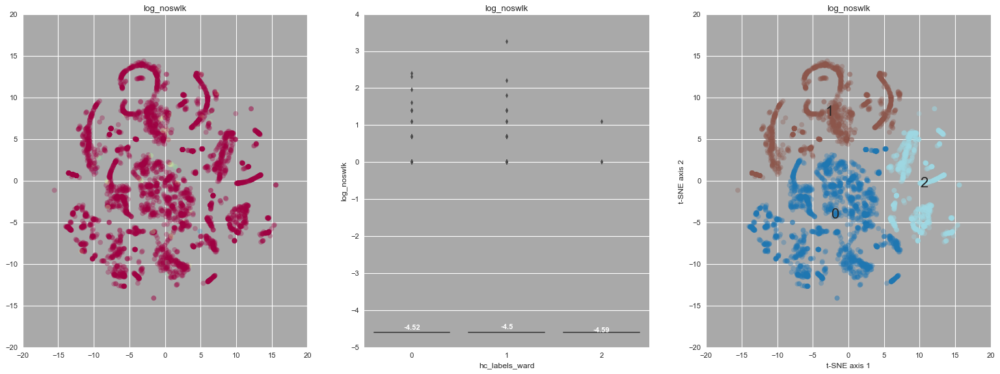

*************************  log_other


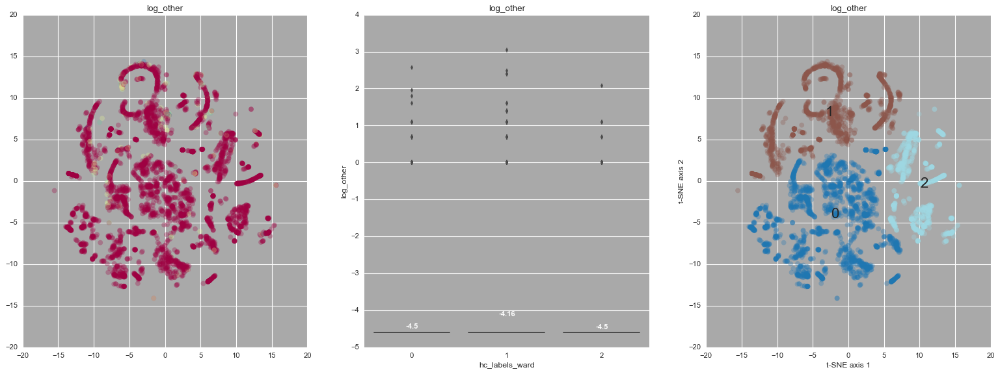

*************************  log_prkint


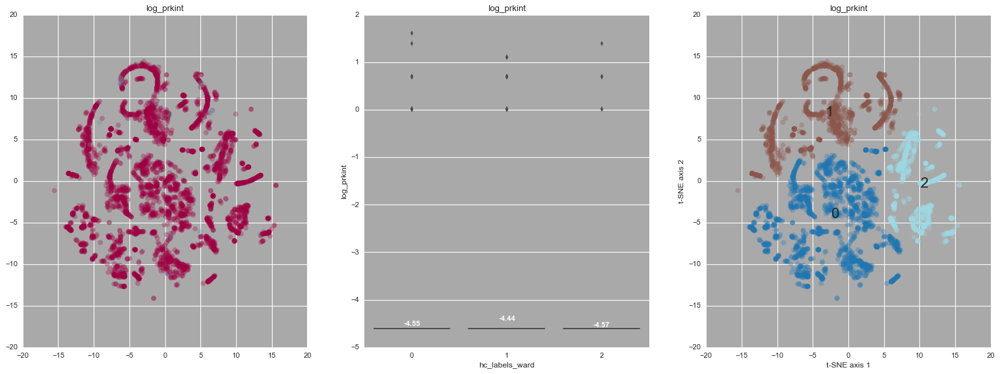

*************************  log_prkswlk


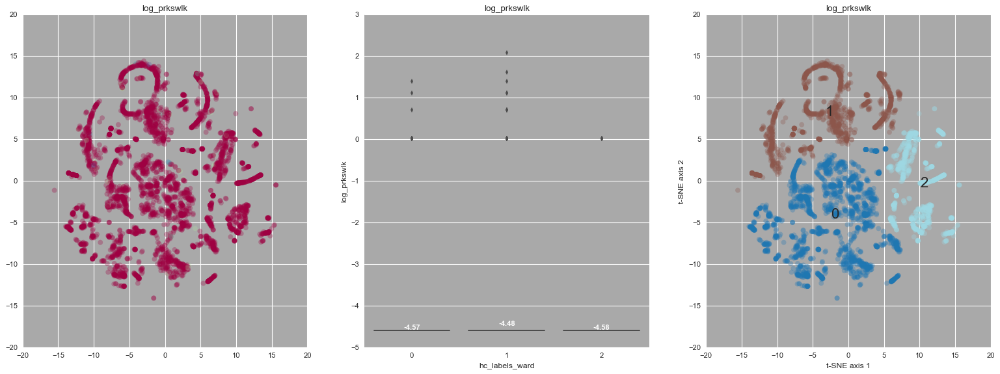

*************************  log_speed


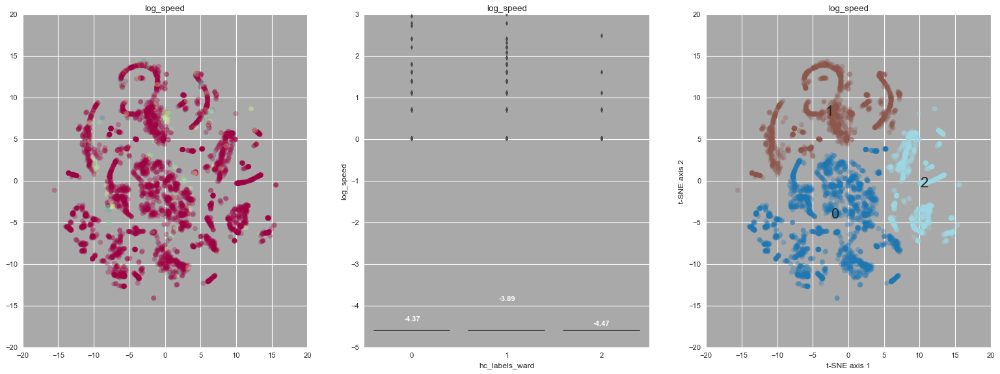

*************************  log_vrrlss


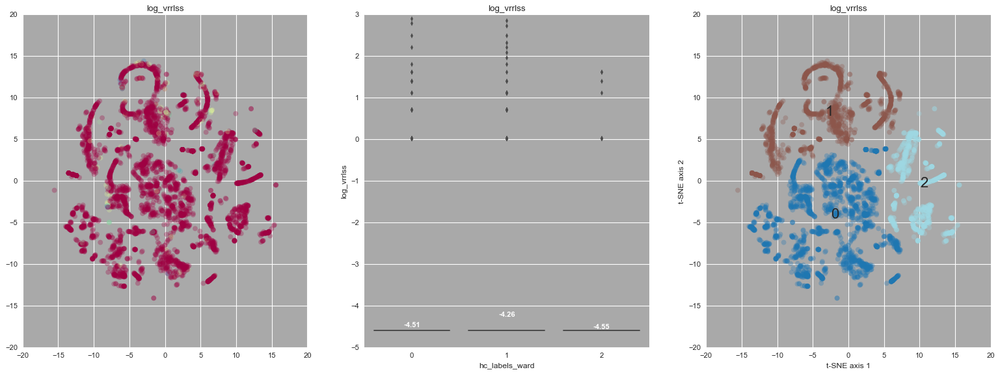

*************************  log_wlksig


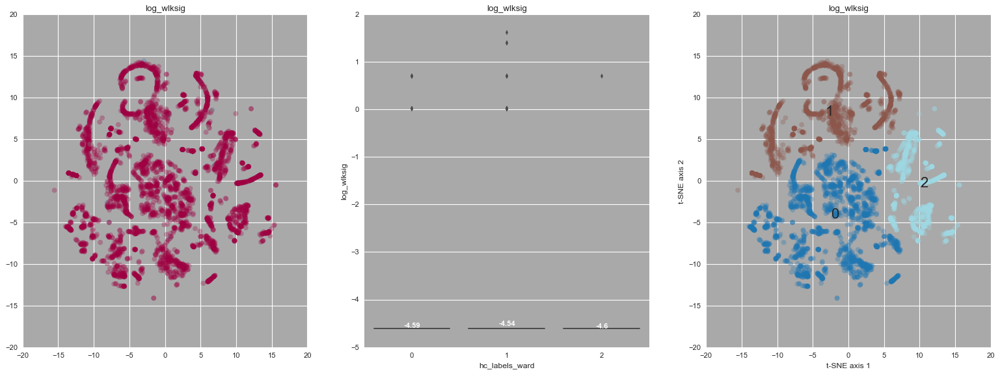

*************************  log_xwalk


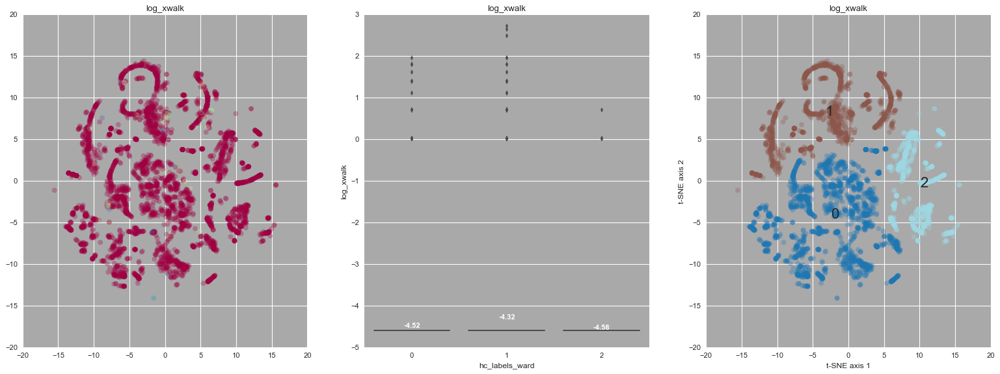

*************************  log_assist


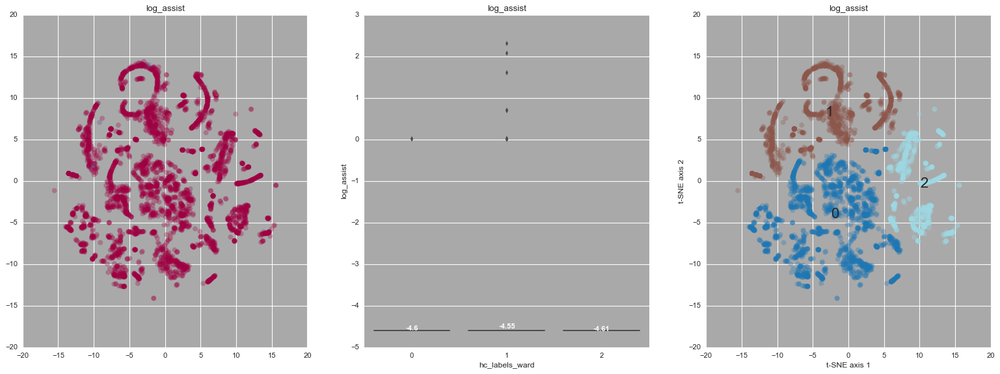

*************************  log_bikes


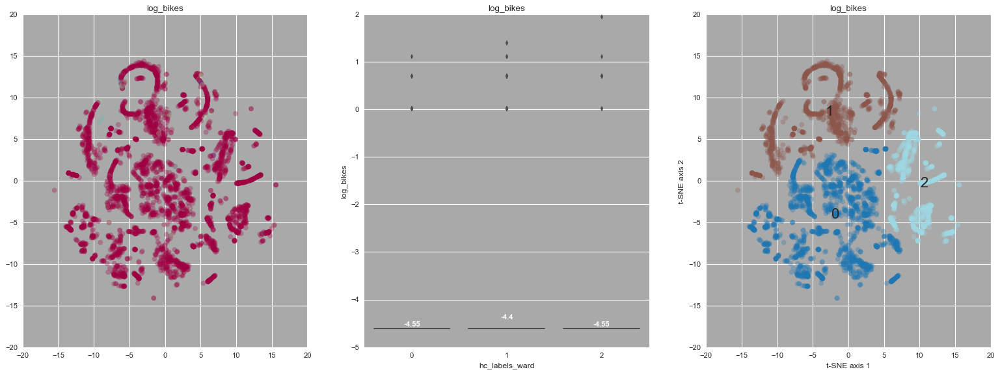

*************************  log_drives


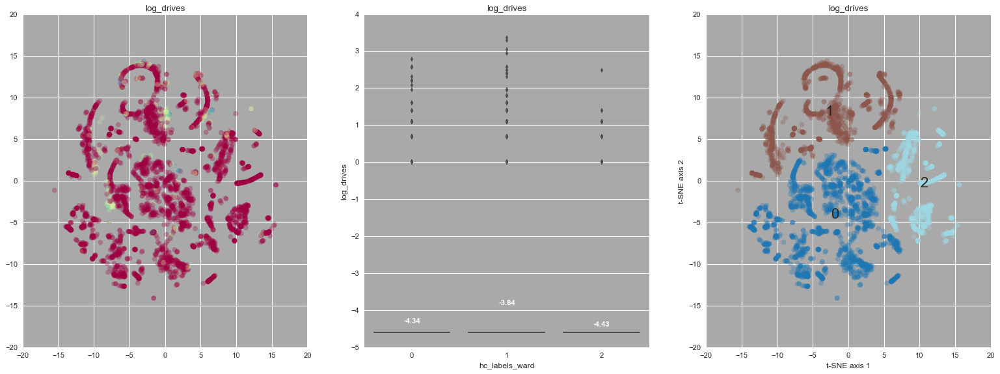

*************************  log_other.1


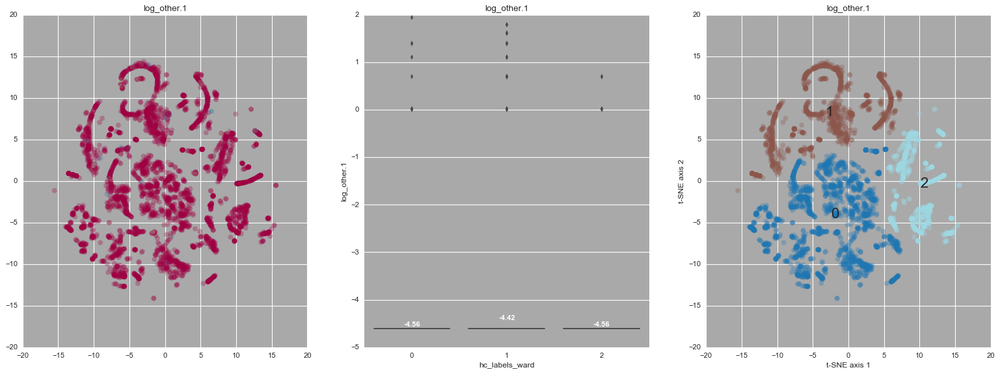

*************************  log_walks


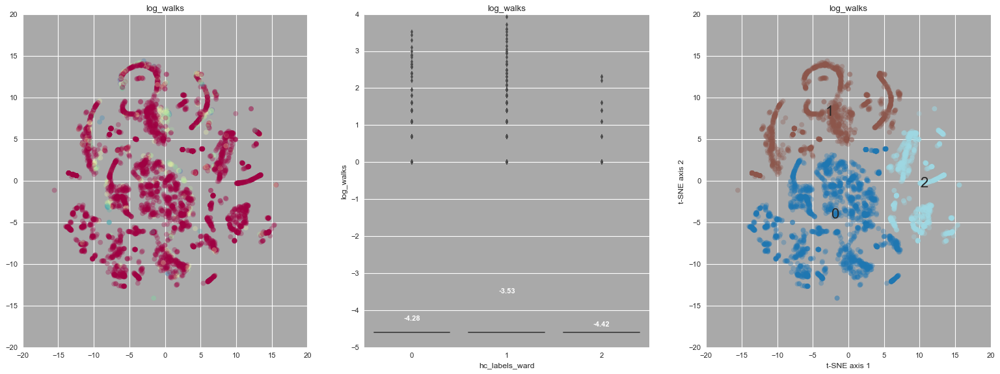

*************************  log_num_walk_scores


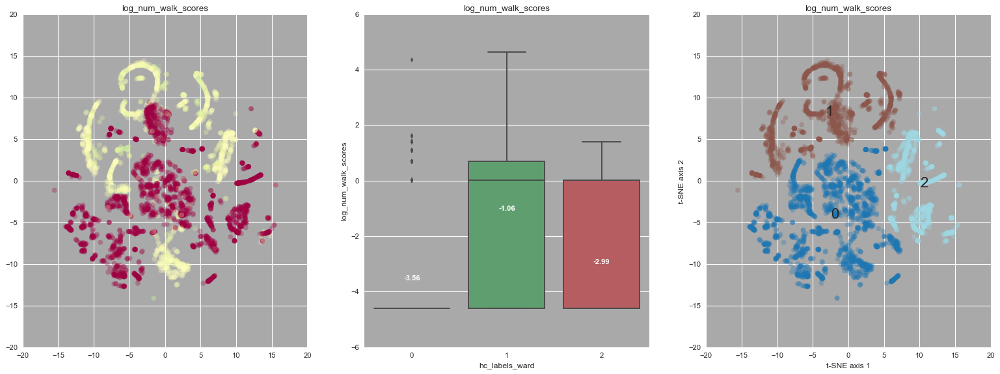

*************************  log_sum_lane_cnt


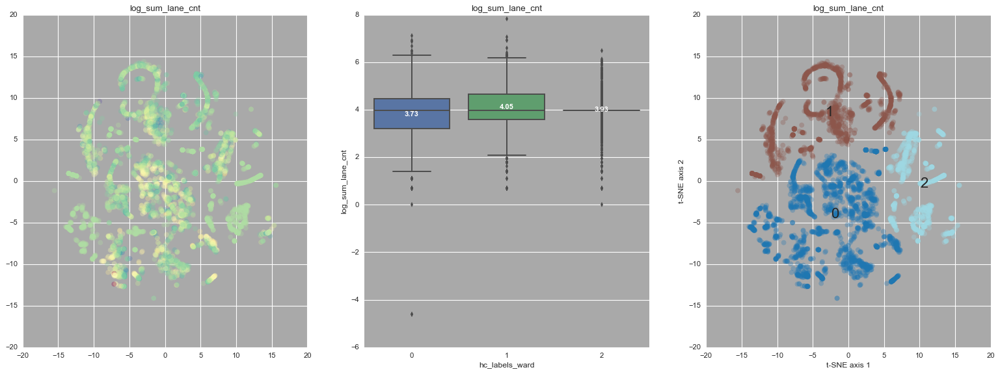

*************************  log_sum_width


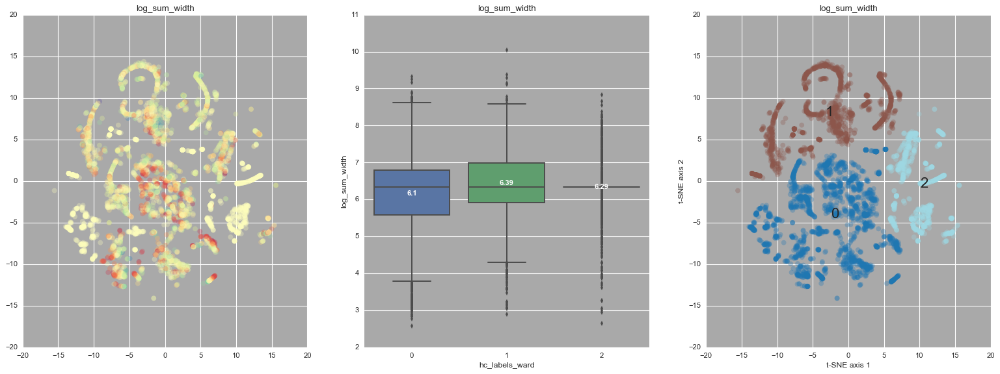

*************************  log_sum_area


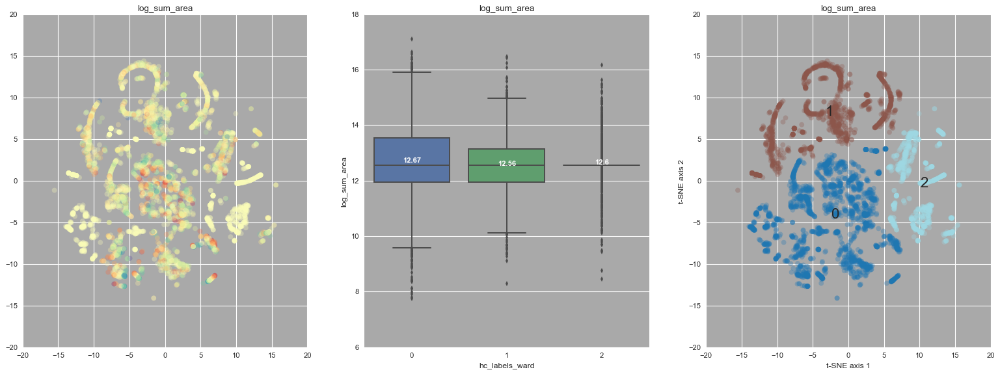

*************************  log_num_streets


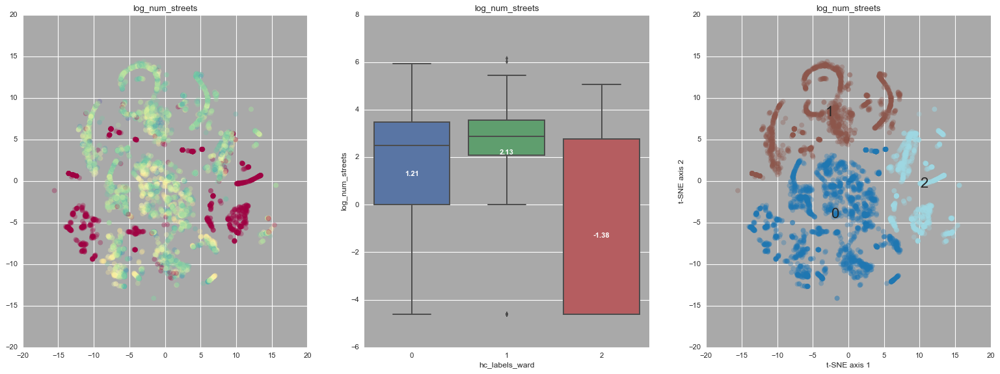

*************************  log_num_fire_incd


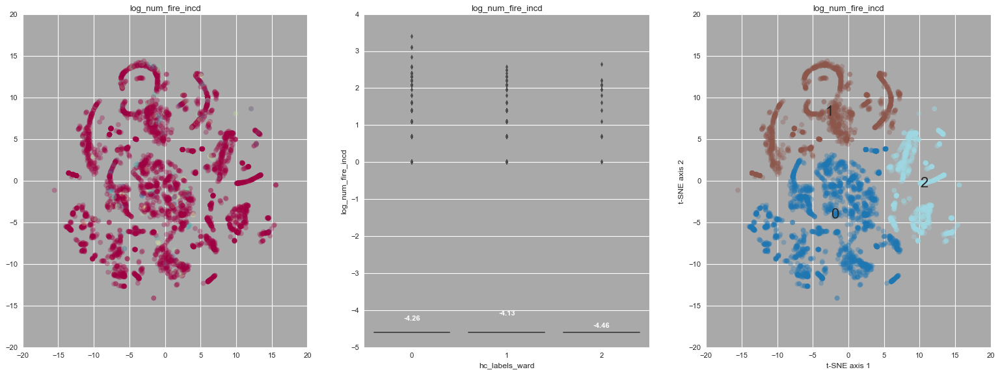

*************************  log_med_sale_res_y


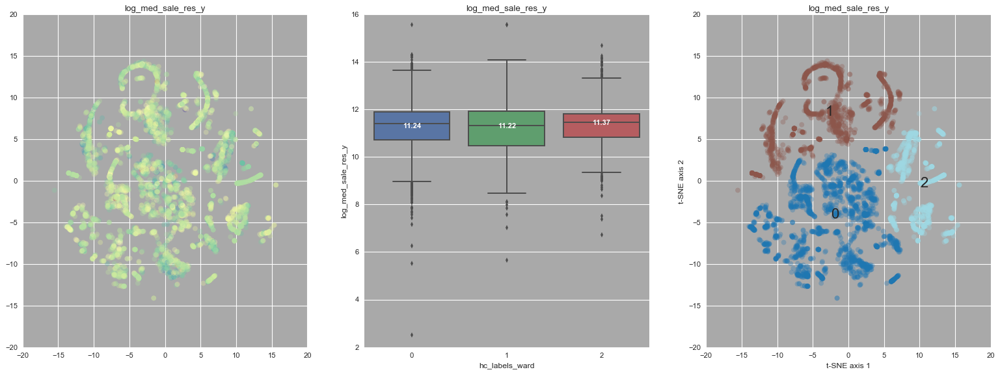

*************************  log_med_sale_res_n


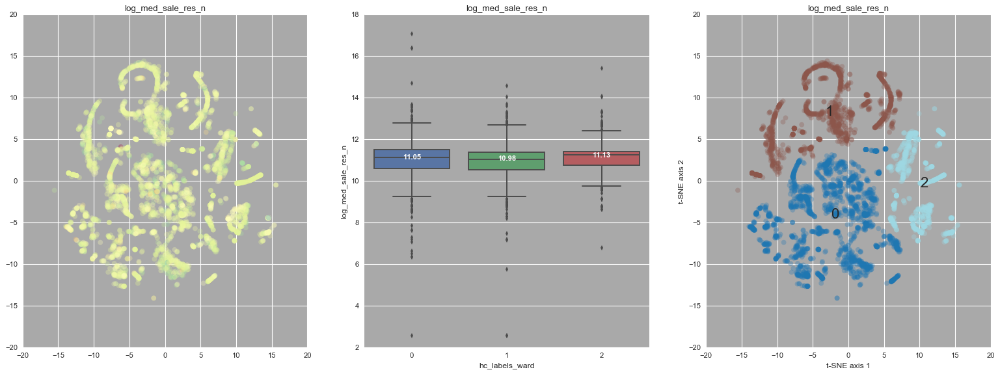

*************************  log_med_sale_com_y


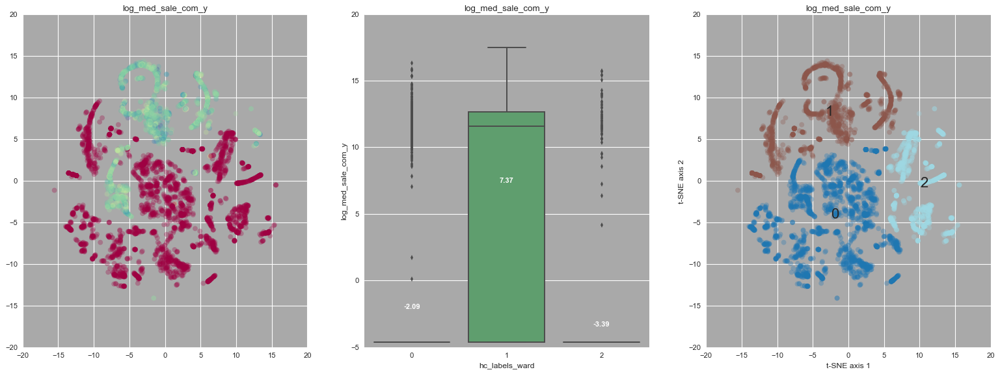

*************************  log_med_sale_com_n


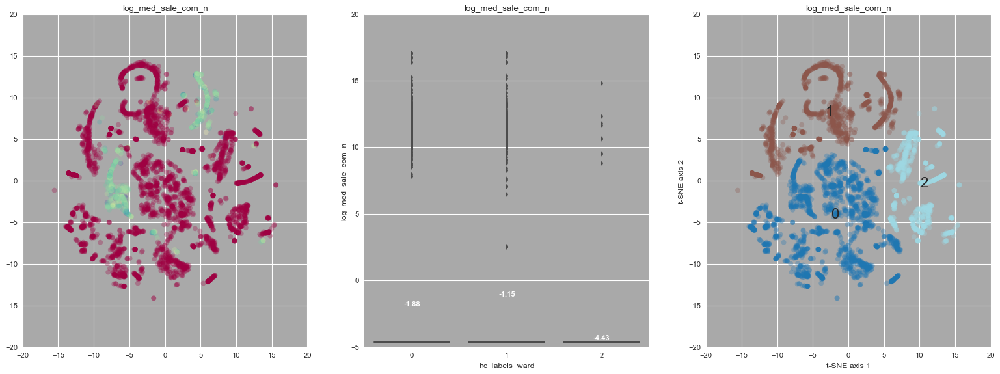

*************************  log_med_sale_ind_y


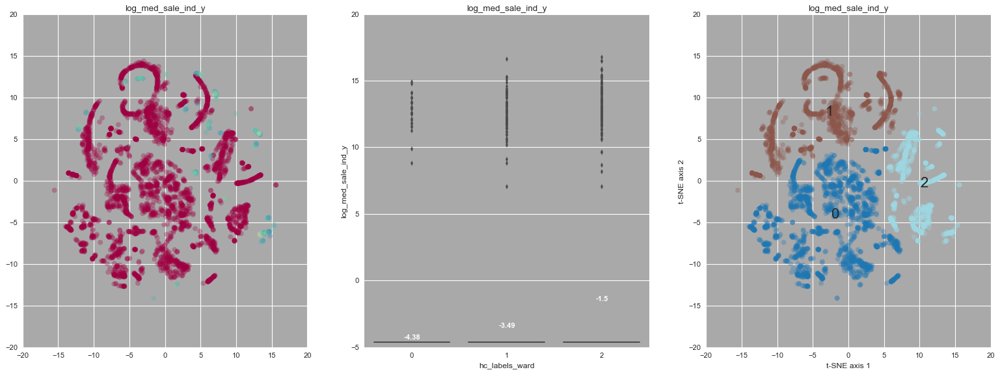

*************************  log_med_sale_ind_n


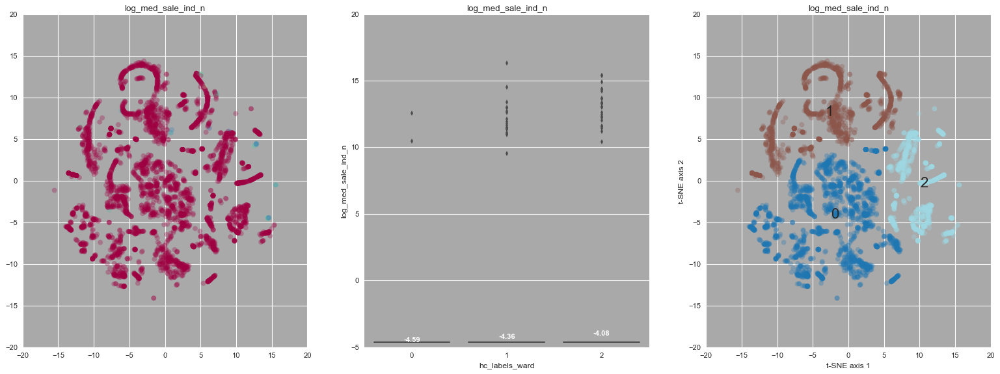

*************************  log_med_sale_pbo_y


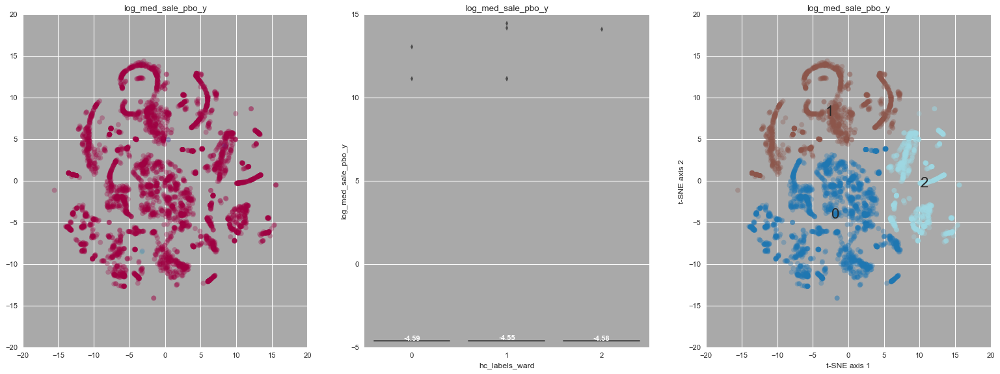

*************************  log_sum_cost.y


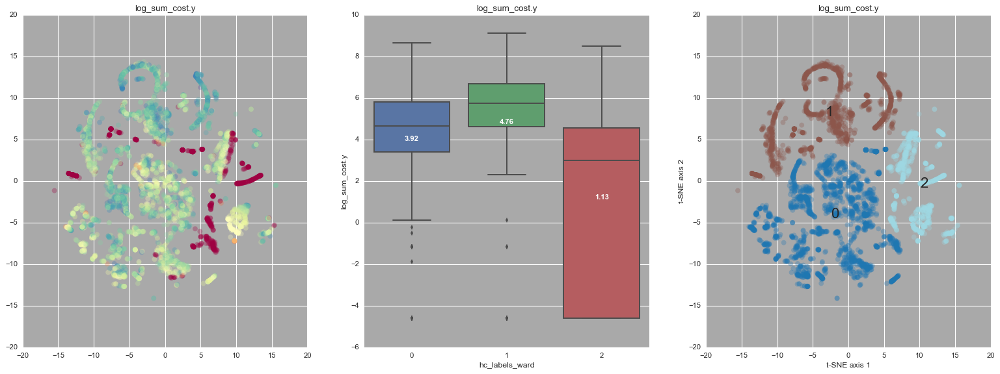

*************************  log_num_events.y


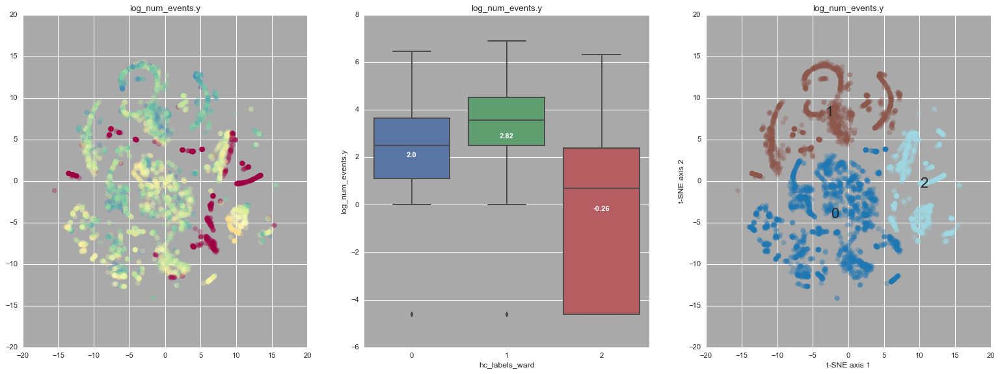

*************************  log_dist


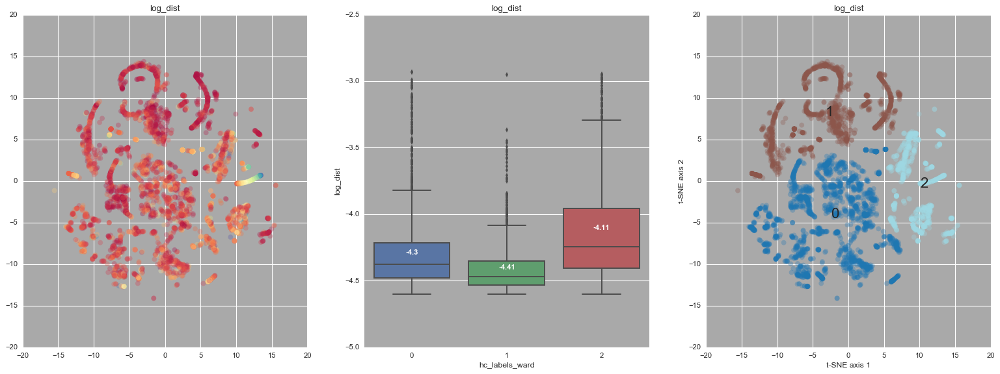

*************************  log_n_object


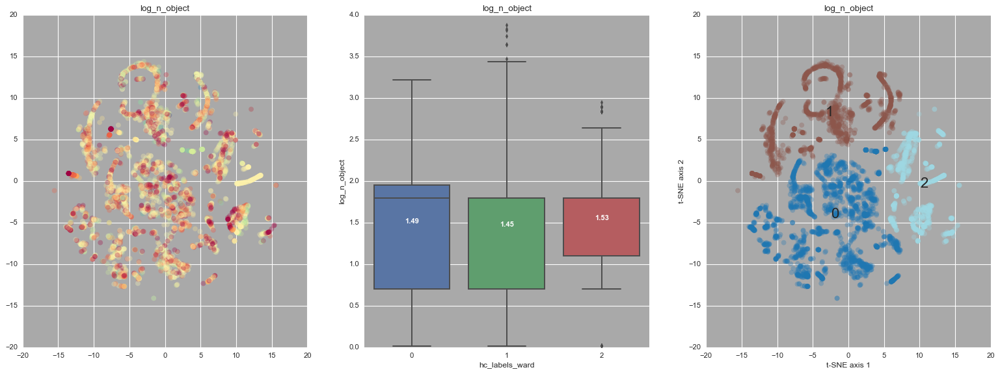

*************************  log_animals_insects


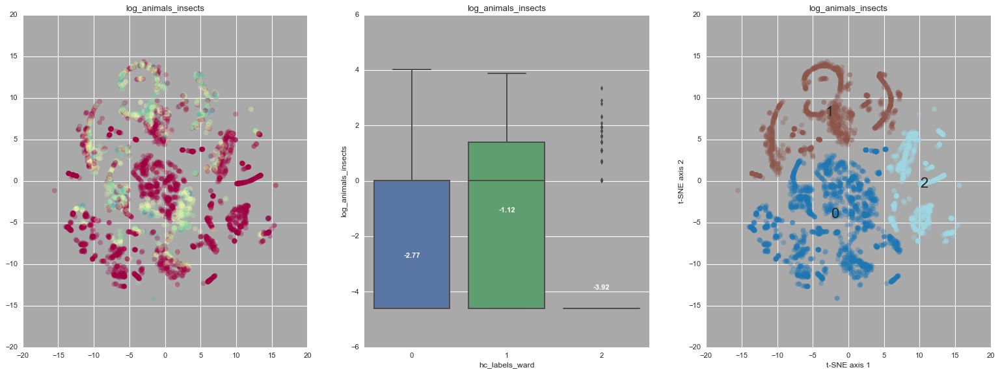

*************************  log_building.related


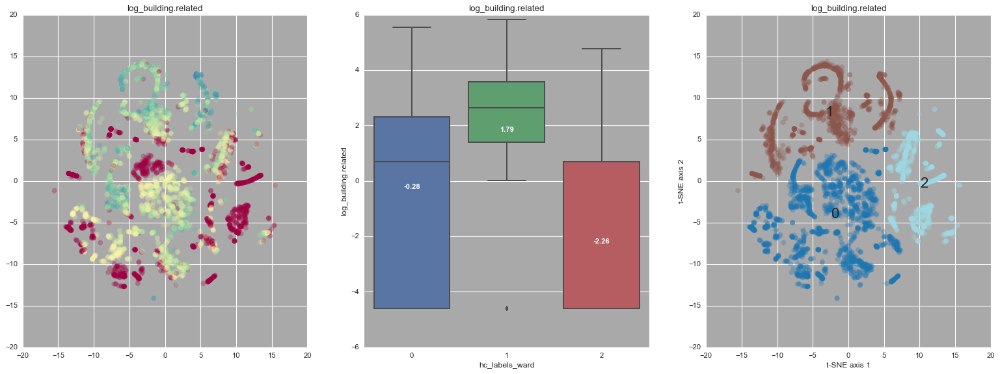

*************************  log_construction


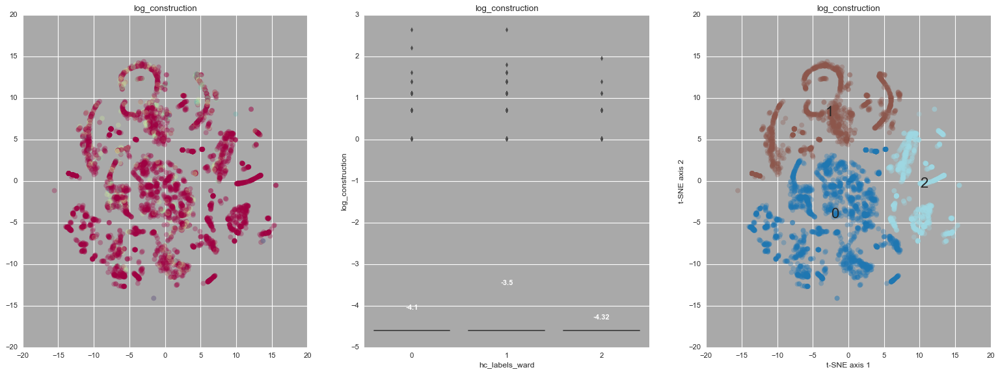

*************************  log_food


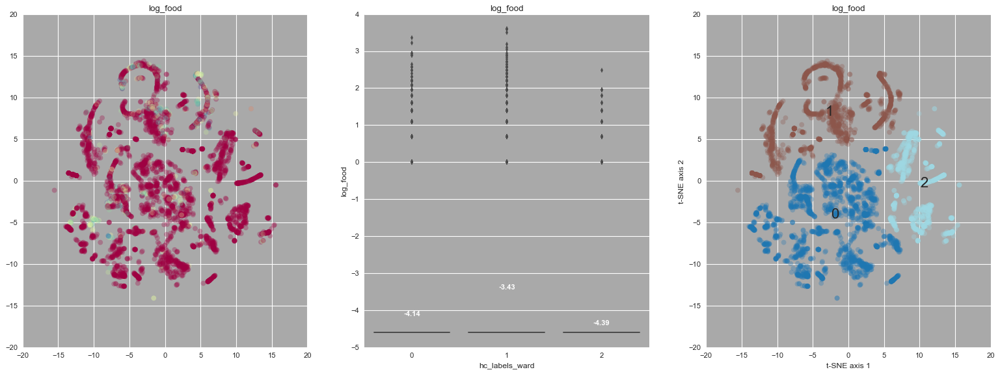

*************************  log_others


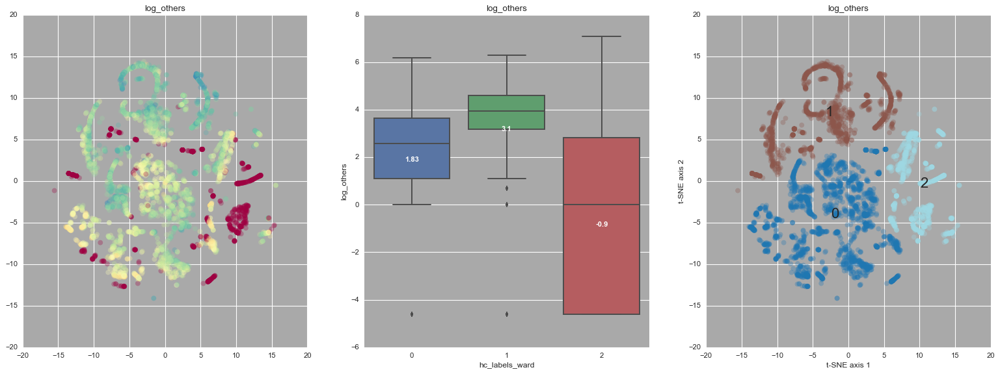

*************************  log_police.property


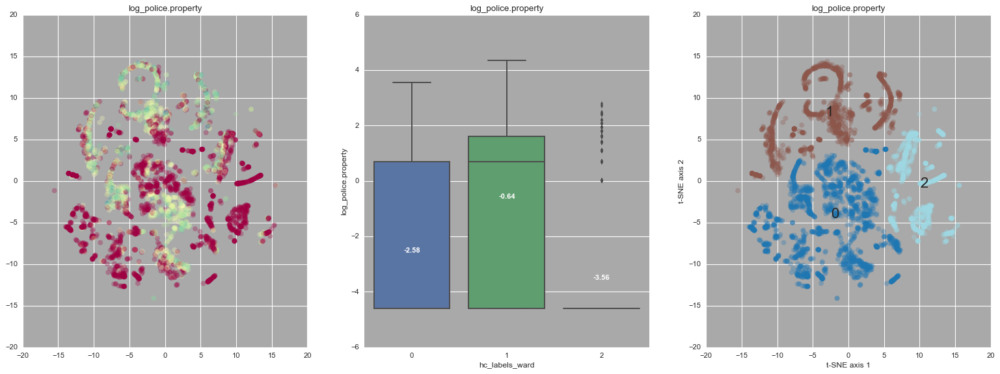

*************************  log_service.complaint


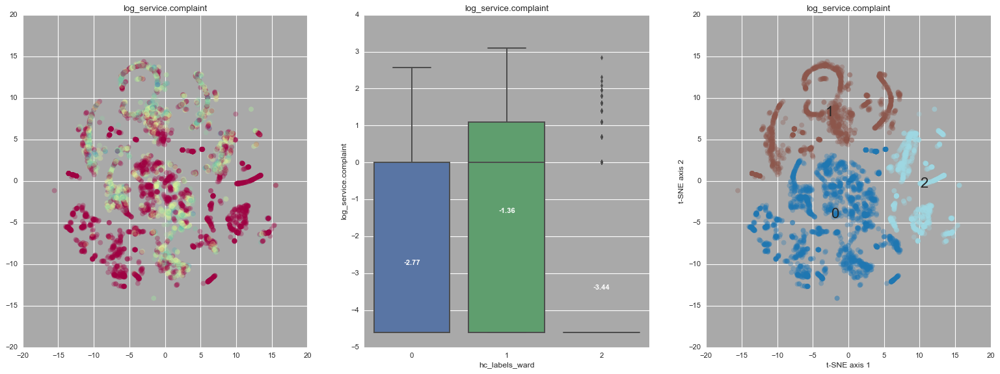

*************************  log_street_sidewalk


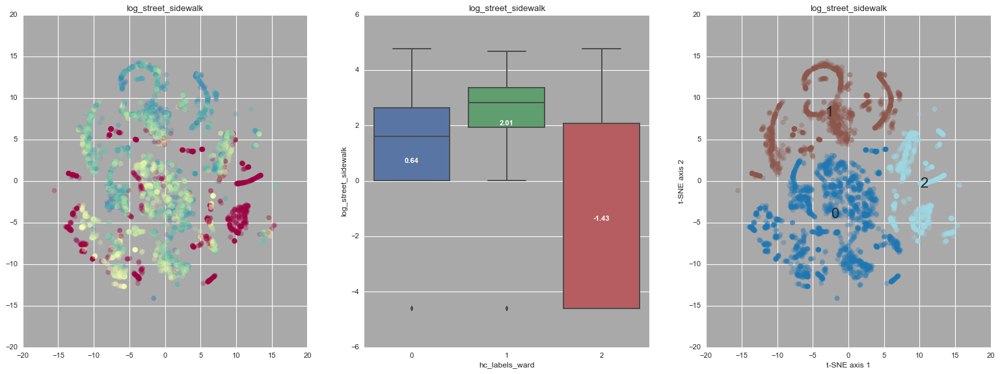

*************************  log_traffic_sig0l


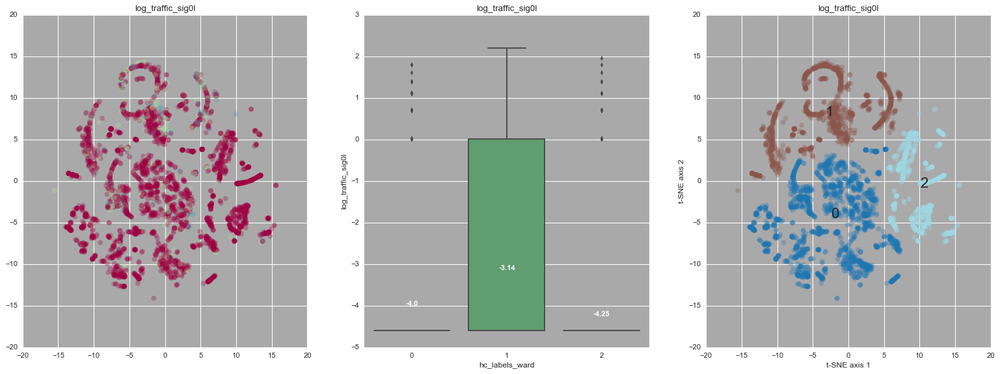

*************************  log_trash


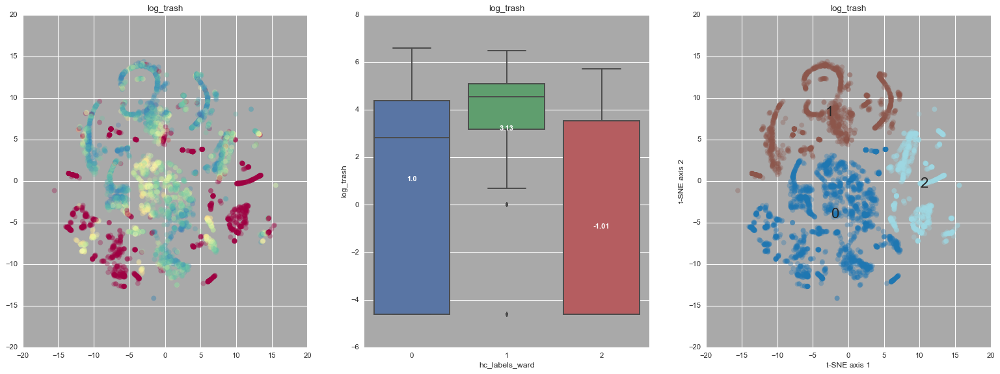

*************************  log_trees_plants


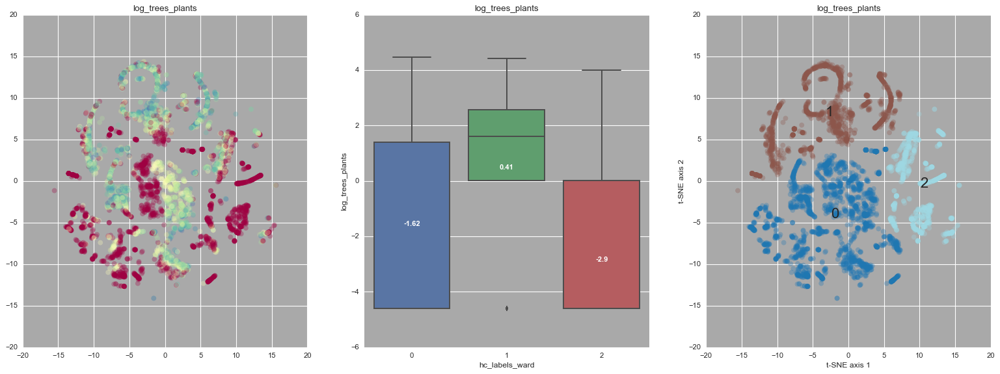

*************************  log_water.leak


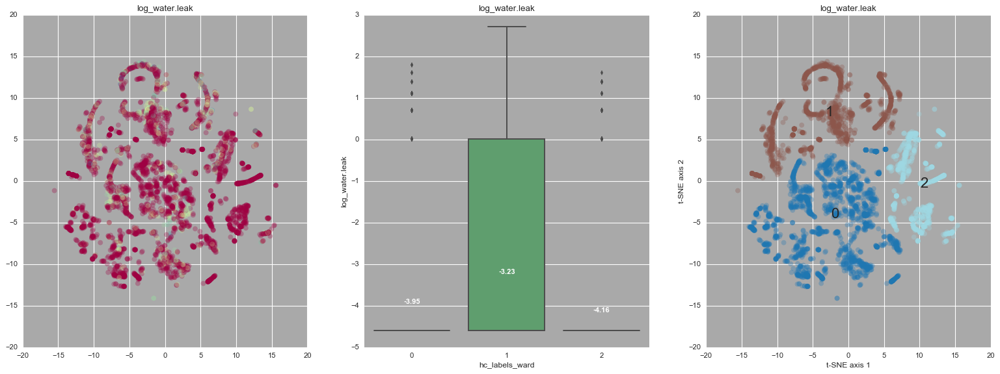

*************************  log_zoning_parking


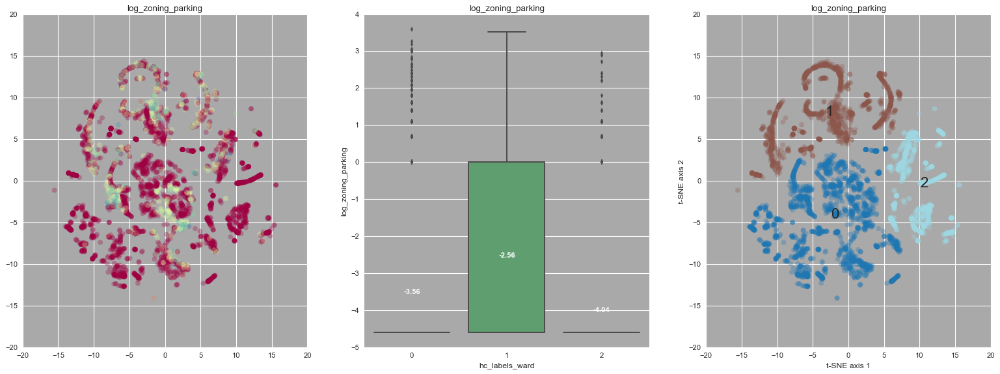

*************************  log_n_request


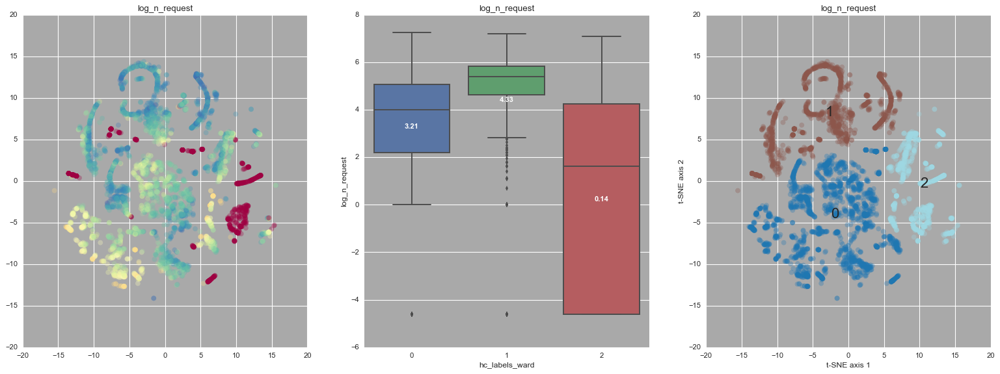

In [212]:


for col in col_names :

    print("************************* ",col)
    _ = plt.figure(figsize=(24, 8));

# ... feature distribution color map 

    _ = plt.subplot(131, facecolor = 'darkgrey');

    _ = plt.scatter(X_all_together['x-tsne'], X_all_together['y-tsne'],
                 c = X_all_together[col],
                 cmap = plt.cm.Spectral,
                 s = 50,
                 linewidths = 0,
                 alpha = 0.30)
    _ = plt.title(col)

# ... feature boxplots

    _ = plt.subplot(132, facecolor = 'darkgrey');
    ax = sns.boxplot(x = 'hierarchical', y = col, data = X_all_together);
    #sns.axlabel(xlabel="hc_labels_complete");
    _ = plt.xlabel(labels);
    _ = plt.title(col)

    average_values = X_all_together.groupby(['hierarchical'])[col].mean().values
    average_labels = [str(np.round(s, 2)) for s in average_values]

    pos = range(len(average_values))
    for tick, label in zip(pos, ax.get_xticklabels()):

        _ = ax.text(pos[tick], average_values[tick], average_labels[tick], 
                horizontalalignment = 'center', size = 'small', color = 'w', weight = 'semibold')

# ... cluster color map

    _ = plt.subplot(133, facecolor = 'darkgrey');

    _ = plt.scatter(X_all_together['x-tsne'], X_all_together['y-tsne'],
                 c = hc_labels_ward,
                 cmap = plt.cm.tab20,
                 s = 50,
                 linewidths = 0,
                 alpha = 0.30)
    for ii in range(n_lda) :                                       
           _ = plt.text(hc_labels_centers_x[ii], hc_labels_centers_y[ii], ii, fontsize = 20)

    _ = plt.xlabel('t-SNE axis 1')
    _ = plt.ylabel('t-SNE axis 2')
    _ = plt.title('t-SNE 2-D mapping')
    _ = plt.title(col)
    plt.savefig("C:/Users/Preeti/Github/CapstoneProject/unsupervised/plots/hierarchical/hierachical_ward_%s.png" %col)
    _ = plt.show();

In [202]:
from IPython.display import Image
from IPython.display import HTML
html_content=""

In [214]:
col_names

['min_walk_score',
 'max_walk_score',
 'mean_walk_score',
 'med_sale_pbo_n',
 'log_sum_cost_pedestrian_events',
 'log_num_near_misses',
 'log_n_rqst',
 'log_access',
 'log_dblprk',
 'log_dnotyld',
 'log_jywalk',
 'log_lvisib',
 'log_lwfws',
 'log_nobikef',
 'log_noswlk',
 'log_other',
 'log_prkint',
 'log_prkswlk',
 'log_speed',
 'log_vrrlss',
 'log_wlksig',
 'log_xwalk',
 'log_assist',
 'log_bikes',
 'log_drives',
 'log_other.1',
 'log_walks',
 'log_num_walk_scores',
 'log_sum_lane_cnt',
 'log_sum_width',
 'log_sum_area',
 'log_num_streets',
 'log_num_fire_incd',
 'log_med_sale_res_y',
 'log_med_sale_res_n',
 'log_med_sale_com_y',
 'log_med_sale_com_n',
 'log_med_sale_ind_y',
 'log_med_sale_ind_n',
 'log_med_sale_pbo_y',
 'log_sum_cost.y',
 'log_num_events.y',
 'log_dist',
 'log_n_object',
 'log_animals_insects',
 'log_building.related',
 'log_construction',
 'log_food',
 'log_others',
 'log_police.property',
 'log_service.complaint',
 'log_street_sidewalk',
 'log_traffic_sig0l',
 'lo

In [207]:

html_content = "<Table><tr><td>Kmeans</td><td>Hierarchical</td></tr>"
for col in col_names:

    plot_name = str(col)
    data_file_ext = ".png"

    kmeans_image_loc = "../unsupervised/plots/kmeans/"
    HC_image_loc = "../unsupervised/plots/hierarchical/"
    kmeans_plot_type = "Kmeans_comparison_by_"
    HC_plot_type = "hierachical_ward_"
    
    
    l_plt_file_2_save = kmeans_image_loc + kmeans_plot_type + plot_name + data_file_ext
    F_plt_file_2_save = HC_image_loc + HC_plot_type + plot_name + data_file_ext
   
    #print(l_plt_file_2_save)
    #Image(plt_file_2_save) 
    #Image(plt_file_2_save)
    
    #html_content = html_content + "<tr><td><img src="+ l_plt_file_2_save+"</td></tr>"
    html_content = html_content +  "<tr><td><font size = 3>"+ col+"</tr><tr><td><img src= '"+F_plt_file_2_save+"' </td><td><img src= '"+l_plt_file_2_save+"'</td></tr>"
    #print(html_content)

html_content = html_content + "</table>"
HTML(html_content)


Kmeans,Hierarchical
<img src= '../unsupervised/plots/hierarchical/hierachical_ward_min_walk_score.png',<img src= '../unsupervised/plots/kmeans/Kmeans_comparison_by_min_walk_score.png'
<img src= '../unsupervised/plots/hierarchical/hierachical_ward_max_walk_score.png',<img src= '../unsupervised/plots/kmeans/Kmeans_comparison_by_max_walk_score.png'
<img src= '../unsupervised/plots/hierarchical/hierachical_ward_mean_walk_score.png',<img src= '../unsupervised/plots/kmeans/Kmeans_comparison_by_mean_walk_score.png'
<img src= '../unsupervised/plots/hierarchical/hierachical_ward_med_sale_pbo_n.png',<img src= '../unsupervised/plots/kmeans/Kmeans_comparison_by_med_sale_pbo_n.png'
<img src= '../unsupervised/plots/hierarchical/hierachical_ward_log_sum_cost_pedestrian_events.png',<img src= '../unsupervised/plots/kmeans/Kmeans_comparison_by_log_sum_cost_pedestrian_events.png'
<img src= '../unsupervised/plots/hierarchical/hierachical_ward_log_num_near_misses.png',<img src= '../unsupervised/plots/kmeans/Kmeans_comparison_by_log_num_near_misses.png'
<img src= '../unsupervised/plots/hierarchical/hierachical_ward_log_n_rqst.png',<img src= '../unsupervised/plots/kmeans/Kmeans_comparison_by_log_n_rqst.png'
<img src= '../unsupervised/plots/hierarchical/hierachical_ward_log_access.png',<img src= '../unsupervised/plots/kmeans/Kmeans_comparison_by_log_access.png'
<img src= '../unsupervised/plots/hierarchical/hierachical_ward_log_dblprk.png',<img src= '../unsupervised/plots/kmeans/Kmeans_comparison_by_log_dblprk.png'
<img src= '../unsupervised/plots/hierarchical/hierachical_ward_log_dnotyld.png',<img src= '../unsupervised/plots/kmeans/Kmeans_comparison_by_log_dnotyld.png'


In [211]:
content = "<Table><tr><td>Kmeans</td><td>Hierarchical</td></tr>"
for col in col_names:

    plot_name = str(col)
    data_file_ext = ".png"

    kmeans_image_loc = "../unsupervised/plots/kmeans/"
    HC_image_loc = "../unsupervised/plots/hierarchical/"
    kmeans_plot_type = "Kmeans_comparison_by_"
    HC_plot_type = "hierachical_ward_"
    
    
    l_plt_file_2_save = kmeans_image_loc + kmeans_plot_type + plot_name + data_file_ext
    F_plt_file_2_save = HC_image_loc + HC_plot_type + plot_name + data_file_ext
   
    #print(l_plt_file_2_save)
    #Image(plt_file_2_save) 
    #Image(plt_file_2_save)
    
    #html_content = html_content + "<tr><td><img src="+ l_plt_file_2_save+"</td></tr>"
    content = content +  "<tr><td><font size = 3>"+ col+"</tr><tr><td><img src= '"+F_plt_file_2_save+"' </td><td><img src= '"+l_plt_file_2_save+"'</td></tr>"
    #print(html_content)

content = content + "</table>"
HTML(content)


Kmeans,Hierarchical
<img src= '../unsupervised/plots/hierarchical/hierachical_ward_min_walk_score.png',<img src= '../unsupervised/plots/kmeans/Kmeans_comparison_by_min_walk_score.png'
<img src= '../unsupervised/plots/hierarchical/hierachical_ward_max_walk_score.png',<img src= '../unsupervised/plots/kmeans/Kmeans_comparison_by_max_walk_score.png'
<img src= '../unsupervised/plots/hierarchical/hierachical_ward_mean_walk_score.png',<img src= '../unsupervised/plots/kmeans/Kmeans_comparison_by_mean_walk_score.png'
<img src= '../unsupervised/plots/hierarchical/hierachical_ward_med_sale_pbo_n.png',<img src= '../unsupervised/plots/kmeans/Kmeans_comparison_by_med_sale_pbo_n.png'
<img src= '../unsupervised/plots/hierarchical/hierachical_ward_log_sum_cost_pedestrian_events.png',<img src= '../unsupervised/plots/kmeans/Kmeans_comparison_by_log_sum_cost_pedestrian_events.png'
<img src= '../unsupervised/plots/hierarchical/hierachical_ward_log_num_near_misses.png',<img src= '../unsupervised/plots/kmeans/Kmeans_comparison_by_log_num_near_misses.png'
<img src= '../unsupervised/plots/hierarchical/hierachical_ward_log_n_rqst.png',<img src= '../unsupervised/plots/kmeans/Kmeans_comparison_by_log_n_rqst.png'
<img src= '../unsupervised/plots/hierarchical/hierachical_ward_log_access.png',<img src= '../unsupervised/plots/kmeans/Kmeans_comparison_by_log_access.png'
<img src= '../unsupervised/plots/hierarchical/hierachical_ward_log_dblprk.png',<img src= '../unsupervised/plots/kmeans/Kmeans_comparison_by_log_dblprk.png'
<img src= '../unsupervised/plots/hierarchical/hierachical_ward_log_dnotyld.png',<img src= '../unsupervised/plots/kmeans/Kmeans_comparison_by_log_dnotyld.png'


In [197]:
X_all_together

,x-tsne,y-tsne,cell_id,min_walk_score,max_walk_score,mean_walk_score,med_sale_pbo_n,log_sum_cost_pedestrian_events,log_num_near_misses,log_n_rqst,...,log_service.complaint,log_street_sidewalk,log_traffic_sig0l,log_trash,log_trees_plants,log_water.leak,log_zoning_parking,log_n_request,kmeans_labels,hierarchical
sample_index,,,,,,,,,,,,,,,,,,,,,
1,2.594388,-5.441451,20012,44,48,46.000000,0,-4.605170,-4.60517,-4.605170,...,0.009950,3.663818,0.009950,5.645482,1.611436,-4.605170,1.611436,6.059147,2,0
2,-4.255144,1.367073,20013,44,48,46.000000,0,-4.605170,-4.60517,-4.605170,...,0.009950,1.101940,-4.605170,3.178470,0.009950,-4.605170,-4.605170,3.367641,0,0
3,-4.305577,-11.240384,20015,44,48,46.000000,0,-1.158362,-4.60517,-4.605170,...,-4.605170,-4.605170,0.009950,-4.605170,-4.605170,-4.605170,-4.605170,1.101940,0,0
4,-8.112213,-9.972811,20016,44,48,46.000000,0,-4.605170,-4.60517,-4.605170,...,-4.605170,0.009950,-4.605170,-4.605170,-4.605170,-4.605170,-4.605170,1.101940,0,0
5,9.348014,3.819240,20019,13,13,13.000000,0,-4.605170,-4.60517,-4.605170,...,1.388791,0.009950,-4.605170,3.713816,0.009950,-4.605170,-4.605170,3.850360,2,2
6,6.885890,-8.316484,20020,44,48,46.000000,0,-4.605170,-4.60517,0.009950,...,-4.605170,1.611436,-4.605170,3.806885,-4.605170,-4.605170,0.009950,4.143293,2,0
7,-0.895608,-0.920208,20021,44,48,46.000000,0,-4.605170,-4.60517,-4.605170,...,0.698135,0.698135,-4.605170,4.382152,-4.605170,-4.605170,0.009950,4.625071,0,0
8,7.153776,-8.236163,20022,44,48,46.000000,0,-4.605170,-4.60517,-4.605170,...,0.009950,1.101940,-4.605170,4.304200,1.611436,-4.605170,-4.605170,4.510969,2,0
9,5.894754,1.703255,30012,3,36,24.333333,0,-0.481267,-4.60517,0.009950,...,0.009950,2.773214,-4.605170,5.283254,0.698135,-4.605170,-4.605170,5.613165,2,2


In [198]:
X_all_together.columns

Index(['x-tsne', 'y-tsne', 'cell_id', 'min_walk_score', 'max_walk_score',
       'mean_walk_score', 'med_sale_pbo_n', 'log_sum_cost_pedestrian_events',
       'log_num_near_misses', 'log_n_rqst', 'log_access', 'log_dblprk',
       'log_dnotyld', 'log_jywalk', 'log_lvisib', 'log_lwfws', 'log_nobikef',
       'log_noswlk', 'log_other', 'log_prkint', 'log_prkswlk', 'log_speed',
       'log_vrrlss', 'log_wlksig', 'log_xwalk', 'log_assist', 'log_bikes',
       'log_drives', 'log_other.1', 'log_walks', 'log_num_walk_scores',
       'log_sum_lane_cnt', 'log_sum_width', 'log_sum_area', 'log_num_streets',
       'log_num_fire_incd', 'log_med_sale_res_y', 'log_med_sale_res_n',
       'log_med_sale_com_y', 'log_med_sale_com_n', 'log_med_sale_ind_y',
       'log_med_sale_ind_n', 'log_med_sale_pbo_y', 'log_sum_cost.y',
       'log_num_events.y', 'log_dist', 'log_n_object', 'log_animals_insects',
       'log_building.related', 'log_construction', 'log_food', 'log_others',
       'log_police.property

In [199]:
X_all_together.to_csv('../data/unsupervised_df_model_with_labels.csv',index=True)

In [232]:
col = ['log_access',
'log_dblprk',
'log_dnotyld',
'log_jywalk',
'log_lvisib',
'log_lwfws',
'log_nobikef',
'log_noswlk',
'log_other',
'log_prkint',
'log_prkswlk',
'log_speed',
'log_vrrlss',
'log_wlksig',
'log_xwalk',
'log_assist',
'log_bikes',
'log_drives',
'log_other.1',
'log_walks']

kmeans_weight_tbl[kmeans_weight_tbl.'Column Name'.isin(col)]

SyntaxError: invalid syntax (<ipython-input-232-19c3821d3d79>, line 22)

In [230]:
kmeans_weight_tbl

,Cluster #0,Cluster #1,Cluster #2,Column Name,cluster 0,cluster 1,cluster 2,index
36,13.115350,18.885831,67.998819,log_med_sale_com_n,-0.815293,-1.174005,-4.227028,1.0
54,59.474303,-6.189304,46.715001,log_trees_plants,-2.169104,0.225732,-1.703756,1.0
44,37.254928,17.817191,44.927880,log_animals_insects,-2.732766,-1.306947,-3.295601,1.0
49,42.314728,13.153102,44.532170,log_police.property,-2.713640,-0.843507,-2.855844,1.0
27,41.832758,16.607549,41.559693,log_num_walk_scores,-3.321857,-1.318773,-3.300174,1.0
4,34.516998,26.417233,39.065769,log_sum_cost_pedestrian_events,-3.651643,-2.794748,-4.132869,1.0
50,40.232134,20.711297,39.056569,log_service.complaint,-2.947478,-1.517346,-2.861354,1.0
6,35.171367,28.166040,36.662593,log_n_rqst,-4.049793,-3.243168,-4.221500,1.0
47,34.173862,29.201541,36.624597,log_food,-4.051057,-3.461626,-4.341574,1.0
56,36.810459,26.874108,36.315433,log_zoning_parking,-3.676005,-2.683730,-3.626570,1.0
